## library package

In [1]:
# BiocManager::install('')
install.packages("languageserver")
# devtools::install_github("GreenleafLab/chromVARmotifs")

In [21]:
library(MAESTRO)
library(chromVAR)
# library(chromVARmotifs)
library(Seurat)
library(Matrix)
library(BSgenome.Hsapiens.UCSC.hg19)
library(BSgenome.Hsapiens.UCSC.hg38)
library(BiocParallel)
library(motifmatchr)
library(SummarizedExperiment)
# library(rhdf5)
library(dplyr)
library(motifmatchr)
library(chromVARmotifs)
# library(JASPAR2016)
library(ggplot2)
# library(spam)
# library(VennDiagram)
library(stringr)
library(ggrepel)
# library(ggsignif)
library(qs)
# register(MulticoreParam(8))

In [7]:
devtools::install_github("GreenleafLab/chromVARmotifs", force=TRUE)

Rcpp         (1.0.5    -> 1.0.6   ) [CRAN]
formatR      (1.7      -> 1.8     ) [CRAN]
matrixStats  (0.57.0   -> 0.58.0  ) [CRAN]
DelayedArray (0.16.0   -> 0.16.3  ) [CRAN]
MatrixGen... (1.2.0    -> 1.2.1   ) [CRAN]
BH           (1.72.0-3 -> 1.75.0-0) [CRAN]
crayon       (1.3.4    -> 1.4.1   ) [CRAN]
RCurl        (1.98-1.2 -> 1.98-1.3) [CRAN]
GenomeInfoDb (1.26.2   -> 1.26.4  ) [CRAN]
XML          (3.99-0.5 -> 3.99-0.6) [CRAN]
fastmap      (1.0.1    -> 1.1.0   ) [CRAN]
vctrs        (0.3.5    -> 0.3.7   ) [CRAN]
rlang        (0.4.9    -> 0.4.10  ) [CRAN]
memoise      (1.1.0    -> 2.0.0   ) [CRAN]
DBI          (1.1.0    -> 1.1.1   ) [CRAN]
utf8         (1.1.4    -> 1.2.1   ) [CRAN]
pillar       (1.4.7    -> 1.5.1   ) [CRAN]
fansi        (0.4.1    -> 0.4.2   ) [CRAN]
farver       (2.0.3    -> 2.1.0   ) [CRAN]
mime         (0.9      -> 0.10    ) [CRAN]
cpp11        (0.2.4    -> 0.2.7   ) [CRAN]
lifecycle    (0.2.0    -> 1.0.0   ) [CRAN]
hms          (0.5.3    -> 1.0.0   ) [CRAN]
cli        

Installing 31 packages: Rcpp, formatR, matrixStats, DelayedArray, MatrixGenerics, BH, crayon, RCurl, GenomeInfoDb, XML, fastmap, vctrs, rlang, memoise, DBI, utf8, pillar, fansi, farver, mime, cpp11, lifecycle, hms, cli, pracma, withr, tibble, isoband, ggplot2, RSQLite, caTools



ERROR: Error: Failed to install 'chromVARmotifs' from GitHub:
  (由警告转换成)unable to access index for repository https://bioconductor.org/packages/3.12/data/experiment/src/contrib:
  无法打开URL'https://bioconductor.org/packages/3.12/data/experiment/src/contrib/PACKAGES'


In [5]:
data(human_pwms_v2)

Warning message in data(human_pwms_v2):
"data set 'human_pwms_v2' not found"


---------
## function define

In [23]:
## this block is the function that used to perform chromVAR data analysis


# as_matrix <- function(mat){
#   tmp <- matrix(data=0L, nrow = mat@Dim[1], ncol = mat@Dim[2])
#   row_pos <- mat@i+1
#   col_pos <- findInterval(seq(mat@x)-1,mat@p[-1])+1
#   val <- mat@x
#   for (i in seq_along(val)){
#       tmp[row_pos[i],col_pos[i]] <- val[i]
#   }
#   row.names(tmp) <- mat@Dimnames[[1]]
#   colnames(tmp) <- mat@Dimnames[[2]]
#   return(tmp)
# }


RunchromVAR <- function(inputMat, min.c = 50, min.p = 500, organism = "GRCh38")
{
  message("Reading File!")
#   spam_input_matrix <- as.spam.dgCMatrix(inputMat)
  peaks <- data.frame(chr=unlist(strsplit(rownames(inputMat),'_'))[seq(1,nrow(inputMat)*3,3)], 
                 start=unlist(strsplit(rownames(inputMat),'_'))[seq(2,nrow(inputMat)*3,3)],
                 end=unlist(strsplit(rownames(inputMat),'_'))[seq(3,nrow(inputMat)*3,3)])  
  rownames(peaks) <- paste0(peaks[,1],'_',peaks[,2],'_',peaks[,3])
  peaks <- na.omit(peaks)
  message("Generating col.data!")
#   col.Data <- DataFrame(celltype=colnames(inputMat), depth=apply.spam(spam_input_matrix,2,sum))
  col.Data <- DataFrame(celltype=colnames(inputMat), depth=Matrix::colSums(inputMat))
  col.Data <- col.Data[which(col.Data[,2]>min.p),]
  message("Generating row.data!")
#   row.Data <- DataFrame(peaks=rownames(inputMat), depth=apply.spam(spam_input_matrix[,col.Data[,1]],1,sum))
  row.Data <- DataFrame(peaks=rownames(inputMat), depth=Matrix::rowSums(inputMat[,col.Data[,1]]))
  row.Data <- row.Data[which(row.Data[,2]>min.c),]
#   finalPeak <- as.matrix(peaks[row.Data[,1],])
#   finalCount <- as.matrix(inputMat[row.Data[,1],col.Data[,1]])
  finalPeak <- peaks[row.Data[,1],]
  finalCount <- inputMat[row.Data[,1],col.Data[,1]]
  rowRanges <- GRanges(as.character(finalPeak[,1]),IRanges(as.integer(finalPeak[,2]),as.integer(finalPeak[,3])),
                       strand="*",score=as.integer(5),qval=1,name=rownames(finalPeak))
  resizedRowRanges <- resize(rowRanges, width=500, fix="center")
  chromVAR_counts  = SummarizedExperiment(assays=SimpleList(counts=finalCount),rowRanges=resizedRowRanges, colData=col.Data)
  

  message("chromVAR analysis ...")
  if(organism == "GRCh38") {
     chromVAR_counts = addGCBias(chromVAR_counts, genome = BSgenome.Hsapiens.UCSC.hg38)
#      motifs <- getJasparMotifs(species = "Homo sapiens")
#      motif_ix = matchMotifs(motifs, chromVAR_counts, genome = BSgenome.Hsapiens.UCSC.hg38)
     data(human_pwms_v2)
     motif_ix = matchMotifs(human_pwms_v2, chromVAR_counts, genome = BSgenome.Hsapiens.UCSC.hg38)}
  if(organism == "GRCm38") {
     chromVAR_counts = addGCBias(chromVAR_counts, genome = BSgenome.Mmusculus.UCSC.mm10)
#      motifs <- getJasparMotifs(species="Mus musculus")
#      motif_ix = matchMotifs(motifs, chromVAR_counts, genome = BSgenome.Mmusculus.UCSC.mm10)
     data(mouse_pwms_v2)
     motif_ix = matchMotifs(mouse_pwms_v2, chromVAR_counts, genome = BSgenome.Mmusculus.UCSC.mm10)}  
  dev = computeDeviations(object = chromVAR_counts, annotations = motif_ix)
  variability = computeVariability(dev)
  zscore = assays(dev)$z
  rownames(zscore) = variability[,1]
#   variability <- computeVariability(dev)
  
  message("Finished!")
  return(list(dev = dev, zscore = zscore, variability = variability))
}


mergeChromVarResult <- function(Seurat_object, chromVAR_z_frame){
    # zframe : each row is a cell, each column is a TF/Gene
#     chromVarResult = readRDS(SeuratObject)
    p1 <- DimPlot(object = Seurat_object$ATAC, pt.size = 0.5)
    show(p1)
    Seurat_object$zscore <- chromVAR_z_frame
    Seurat_object$ATAC@meta.data <- cbind(Seurat_object$ATAC@meta.data, chromVAR_z_frame[match(rownames(Seurat_object$ATAC@meta.data), rownames(chromVAR_z_frame)),])
#     SeuratObject$ATAC@meta.data <- merge(SeuratObject$ATAC@meta.data, chromVARzframe, by="row.names", all = TRUE)
#     rownames(Seurat_object$ATAC@meta.data) <- Seurat_object$ATAC@meta.data[,1]
    for (i in colnames(chromVAR_z_frame)) {
        Seurat_object$ATAC@meta.data[i][is.na(Seurat_object$ATAC@meta.data[i])] <- min(Seurat_object$ATAC@meta.data[i], na.rm=T)
    }
    return(Seurat_object)
}


mergeGiggleResult <- function(Seurat_object, giggle){
    # giggle frame : each row is a cell, each column is a TF/Gene
#     result = readRDS(Seurat_object)

    p1 <- DimPlot(object = Seurat_object$ATAC, pt.size = 0.5)
    show(p1)
    Seurat_object$giggle <- giggle
    Seurat_object$ATAC@meta.data <- cbind(Seurat_object$ATAC@meta.data, 
                                         giggle[match(rownames(Seurat_object$ATAC@meta.data), rownames(giggle)),])
#     Seurat_object$ATAC@meta.data <- merge(Seurat_object$ATAC@meta.data, giggle, by="row.names", all = TRUE)
#     rownames(Seurat_object$ATAC@meta.data) <- Seurat_object$ATAC@meta.data[,1]
#     for (i in colnames(giggle)) {
#         Seurat_object$ATAC@meta.data[i][is.na(Seurat_object$ATAC@meta.data[i])] <- max(Seurat_object$ATAC@meta.data[i], na.rm=T)
#     }
    return(Seurat_object)
}

generateBackgroundBed <- function(input_mat, bg_bed_path, maplist_store_path, step, iteration){
    library("qs")
    map_list <- list()
    # inputmat colnames is peak, eg: "ChrX_XXX_XXX"
    # step = 100
    # key <- "0-1"
    path <- bg_bed_path
    for (i in seq(1,iteration)) {
        cl_name <- colnames(input_mat)
        map_list[[i]] <- cl_name[sample(1:length(cl_name), step)]
        peak_sub <- input_mat[,map_list[[i]]]
        peak_sub_matrix <- as.matrix(peak_sub[which(rowSums(peak_sub) > 5),])
        peaks <- rownames(peak_sub_matrix)
        peaks <- data.frame(chr=unlist(strsplit(peaks,'_'))[seq(1,length(peaks)*3,3)], 
                        start=as.numeric(unlist(strsplit(peaks,'_'))[seq(2,length(peaks)*3,3)]),
                        end=as.numeric(unlist(strsplit(peaks,'_'))[seq(3,length(peaks)*3,3)]))  
        write.table(peaks, paste0(path, "/", as.character(i), ".bed") ,sep="\t",quote = F, row.names = F, col.names = F)
    }
    qsave(map_list, maplist_store_path)  
    return(map_list)
}


generateClusterBed <- function(SeuratObject, input_mat, bed_path, maplist_store_path, step){
    metadata <- SeuratObject$ATAC@meta.data
    map_list <- list()
    # step = 50
    # key <- "0-1"
    path <- bed_path
    for (i in unique(metadata$seurat_clusters)){
        cluster_cell_name <- rownames(metadata)[metadata$seurat_clusters==i]
        start = seq(1, length(cluster_cell_name), step)
        j = 1
        for (s in start){
            cl_name <- cluster_cell_name[s:(s + step -1)]
            key = paste0(as.character(i), "_", as.character(j))
            # message(key)
            map_list[[key]] <- na.omit(cl_name)
            if (length(na.omit(cl_name)) < 20) {
                message(paste(key, "only have", length(na.omit(cl_name)), "cells, skip generate bed file."))
                next
            } else {
                peak_sub <- input_mat[,map_list[[key]]]
                peak_sub_matrix <- as.matrix(peak_sub[which(rowSums(peak_sub) > 5),])
                peaks <- rownames(peak_sub_matrix)
                peaks <- data.frame(chr=unlist(strsplit(peaks,'_'))[seq(1,length(peaks)*3,3)], 
                                start=as.numeric(unlist(strsplit(peaks,'_'))[seq(2,length(peaks)*3,3)]),
                                end=as.numeric(unlist(strsplit(peaks,'_'))[seq(3,length(peaks)*3,3)]))  
                write.table(peaks, paste0(path, key, ".bed") ,sep="\t",quote = F, row.names = F, col.names = F)
                j <- j+1
            }
        }
    }
    
    qsave(map_list, maplist_store_path)
    return(map_list)
}


------------
------------
------------
# 10X example data running

data can be download [here](https://support.10xgenomics.com/single-cell-atac/datasets/1.2.0/atac_pbmc_10k_v1?)

https://support.10xgenomics.com/single-cell-atac/datasets/1.2.0/atac_pbmc_10k_v1? 

In [ ]:
# pbmc_10X_inputMat <- Read10X_h5('10X_ATAC/analysis/atac_pbmc_10k_v1_S1_L001/Result/Analysis/atac_pbmc_10k_v1_S1_L001_peak_count.h5')

In [39]:
pbmc_10X_inputMat <- Read10X_h5('example/PBMC/data/PBMC_granulocyte_sorted_10k_peak_count.h5')

In [44]:
dim(pbmc10x_chromVAR$zscore)

[1]   870 11607

### chromVAR running

In [41]:
pbmc10x_chromVAR <- RunchromVAR(pbmc_10X_inputMat)

Reading File!

Generating col.data!

Generating row.data!

chromVAR analysis ...

Finished!



In [15]:
# pbmc10x_chromVAR would have 3 keys: dev,variability,zscore
plotVariability(pbmc10x_chromVAR$variability, use_plotly = T) 

HTML widgets cannot be represented in plain text (need html)

In [16]:
qsave(pbmc10x_chromVAR, "example/PBMC/run_chromVAR_result.qs")

In [27]:
write.table(pbmc10x_chromVAR$zscore, 'example/PBMC/chromVAR_ztable.txt', sep='\t', quote=FALSE)

In [50]:
pbmc10x_chromVAR <- qread("10X_ATAC/per_50_cell_peak/1k_TF_index/run_chromVAR_result.qs")

In [17]:
TFlist <- head(pbmc10x_chromVAR$variability[order(pbmc10x_chromVAR$variability['variability'], decreasing=T),],5)$name
z_frame <- t(pbmc10x_chromVAR$zscore)

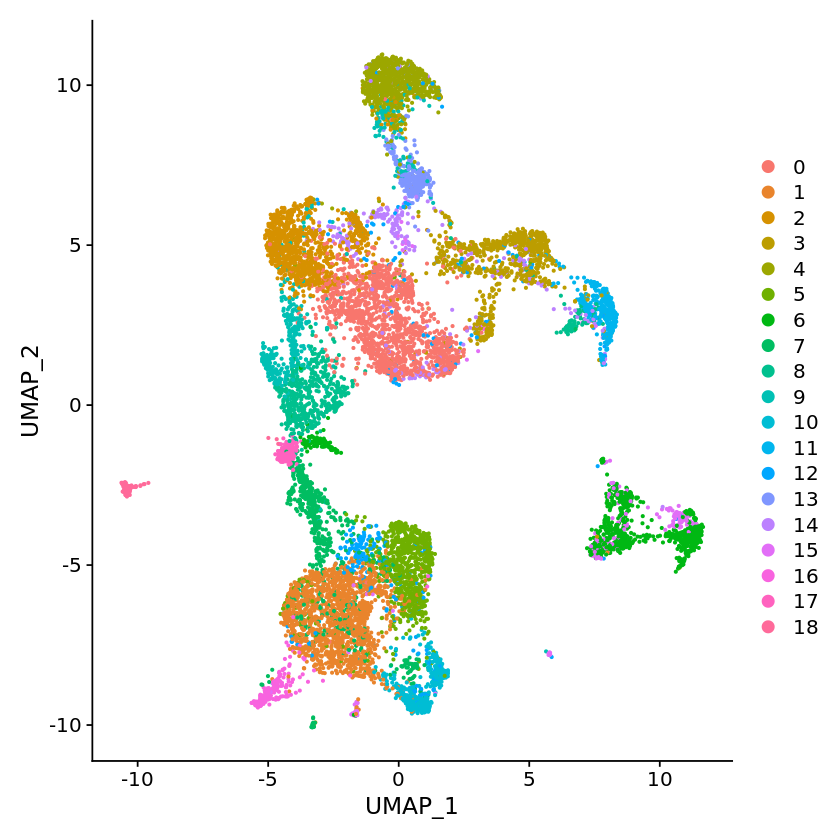

In [18]:
seurat_rds <- readRDS('example//PBMC//data//PBMC_granulocyte_sorted_10k_scATAC_Object.rds')
chromVarResult <- mergeChromVarResult(seurat_rds, z_frame)

In [ ]:
qsave(chromVarResult, "example/PBMC/chromVAR_result_seurat_object.qs")

In [38]:
chromVarResult$ATAC@meta.data

,orig.ident,nCount_ATAC,nFeature_ATAC,ATAC_snn_res.0.6,seurat_clusters,nCount_ACTIVITY,nFeature_ACTIVITY,assign.ident,assign.score,assign.celltype,⋯,PBX4,NKX62,HOXA4,CR8477943,RORB,SMAD5,SMAD9,SOX6,TBX18,TBX22
,<fct>,<dbl>,<int>,<fct>,<fct>,<dbl>,<int>,<chr>,<dbl>,<chr>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AAACAAGCACCACAAA,PBMC_granulocyte_sorted_10k,3509,3509,9,9,3308.0661,7468,CD4Tconv,0.11906230,CD4Tconv,⋯,0.842919348,-0.30586251,0.97141230,0.42713665,-1.04470080,-0.91760063,-0.34204947,-0.33652663,1.1511961,1.1511961
AAACAAGCAGCCAGTG,PBMC_granulocyte_sorted_10k,534,534,7,7,445.7165,1491,Mono/Macro,0.48578120,Mono/Macro,⋯,-0.720389575,-0.66925560,0.84880590,1.07276701,-1.28648607,-0.82898215,0.43861264,-0.56332409,-0.2767183,-0.2767183
AAACAAGCAGGACCTG,PBMC_granulocyte_sorted_10k,5766,5766,2,2,4993.9406,10445,CD4Tconv,0.45481341,CD4Tconv,⋯,1.297821308,0.71501557,-0.54880884,-1.73462426,0.30009663,0.83153600,0.48091261,0.06920023,-0.2682395,-0.2682395
AAACAAGCATTGACTC,PBMC_granulocyte_sorted_10k,4610,4610,11,11,4232.3107,8967,NK,2.08672973,NK,⋯,0.060741462,1.45402212,1.21228923,-1.75493173,-0.93945518,-0.04761203,-0.01052928,-0.10210910,1.5628849,1.5628849
AAACAAGCATTGTTTG,PBMC_granulocyte_sorted_10k,8154,8154,14,14,7021.4240,13015,CD4Tconv,0.55899714,CD4Tconv,⋯,0.286168304,-0.03976795,-0.74260357,1.29515353,1.02699812,-0.27335948,-2.54034731,-0.00868955,0.5806154,0.5806154
AAACCAGGTAAGGCCG,PBMC_granulocyte_sorted_10k,7002,7002,5,5,5334.1247,12773,Mono/Macro,2.25785909,Mono/Macro,⋯,-1.149770784,-0.52848192,-0.06993349,-0.33081090,-1.23844822,0.71950743,1.00522825,1.14812887,-1.0877848,-1.0877848
AAACCAGGTCCCAGAC,PBMC_granulocyte_sorted_10k,4559,4559,9,9,4046.3624,9035,CD4Tconv,0.11906230,CD4Tconv,⋯,0.223508737,0.01478860,0.46817243,0.40097783,-0.70157331,1.77037057,-0.47529992,0.67111396,0.1521772,0.1521772
AAACCAGGTCCTGCAA,PBMC_granulocyte_sorted_10k,7923,7923,13,13,6838.1803,12914,CD8T,1.19740699,CD8T,⋯,2.082029369,-0.98492056,-1.48245516,-1.45578910,-0.54042391,0.68814351,0.21002763,0.07290530,0.9649609,0.9649609
AAACCAGGTGAACCGG,PBMC_granulocyte_sorted_10k,6210,6210,0,0,5504.6716,10880,Treg,0.44348375,Treg,⋯,-1.519905932,0.03196099,0.69027712,-0.21374093,0.47840291,0.53317268,-2.10315411,1.52376144,0.7762597,0.7762597


In [30]:
rna<-readRDS('example//PBMC//data//PBMC_granulocyte_sorted_10k_scRNA_Object.rds')

In [47]:
write.table(as.matrix(rna$RNA@assays$RNA@data), 'example/PBMC/expression.txt', sep='\t', quote=FALSE)

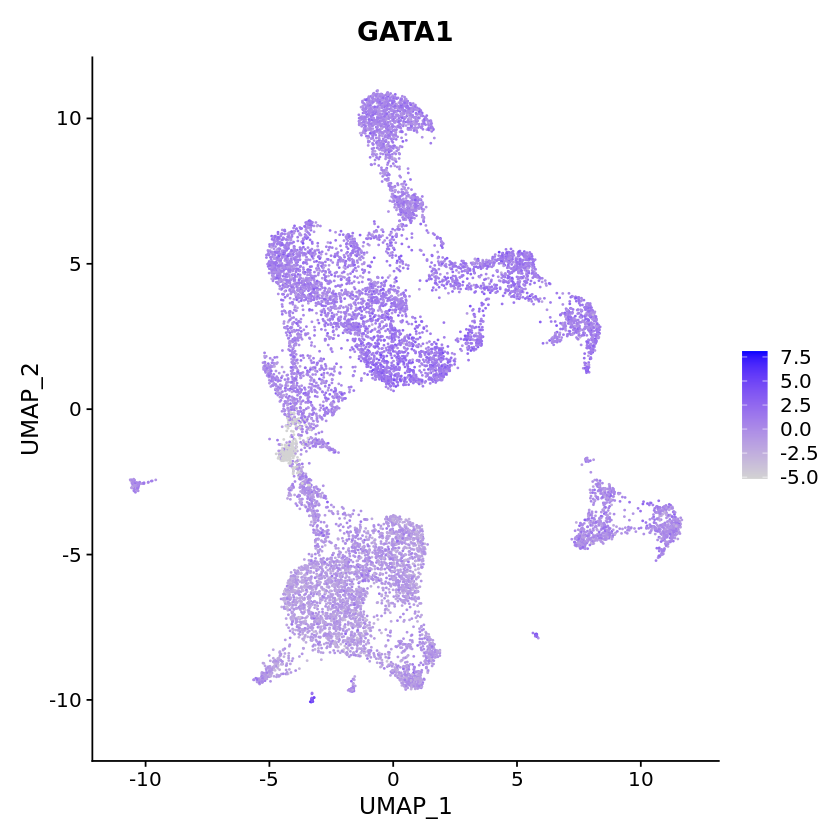

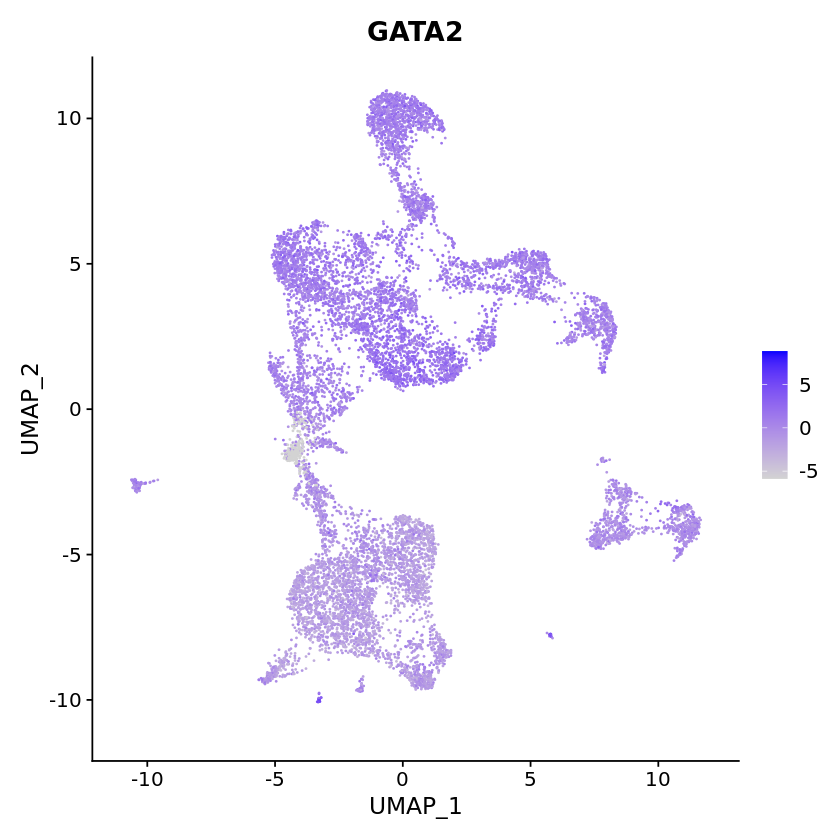

In [20]:
for (i in c('GATA1','GATA2')) {
    fig <- FeaturePlot(object = chromVarResult$ATAC, feature=i)
    show(fig)
}

In [ ]:
# tmp.path <- "10X_ATAC/chromVAR_result_more_motif.rds"
# tmp <- readRDS(tmp.path)
# qsave(tmp, str_replace(tmp.path, ".rds", ".qs"))

In [ ]:
qsave(chromVarResult, "10X_ATAC/chromVAR_result_more_motif.qs")

In [74]:
chromVarResult <- qread("10X_ATAC/chromVAR_result_more_motif.qs")

### generate cell cluster peak

In [ ]:
Seurat_result <- readRDS(seurat_rds_file)

In [ ]:
metadata <- result$ATAC@meta.data

In [ ]:
bg_map_list <- generateBackgroundBed(pbmc_10X_inputMat, "10X_ATAC/per_50_cell_peak/bg_bed/", 
                      "10X_ATAC/per_100_cell_peak/bg_bed/map_list.qs", 50, 1000)

In [ ]:
maplist <- generateClusterBed(Seurat_result, pbmc_10X_inputMat, 
                              "10X_ATAC/per_50_cell_peak/bed/", "10X_ATAC/per_50_cell_peak/map_list.qs", 50)

### write cell level peak (per cell)

In [ ]:
inputMat <- pbmc_10X_inputMat

In [ ]:
inputMat

In [ ]:
inputMat <- pbmc_10X_inputMat
# prepare bed peak file
message(length(colnames(inputMat)))
for(i in 1:length(colnames(inputMat))){
    cellName <- colnames(inputMat)[i]
    peak <- rownames(inputMat[which(inputMat[,i]!=0),])
#     peak <- t(data.frame(strsplit(peak,"_")))
#     message(paste(i,nrow(peak)))
#     write.table(peak, paste0('10X_ATAC/per_cell_peak/', cellName, "_peak.bed"), row.names = F, sep = "\t", col.names = F, quote = F)
    
}
# peak <- rownames(inputMat[which(inputMat[,i]!=0),])
# peak <- t(data.frame(strsplit(peak,"_")))
# write.table(peak, paste0('10X_ATAC/per_cell_peak/'cellName, "_peak.bed"), row.names = F, sep = "\t", col.names = F, quote = F)

### p value intergrate

p value was calculation by another jupyter which codes in python 

In [46]:
giggle_table_file <- '10X_ATAC/per_50_cell_peak/motif_index/result_p.txt'
map_list <- readRDS("10X_ATAC/per_50_cell_peak/map_list.rds")
qs_file <- '10X_ATAC/per_50_cell_peak/motif_index/pvalue.qs'

In [151]:
giggle <- read.table('10X_ATAC/beds/per50/neighbor.p.forR.txt', sep="\t", header = T, row.names="Factor")

In [158]:
giggle

,AATF,ADNP,AEBP2,AFF1,AFF4,AGO1,AGO2,AHR,AHRR,ALKBH3,⋯,ZSCAN22,ZSCAN23,ZSCAN29,ZSCAN31,ZSCAN5A,ZSCAN5B,ZTA,ZXDB,ZXDC,ZZZ3
ACAGGCCAGGTTTCTG,-0.39277926,-0.40698378,-0.4074363,0.3277969,-0.40743668,-0.401115302,-0.38564505,-0.40743669,-0.28201230,-0.4074367,⋯,-0.40743669,-0.40743669,-0.40743530,-0.4074366,-0.40570599,-0.40524468,-0.37503547,-0.4074367,-0.4074367,-0.40743657
AAACGAAAGACACGGT,-0.44691793,0.16087543,-0.3038911,0.6356241,0.04586575,-0.528199454,-0.15863858,-0.77159676,-0.81767374,-0.8083874,⋯,0.02487905,-0.46213249,0.12962021,-0.6416912,0.40189180,-0.18900572,-0.88160535,-0.1828385,-0.8875449,-0.77803723
ACAAACCTCCGGCTGA,-0.53011441,-0.31218311,-0.5609393,-0.1721749,-0.56071395,-0.560939303,-0.26565059,0.01090118,-0.56093909,-0.5609340,⋯,-0.56093930,-0.56093930,-0.54407542,-0.5608598,-0.52496002,-0.53920622,2.21530826,-0.5609393,-0.5609393,-0.56091768
AACGTACGTCGCTACG,-0.66362903,-0.86807034,-0.4199932,0.7158393,1.33705822,0.009763783,-0.59664839,-0.89792316,-0.18777831,-0.8557346,⋯,1.60402586,0.03264155,-0.57090778,-0.7705125,0.03953825,-0.87645587,-0.87878445,0.4083967,-0.4630466,-0.79965337
AAGGTTCCAATGGCTT,-0.18186642,0.71016664,-0.6563793,0.1727920,0.94961928,-0.731528657,0.25546534,-0.22209112,-0.73061012,0.7923101,⋯,-0.73154051,-0.73154036,0.03530479,-0.6611560,-0.30255382,0.57089137,1.51140957,-0.7315394,-0.7315401,0.02588966
ACCGAATCAAGGTCGA,-0.05538263,0.07218345,-0.8492034,1.0446304,2.16472138,-0.853065410,-0.65083323,-0.50873429,-0.85321038,0.3661151,⋯,-0.85328823,-0.85328869,0.51818273,-0.6892202,0.51485675,1.77152157,-0.23305046,-0.8529093,-0.8532889,-0.26767181
AGACAAACAAATTCCG,-0.33583695,-0.48813874,-0.5081935,-0.4923169,-0.50835893,-0.508359661,-0.40883051,0.02372974,-0.50835892,-0.5064658,⋯,-0.50835966,-0.50835966,-0.50808151,-0.5080691,-0.50729265,-0.50446542,2.57057690,-0.5083597,-0.5083593,-0.49668330
ACGTGGCCAGGTAACG,-0.49618147,-0.16700843,-0.5223183,-0.4653644,-0.52123924,-0.522318315,-0.49497727,-0.09711789,-0.52231830,-0.5221606,⋯,-0.52231832,-0.52231832,-0.48585704,-0.5222933,-0.51004521,-0.52153712,2.29980509,-0.5223183,-0.5223183,-0.52174051
AACCAACGTGATGTGG,-0.46657140,-0.45469703,-0.4913264,-0.4379942,-0.49374614,-0.493741911,-0.46949091,-0.22134515,-0.42400070,-0.4937347,⋯,-0.49375038,-0.49375038,-0.48977589,-0.4937471,-0.49374177,-0.49033107,1.20816207,-0.4937504,-0.4732080,-0.49374610
AGCCTCTCATAGATAG,-0.18389519,1.05817864,-0.7308975,-0.0679074,0.62509756,-0.785475350,0.28052563,-0.23542253,-0.78077656,0.1519359,⋯,-0.78648300,-0.78646481,0.73010513,-0.4557380,0.28436839,1.29506456,-0.10901809,-0.7864434,-0.7864872,-0.42157308


In [44]:
giggle = t(giggle)

In [48]:
bc_start_site <- dim(giggle)[2] + 1 
for (i in names(map_list)){
    if (length(map_list[i][[1]]) < 20){
        next
    } else {
        for (j in seq(1,length(map_list[i][[1]]))){
            giggle[,map_list[i][[1]][j]] <- giggle[,paste0('X', i)]
        }
    }    
}
giggle <- t(giggle[,bc_start_site:dim(giggle)[2]])

In [21]:
giggle <- apply(giggle, 2, p.adjust, "fdr")

In [46]:
giggle <- -log10(giggle+0.000001)

In [50]:
colnames(giggle) <- paste0("M_" ,colnames(giggle))

In [169]:
giggle

,AATF,ADNP,AEBP2,AFF1,AFF4,AGO1,AGO2,AHR,AHRR,ALKBH3,⋯,ZSCAN22,ZSCAN23,ZSCAN29,ZSCAN31,ZSCAN5A,ZSCAN5B,ZTA,ZXDB,ZXDC,ZZZ3
ACAGGCCAGGTTTCTG,-0.39277926,-0.40698378,-0.4074363,0.3277969,-0.40743668,-0.401115302,-0.38564505,-0.40743669,-0.28201230,-0.4074367,⋯,-0.40743669,-0.40743669,-0.40743530,-0.4074366,-0.40570599,-0.40524468,-0.37503547,-0.4074367,-0.4074367,-0.40743657
AAACGAAAGACACGGT,-0.44691793,0.16087543,-0.3038911,0.6356241,0.04586575,-0.528199454,-0.15863858,-0.77159676,-0.81767374,-0.8083874,⋯,0.02487905,-0.46213249,0.12962021,-0.6416912,0.40189180,-0.18900572,-0.88160535,-0.1828385,-0.8875449,-0.77803723
ACAAACCTCCGGCTGA,-0.53011441,-0.31218311,-0.5609393,-0.1721749,-0.56071395,-0.560939303,-0.26565059,0.01090118,-0.56093909,-0.5609340,⋯,-0.56093930,-0.56093930,-0.54407542,-0.5608598,-0.52496002,-0.53920622,2.21530826,-0.5609393,-0.5609393,-0.56091768
AACGTACGTCGCTACG,-0.66362903,-0.86807034,-0.4199932,0.7158393,1.33705822,0.009763783,-0.59664839,-0.89792316,-0.18777831,-0.8557346,⋯,1.60402586,0.03264155,-0.57090778,-0.7705125,0.03953825,-0.87645587,-0.87878445,0.4083967,-0.4630466,-0.79965337
AAGGTTCCAATGGCTT,-0.18186642,0.71016664,-0.6563793,0.1727920,0.94961928,-0.731528657,0.25546534,-0.22209112,-0.73061012,0.7923101,⋯,-0.73154051,-0.73154036,0.03530479,-0.6611560,-0.30255382,0.57089137,1.51140957,-0.7315394,-0.7315401,0.02588966
ACCGAATCAAGGTCGA,-0.05538263,0.07218345,-0.8492034,1.0446304,2.16472138,-0.853065410,-0.65083323,-0.50873429,-0.85321038,0.3661151,⋯,-0.85328823,-0.85328869,0.51818273,-0.6892202,0.51485675,1.77152157,-0.23305046,-0.8529093,-0.8532889,-0.26767181
AGACAAACAAATTCCG,-0.33583695,-0.48813874,-0.5081935,-0.4923169,-0.50835893,-0.508359661,-0.40883051,0.02372974,-0.50835892,-0.5064658,⋯,-0.50835966,-0.50835966,-0.50808151,-0.5080691,-0.50729265,-0.50446542,2.57057690,-0.5083597,-0.5083593,-0.49668330
ACGTGGCCAGGTAACG,-0.49618147,-0.16700843,-0.5223183,-0.4653644,-0.52123924,-0.522318315,-0.49497727,-0.09711789,-0.52231830,-0.5221606,⋯,-0.52231832,-0.52231832,-0.48585704,-0.5222933,-0.51004521,-0.52153712,2.29980509,-0.5223183,-0.5223183,-0.52174051
AACCAACGTGATGTGG,-0.46657140,-0.45469703,-0.4913264,-0.4379942,-0.49374614,-0.493741911,-0.46949091,-0.22134515,-0.42400070,-0.4937347,⋯,-0.49375038,-0.49375038,-0.48977589,-0.4937471,-0.49374177,-0.49033107,1.20816207,-0.4937504,-0.4732080,-0.49374610
AGCCTCTCATAGATAG,-0.18389519,1.05817864,-0.7308975,-0.0679074,0.62509756,-0.785475350,0.28052563,-0.23542253,-0.78077656,0.1519359,⋯,-0.78648300,-0.78646481,0.73010513,-0.4557380,0.28436839,1.29506456,-0.10901809,-0.7864434,-0.7864872,-0.42157308


In [48]:
vari <- data.frame(apply(giggle, 2, sd))
TFlist <- head(rownames(vari)[order(vari, decreasing = T)],10)
TFlist <- c(TFlist, "BCL11A")

In [9]:
Seurat_result <- readRDS('10X_ATAC/analysis/atac_pbmc_10k_v1_S1_L001/Result/Analysis/atac_pbmc_10k_v1_S1_L001_scATAC_Object.rds')

In [54]:
sc_experiment <- as.SingleCellExperiment(Seurat_result$ATAC)

saveRDS(sc_experiment,'10X_ATAC/analysis/atac_pbmc_10k_v1_S1_L001/Result/Analysis/atac_pbmc_10k_v1_S1_L001_scATAC_Single_cell_experiment.rds')

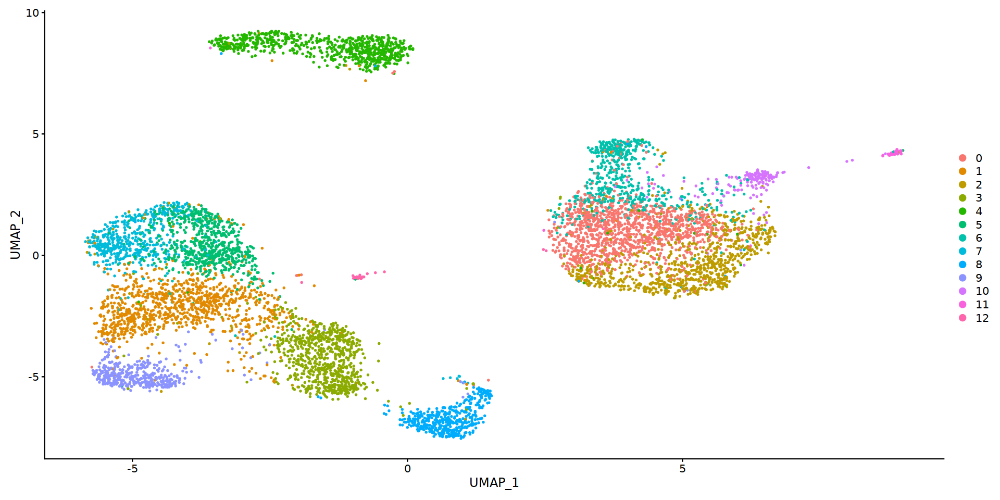

In [159]:
p_result <- mergeGiggleResult(Seurat_result, giggle)

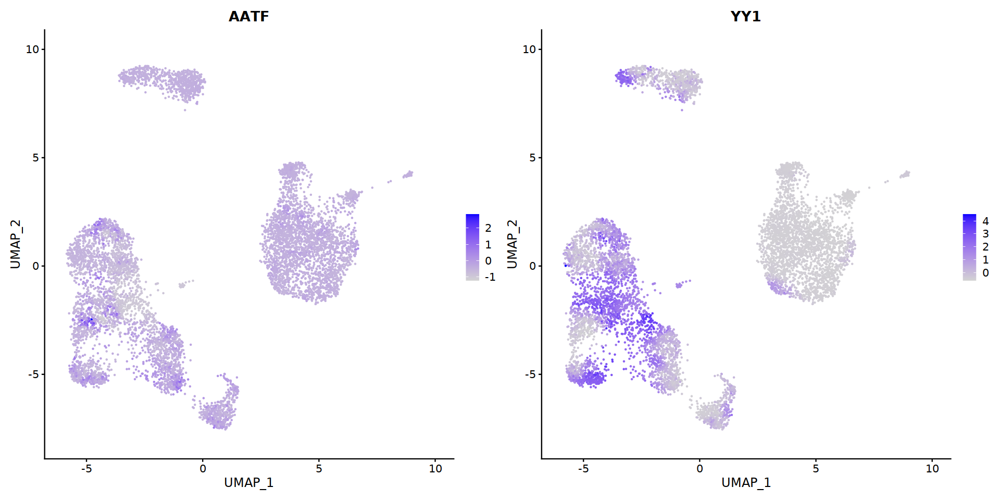

In [196]:
options(repr.plot.width=16, repr.plot.height=8)
FeaturePlot(object = p_result$ATAC, feature=c('AATF', 'YY1'))

In [32]:
p_result$ATAC@meta.data

,orig.ident,nCount_ATAC,nFeature_ATAC,ATAC_snn_res.0.6,seurat_clusters,nCount_ACTIVITY,nFeature_ACTIVITY,assign.ident,assign.score,assign.celltype,⋯,ZFP42,ZFP57,ZFP64,ZFP69,ZFP69B,ZFP82,ZFP90,ZFX,ZFY,ZHX1
,<fct>,<dbl>,<int>,<fct>,<fct>,<dbl>,<int>,<chr>,<dbl>,<chr>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AAACGAAAGACACGGT,atac_pbmc_10k_v1_S1_L001,3026,3026,5,5,3597.6226,7184,CD4Tconv,0.11724116,CD4Tconv,⋯,0.7476030853,0.261490882,1.2253743541,0.35505942,0.04327489,0.003118862,0.00090509,1.3984402355,1.3984402355,0.0008718126
AAACGAAAGAGGTGGG,atac_pbmc_10k_v1_S1_L001,2517,2517,6,6,2589.4861,7848,Mono/Macro,0.76535819,Mono/Macro,⋯,0.0008696457,0.000871121,2.6880558792,0.11668725,0.07364338,0.382761167,1.21811236,2.6802424599,2.6802424599,0.0008718126
AAACGAAAGCACGTAG,atac_pbmc_10k_v1_S1_L001,3317,3317,6,6,3401.6051,9881,Mono/Macro,0.76535819,Mono/Macro,⋯,0.0008696457,0.000871121,2.6880558792,0.11668725,0.07364338,0.382761167,1.21811236,2.6802424599,2.6802424599,0.0008718126
AAACGAAAGCGCCTAC,atac_pbmc_10k_v1_S1_L001,2980,2980,0,0,3077.3342,9085,Mono/Macro,1.03903755,Mono/Macro,⋯,2.0839883462,0.000871121,2.6880558792,0.19273611,0.07364338,0.003118862,1.66955030,2.6802424599,2.6802424599,0.0008718126
AAACGAAAGCTTTCCC,atac_pbmc_10k_v1_S1_L001,2993,2993,5,5,3433.1439,7361,CD4Tconv,0.11724116,CD4Tconv,⋯,0.7476030853,0.261490882,1.2253743541,0.35505942,0.04327489,0.003118862,0.00090509,1.3984402355,1.3984402355,0.0008718126
AAACGAAAGGCGTCCT,atac_pbmc_10k_v1_S1_L001,2761,2761,1,1,3256.2735,6692,CD4Tconv,0.04945659,CD4Tconv,⋯,1.1283770377,0.122637639,0.7051718176,0.28825903,0.16213264,0.003118862,0.03710745,0.6979089130,0.6979089130,0.8668845681
AAACGAAAGGCTTTAC,atac_pbmc_10k_v1_S1_L001,3310,3310,6,6,3463.2474,9491,Mono/Macro,0.76535819,Mono/Macro,⋯,0.0008696457,0.000871121,2.6880558792,0.11668725,0.07364338,0.382761167,1.21811236,2.6802424599,2.6802424599,0.0008718126
AAACGAAAGTGATATG,atac_pbmc_10k_v1_S1_L001,4532,4532,2,2,4618.3482,12254,Mono/Macro,1.20321468,Mono/Macro,⋯,0.0008696457,0.070860827,2.6880558792,0.04867112,0.91840576,0.003118862,0.00090509,2.6802424599,2.6802424599,0.0008718126
AAACGAAAGTTTGGAA,atac_pbmc_10k_v1_S1_L001,581,581,5,5,733.7765,1483,CD4Tconv,0.11724116,CD4Tconv,⋯,0.7476030853,0.261490882,1.2253743541,0.35505942,0.04327489,0.003118862,0.00090509,1.3984402355,1.3984402355,0.0008718126


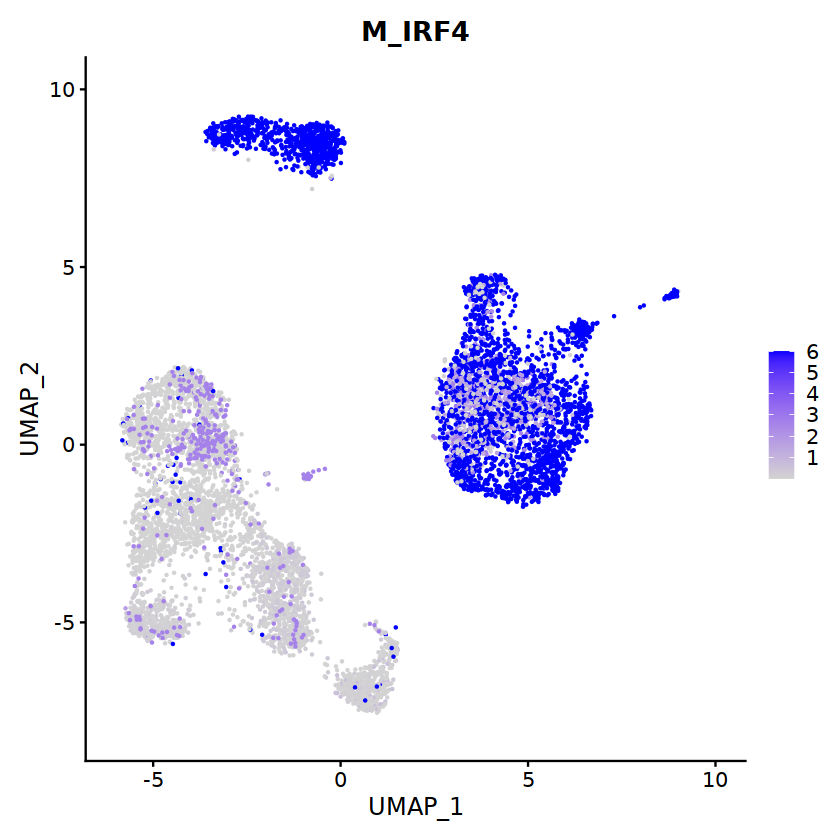

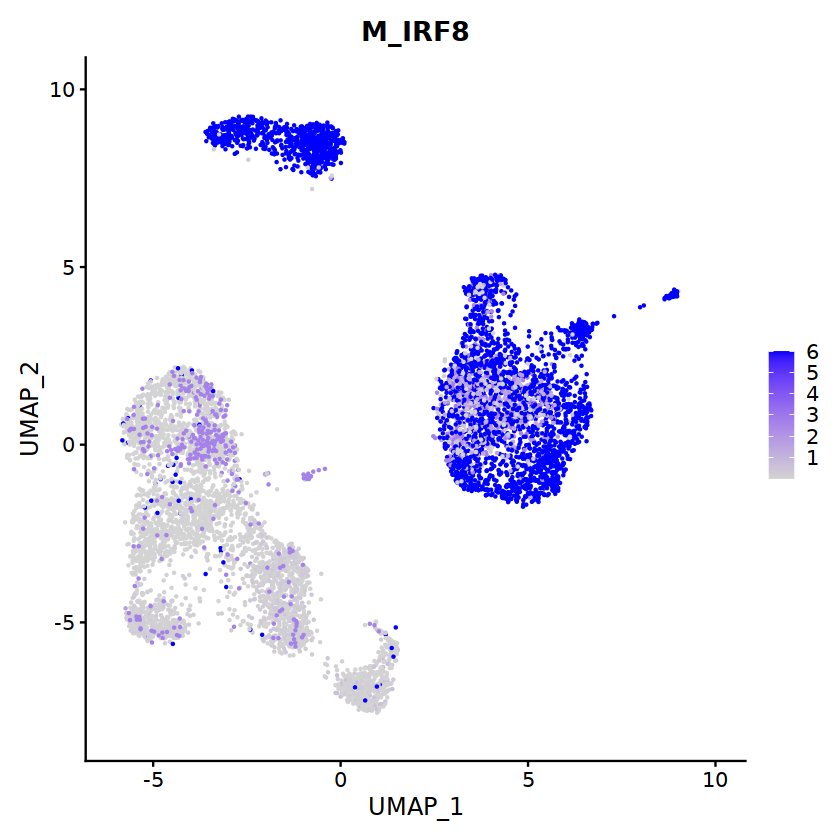

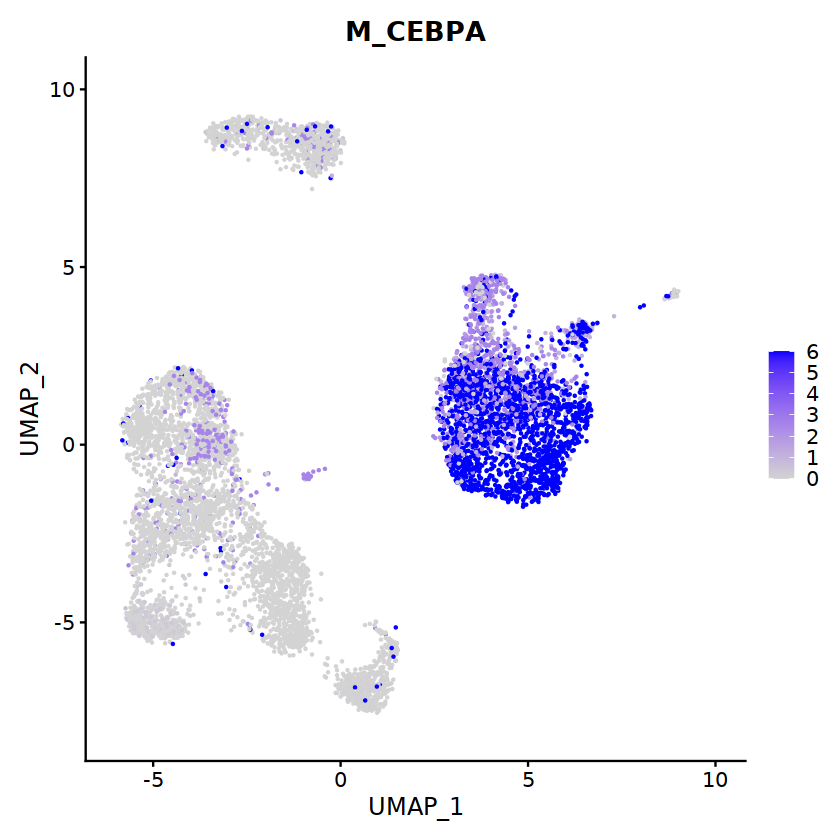

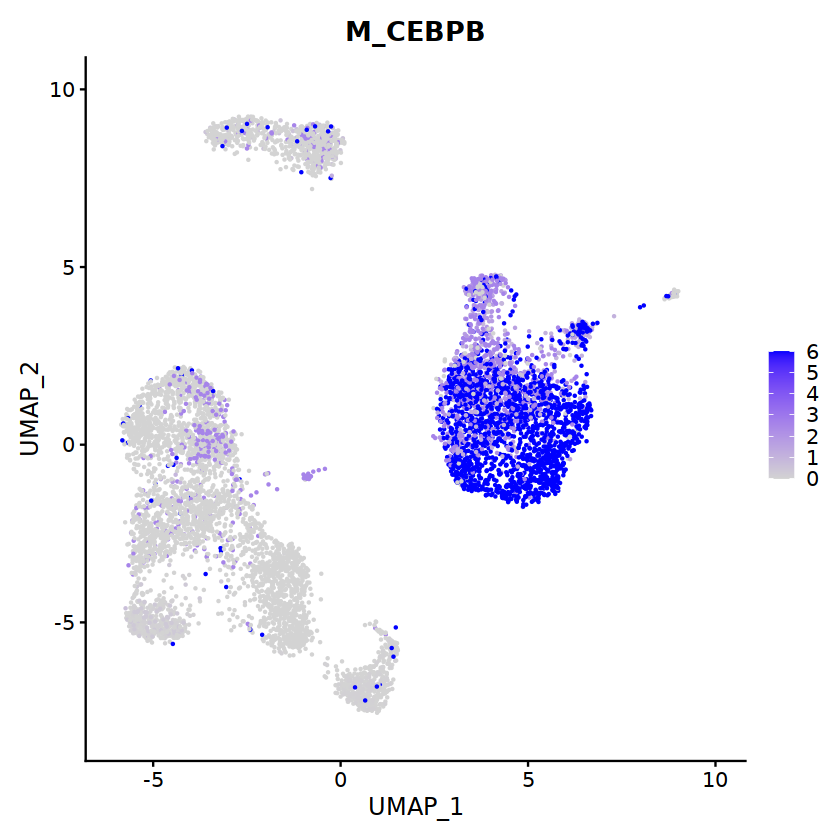

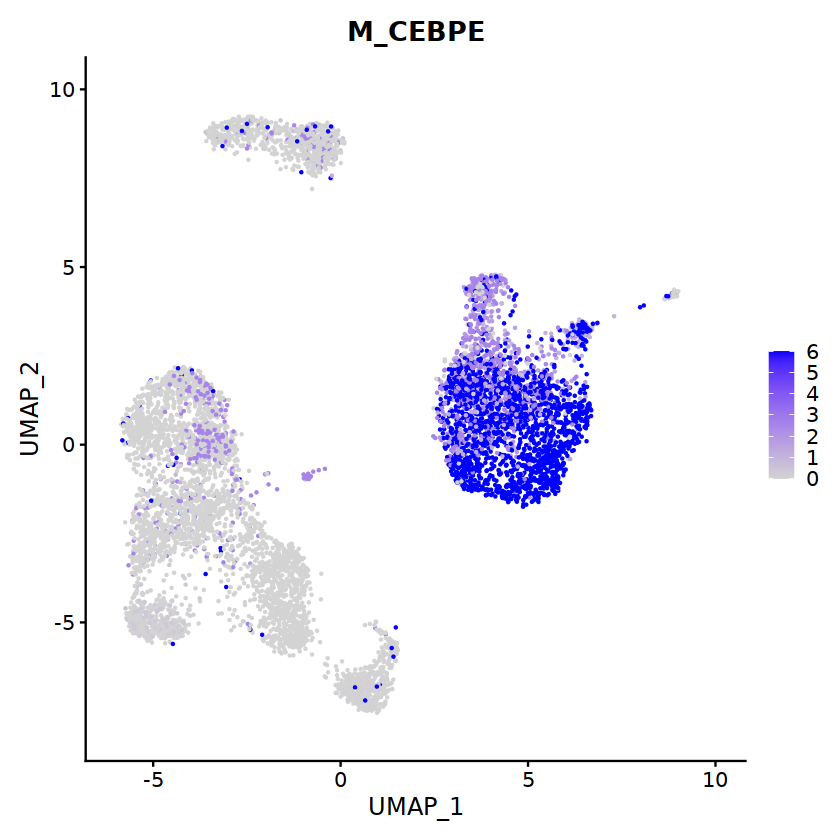

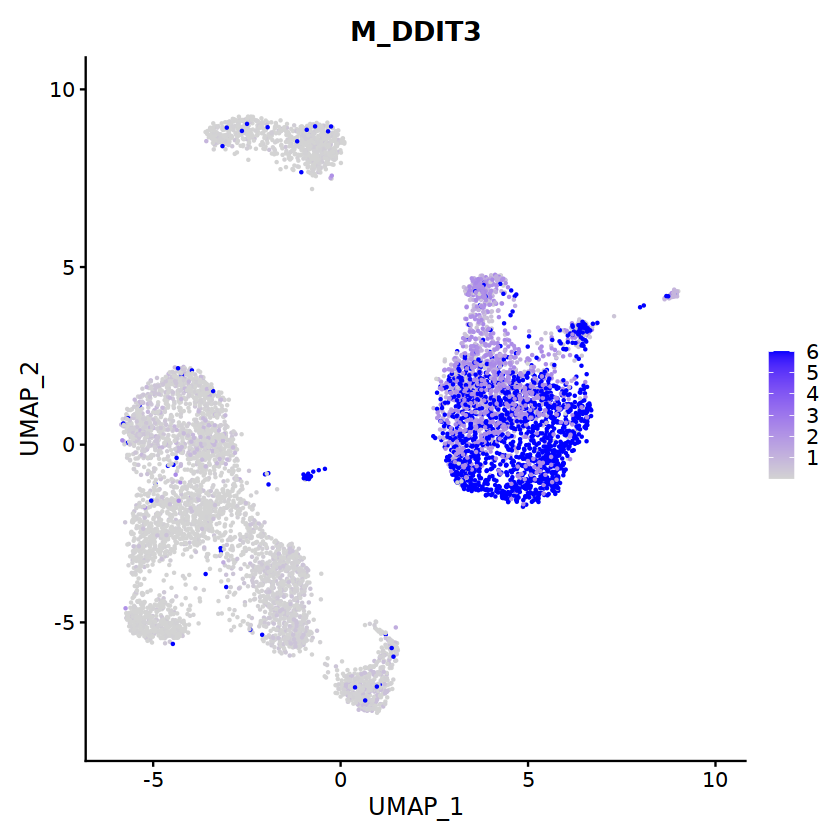

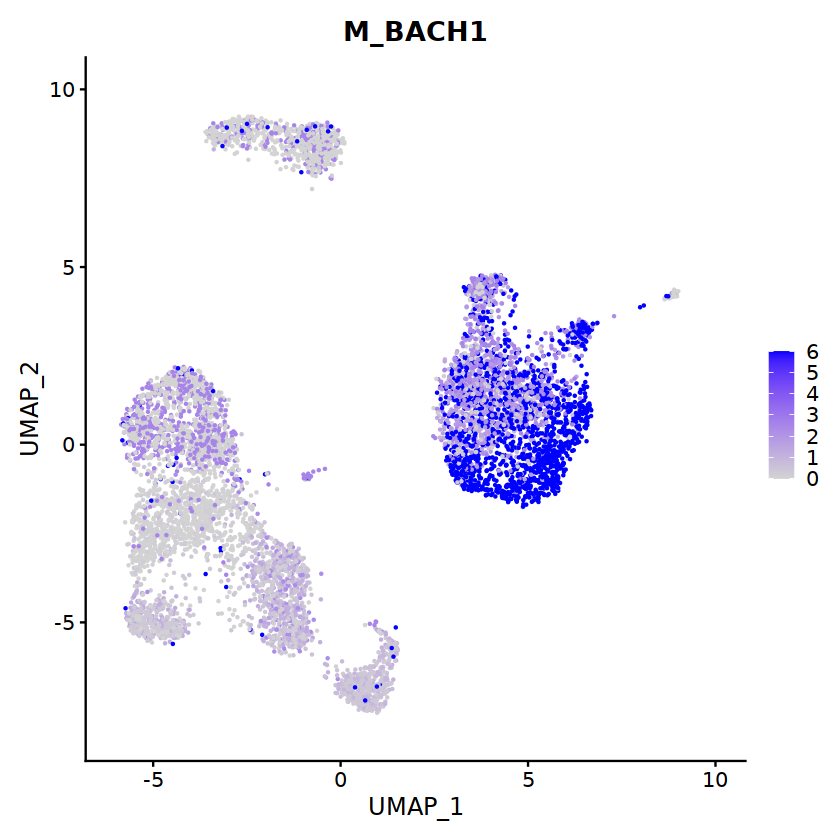

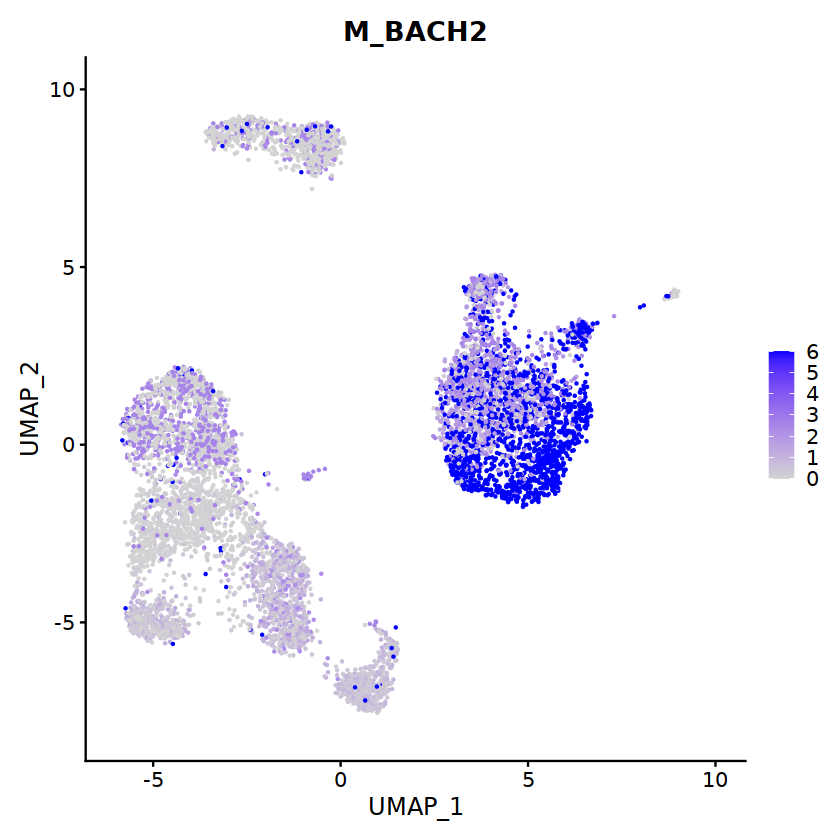

Warning message in FetchData(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: M_BCL11A”


ERROR: Error: None of the requested features were found: M_BCL11A in slot data


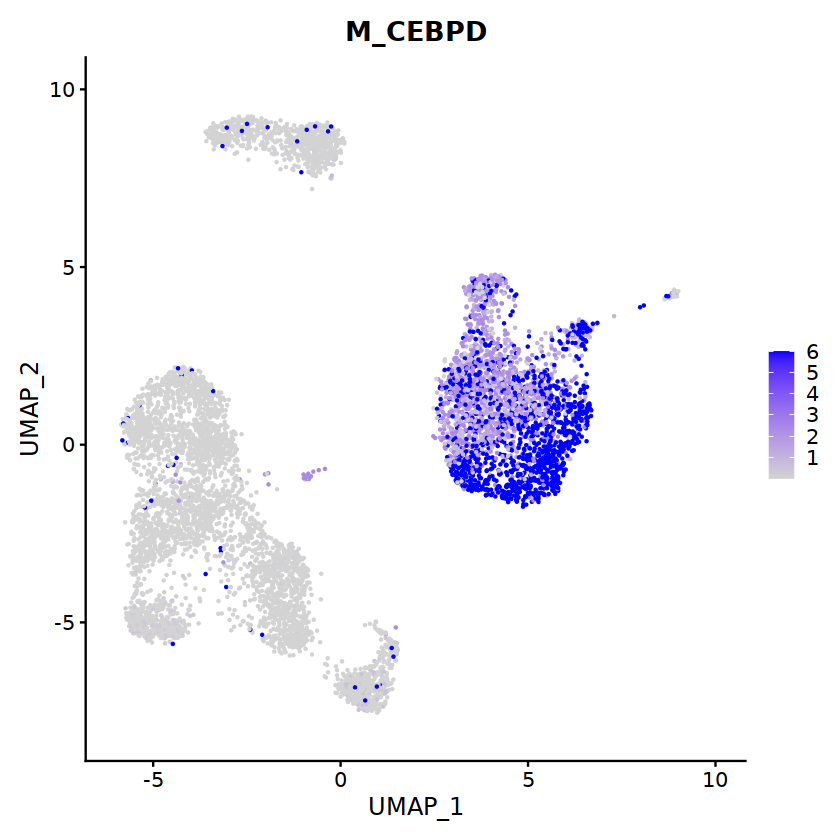

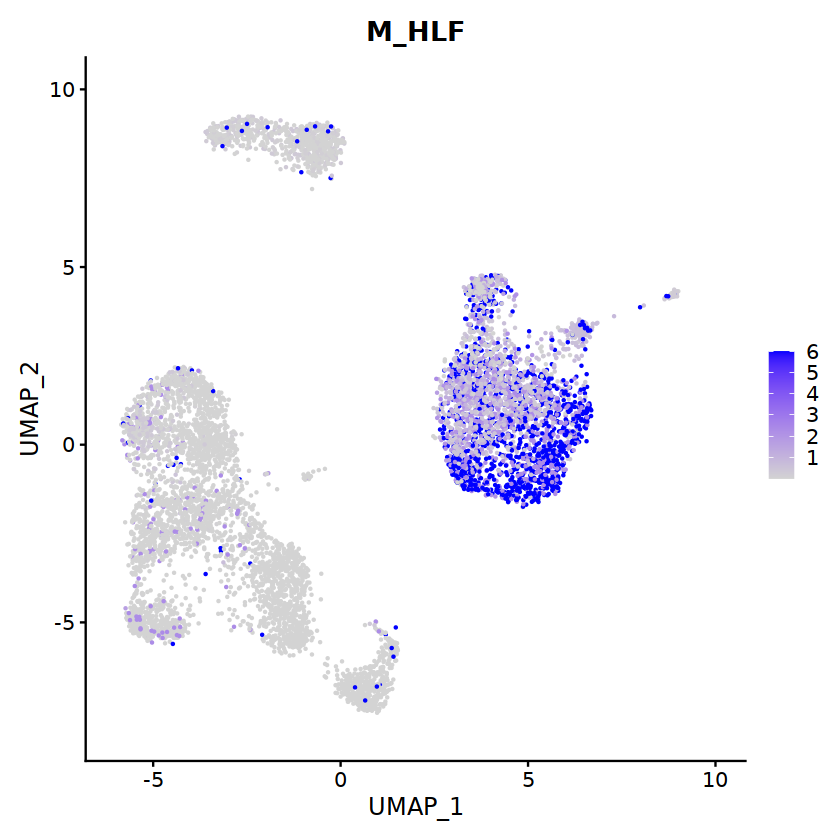

In [56]:
for (i in TFlist) {
    fig <- FeaturePlot(object = p_result$ATAC, feature=i)
    show(fig)
}

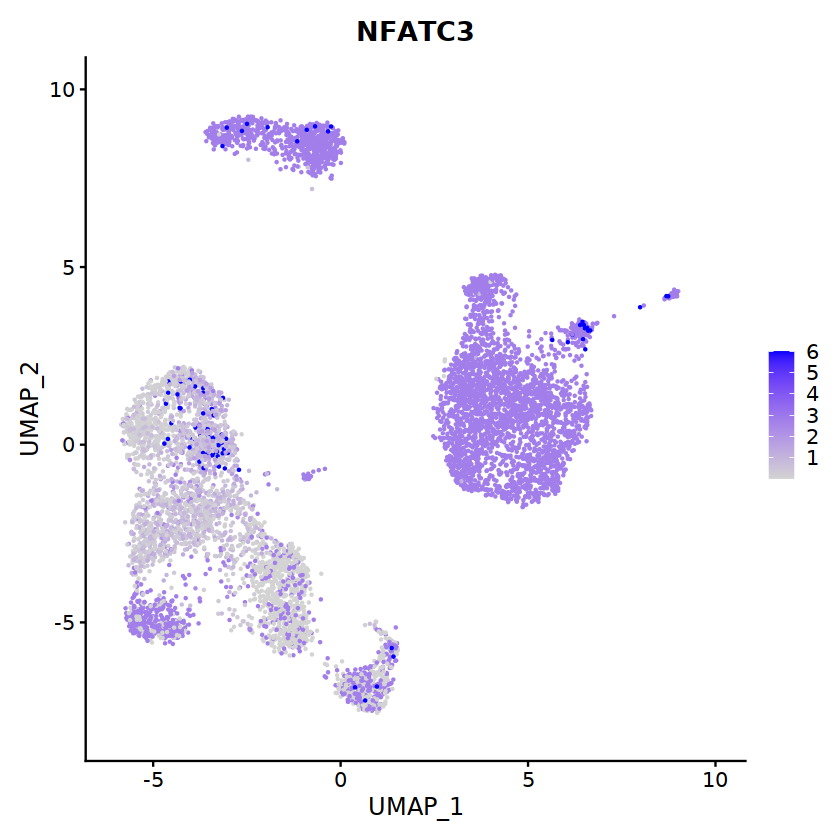

Warning message in FetchData(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: M_NFATC3”


ERROR: Error: None of the requested features were found: M_NFATC3 in slot data


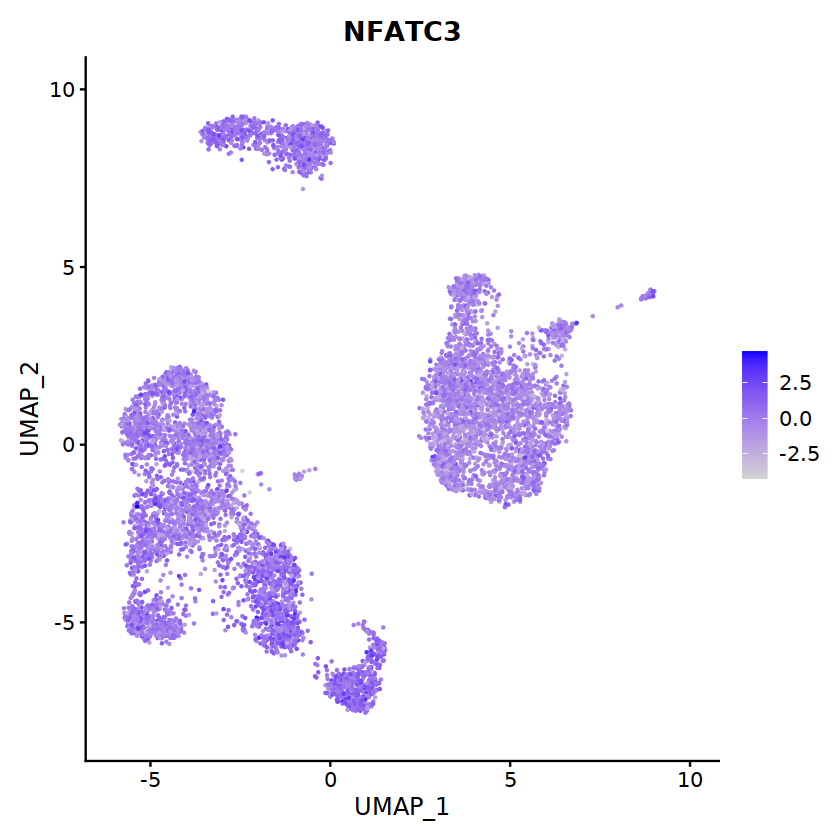

In [5]:
FeaturePlot(object = top_300_10k_p_result$ATAC, feature="NFATC3")
FeaturePlot(object = chromvar_result$ATAC, feature="NFATC3")
FeaturePlot(object = motif_p_result$ATAC, feature="M_NFATC3")


In [2]:
chromvar_result <- qread('10X_ATAC/chromVAR_result_more_motif.qs')

In [3]:
motif_p_result <- qread('10X_ATAC/per_50_cell_peak/motif_index/pvalue.qs')

In [4]:
top_300_10k_p_result <- qread('10X_ATAC/per_50_cell_peak/300_10k_tf_index/pvalue.qs')

In [62]:
chromvar_result

$ATAC
An object of class Seurat 
102895 features across 7573 samples within 2 assays 
Active assay: ACTIVITY (42393 features, 2000 variable features)
 1 other assay present: ATAC
 2 dimensional reductions calculated: lsi, umap

$peaks
              p_val  avg_logFC pct.1 pct.2     p_val_adj cluster
1     1.964923e-120  0.5852602 0.337 0.100 1.188817e-115       0
2     7.628627e-118  0.5556964 0.338 0.102 2.307736e-113       0
3     2.158844e-109  0.5486518 0.345 0.113 4.353812e-105       0
4     1.526983e-103  0.5346281 0.333 0.110  2.309637e-99       0
5      2.623207e-97  0.5375795 0.366 0.138  3.174185e-93       0
6      2.672385e-96  0.5167901 0.279 0.083  2.694744e-92       0
7      7.736592e-96  0.5133011 0.328 0.114  6.686847e-92       0
8      1.610648e-94  0.4982463 0.285 0.088  1.218093e-90       0
9      1.236374e-88 -0.6356058 0.045 0.329  8.311453e-85       0
10     4.131058e-88  0.5189848 0.300 0.103  2.499373e-84       0
11     1.038896e-86  0.4932365 0.299 0.101  5.7141

In [27]:
qsave(p_result, '10X_ATAC/beds/per50/neighbor_seuratobject.qs')

### fc intergration

fc value was calculation by another jupyter (same with p) which codes in python

In [7]:
giggle_table_file <- '10X_ATAC/per_50_cell_peak/300_10k_tf_index/result_fc.txt'
map_list <- readRDS("10X_ATAC/per_50_cell_peak/map_list.rds")
rds_file <- '10X_ATAC/per_50_cell_peak/300_10k_tf_index/fc.rds'

In [8]:
giggle <- read.table(giggle_table_file, sep="\t", header = T, row.names="Factor")

In [9]:
bc_start_site <- dim(giggle)[2] + 1 
for (i in names(map_list)){
    if (length(map_list[i][[1]]) < 20){
        next
    } else {
        for (j in seq(1,length(map_list[i][[1]]))){
            giggle[,map_list[i][[1]][j]] <- giggle[,paste0('X', i)]
        }
    }    
}
giggle <- t(giggle[,bc_start_site:dim(giggle)[2]])

In [10]:
giggle <- log2(giggle)

In [22]:
vari <- data.frame(apply(giggle, 2, sd))
TFlist <- head(rownames(vari)[order(vari, decreasing = T)],5)
TFlist <- c("SPI1", "CEBPA", "CEBPB", TFlist)

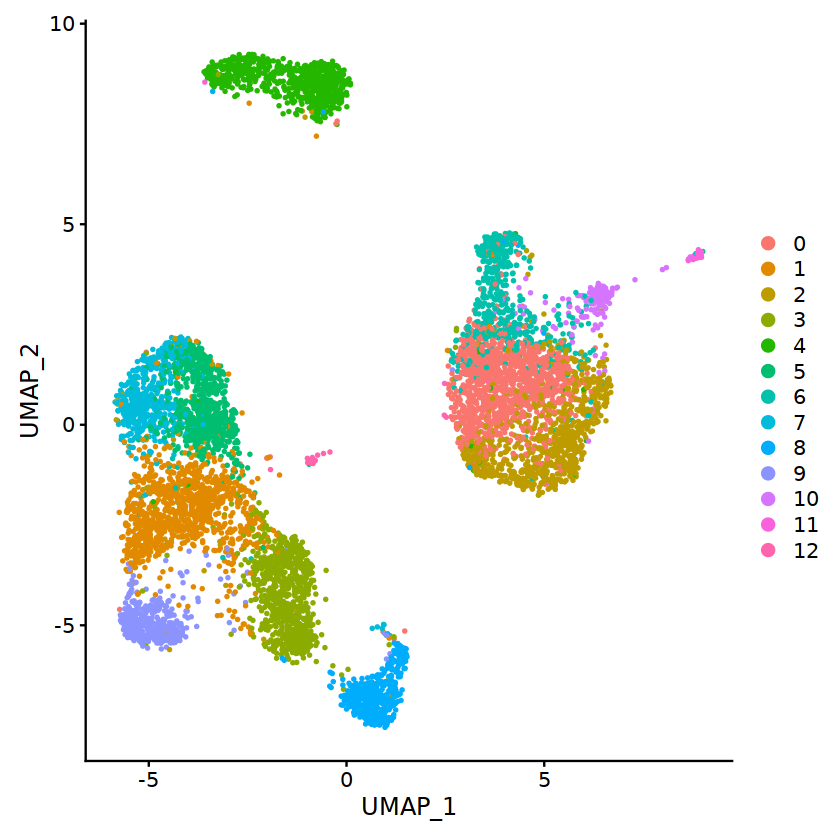

In [15]:
fc_result <- mergeGiggleResult(Seurat_result, giggle)

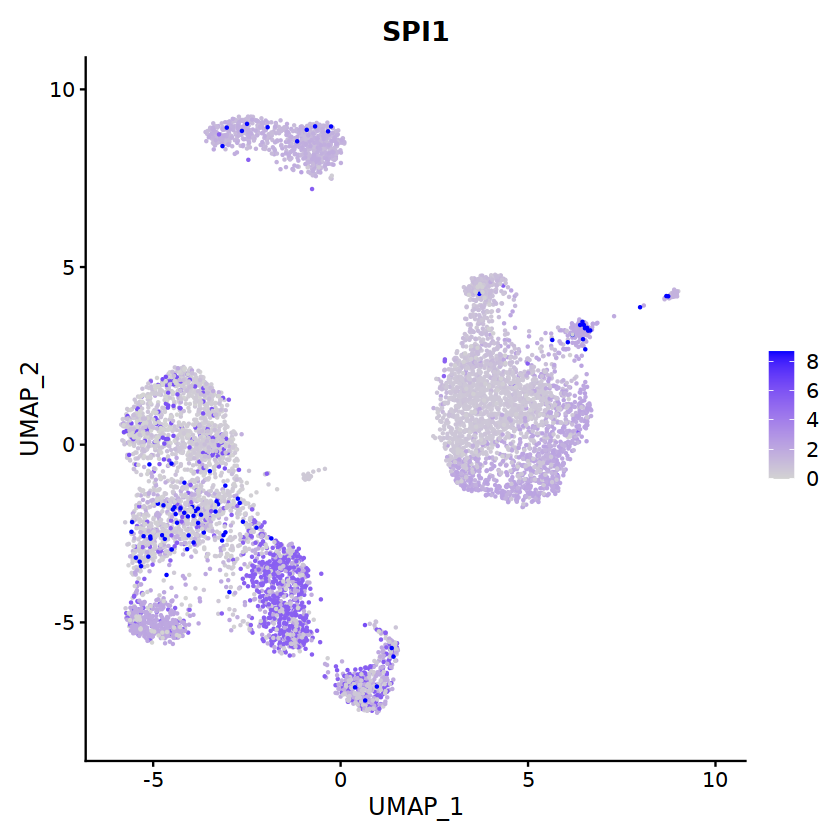

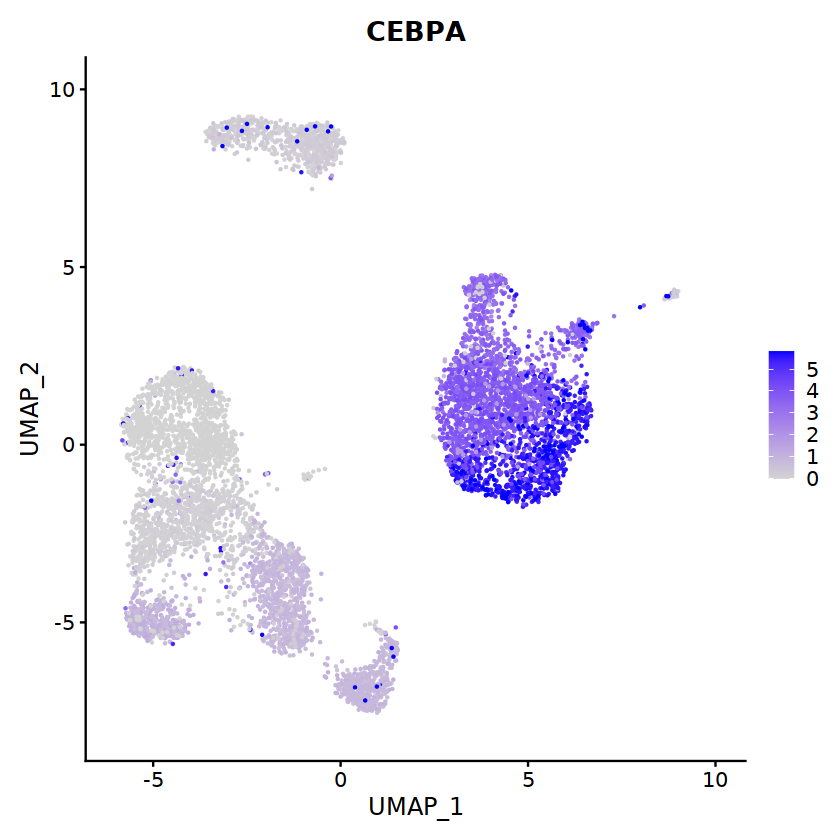

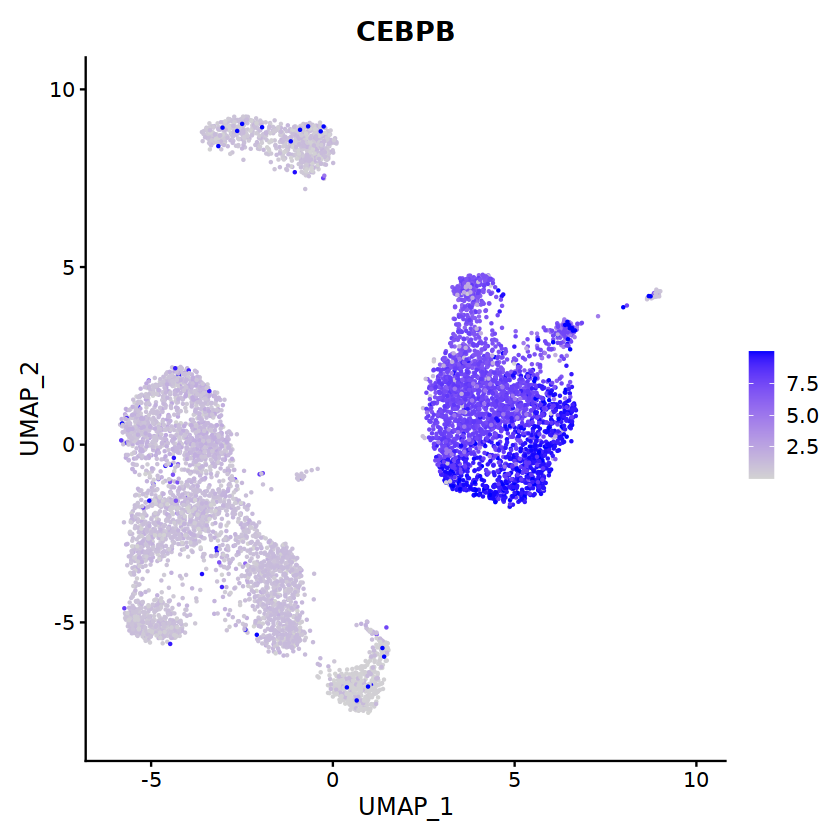

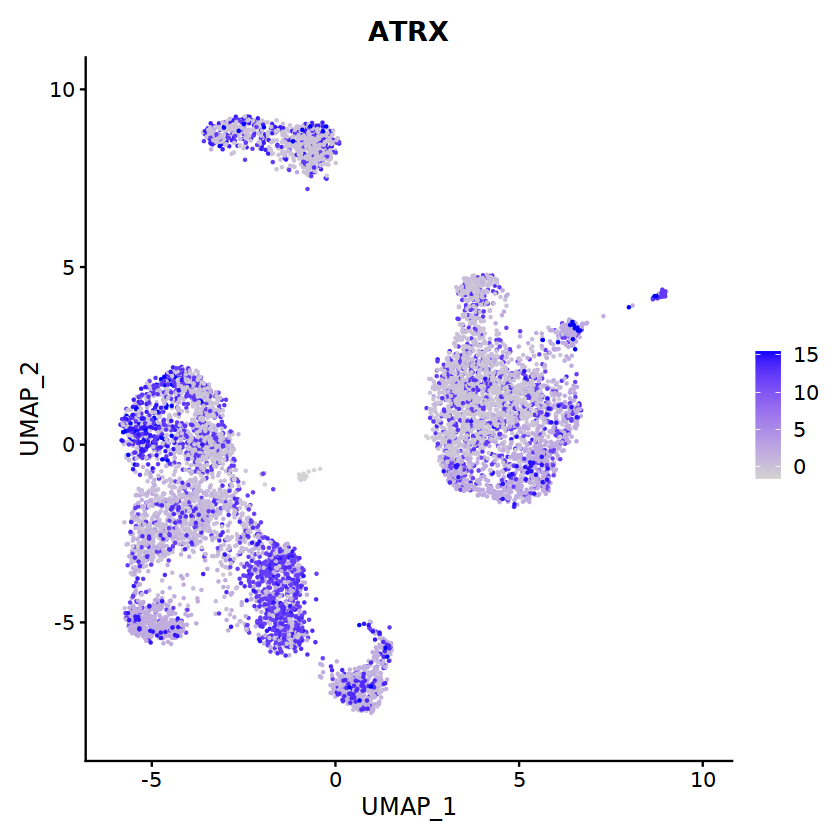

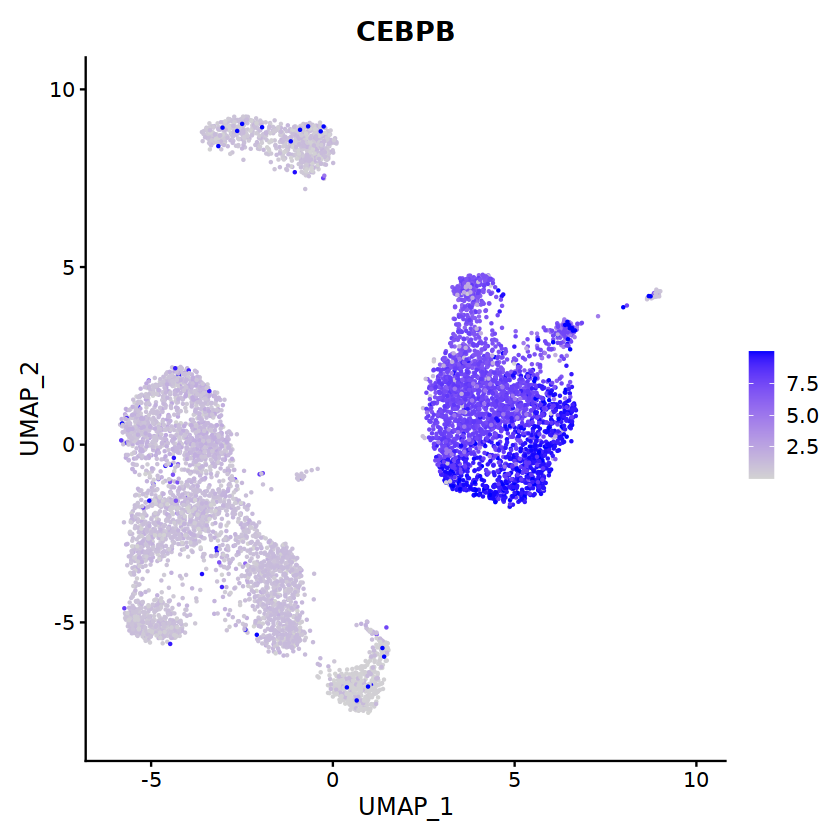

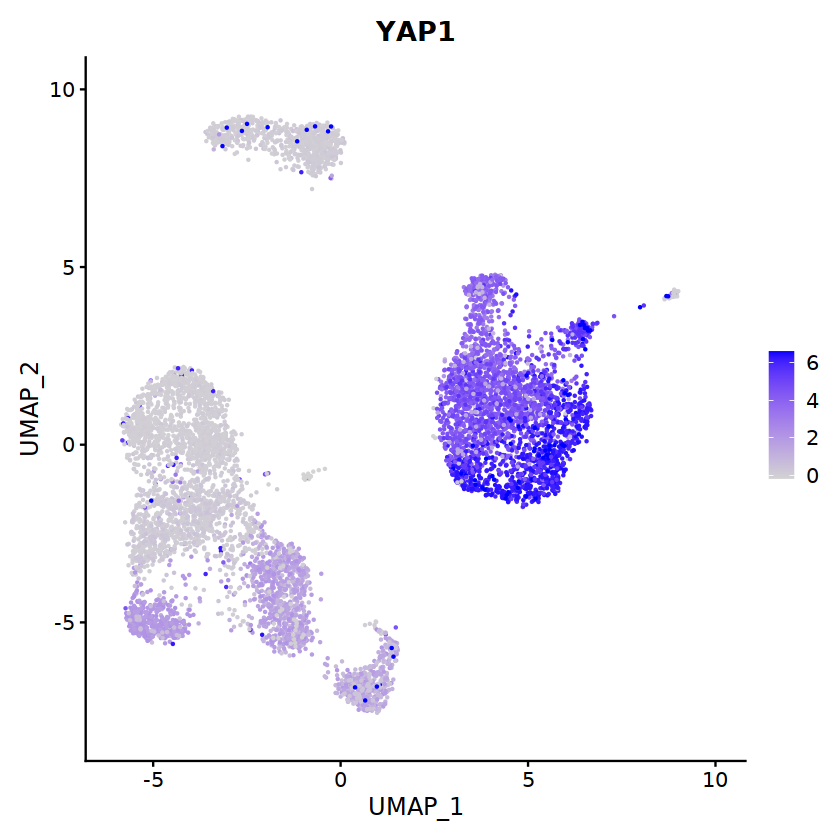

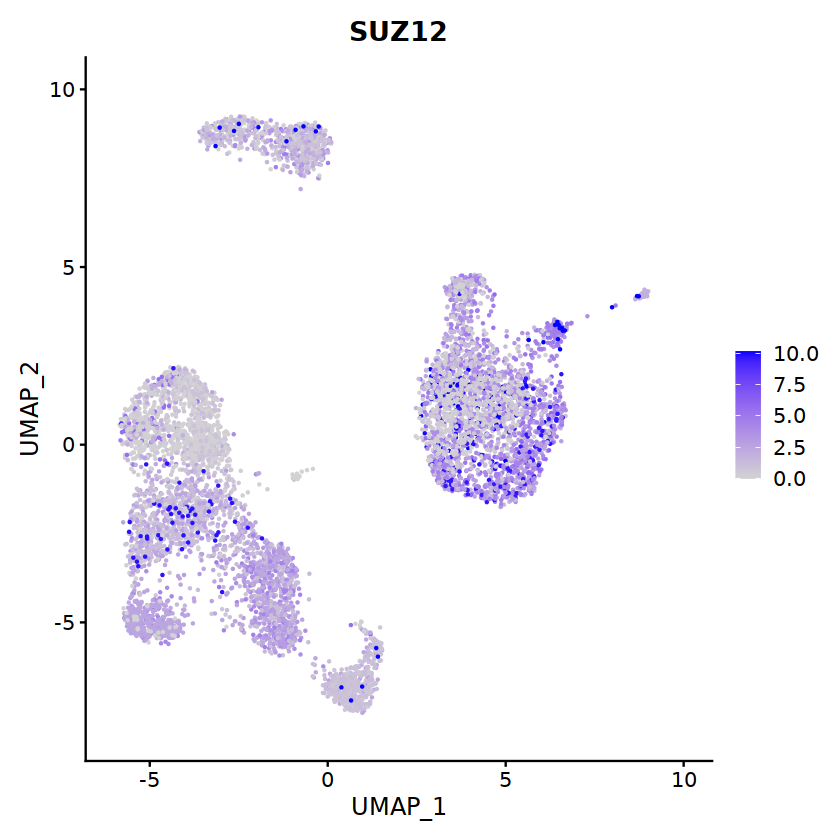

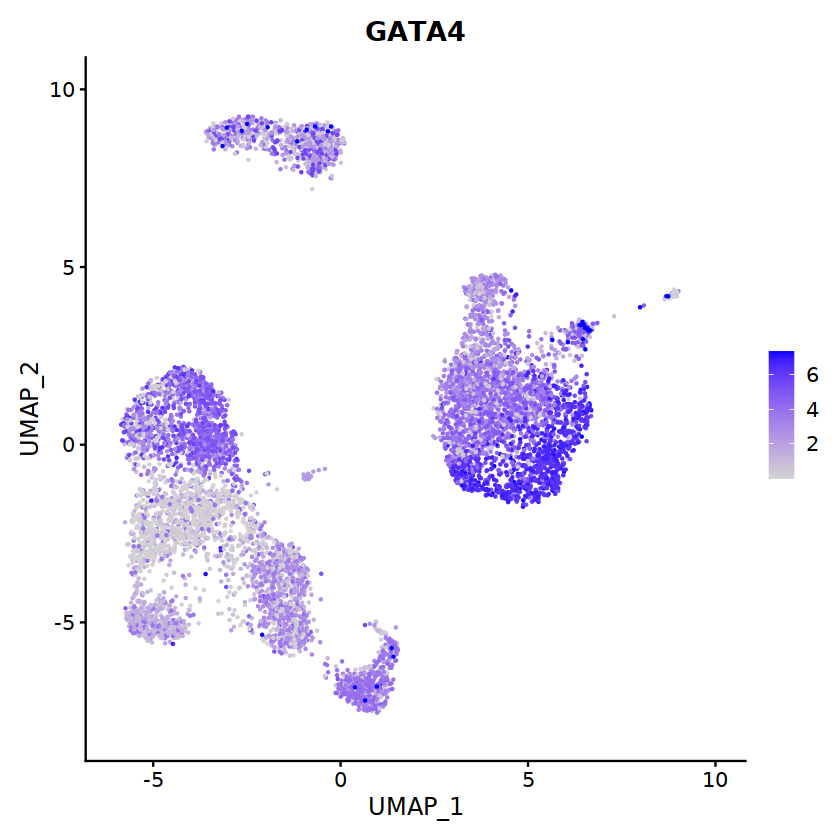

In [25]:
for (i in TFlist) {
    fig <- FeaturePlot(object = fc_result$ATAC, feature=i)
    show(fig)
}

In [16]:
# saveRDS(result, rds_file)
qsave(fc_result, '10X_ATAC/per_50_cell_peak/300_10k_tf_index/fc.qs')

### check one specific gene/TF

In [ ]:
fig <- FeaturePlot(object = p_result$ATAC, feature="EOMES")
show(fig)

### mean or max intergration

this part uses the orginal giggle score (mean / max)

In [ ]:
value_type <-  "mean"
giggle_table_file <- paste0("10X_ATAC/per_cell_peak/per_cell_peak_all_giggle_score_" , value_type, ".txt")
rds_file <- paste0("10X_ATAC/per_cell_peak/giggle_result_", value_type, ".rds")
map_list <- readRDS("10X_ATAC/per_cell_peak/map_list.rds")

In [ ]:
giggle <- read.table(giggle_table_file, sep="\t", header = T, row.names="Factor")

In [ ]:
giggle <- t(giggle)

In [ ]:
vari <- data.frame(apply(giggle, 2, sd))
TFlist <- head(rownames(vari)[order(vari, decreasing = T)],10)

In [ ]:
result = readRDS('10X_ATAC/analysis/atac_pbmc_10k_v1_S1_L001//Result//Analysis//atac_pbmc_10k_v1_S1_L001_scATAC_Object.rds')

p1 <- DimPlot(object = result$ATAC, pt.size = 0.5)
show(p1)
result$giggle <- giggle
result$ATAC@meta.data <- merge(result$ATAC@meta.data, giggle, by="row.names", all = TRUE)
rownames(result$ATAC@meta.data) <- result$ATAC@meta.data[,1]
for (i in colnames(giggle)) {
    result$ATAC@meta.data[i][is.na(result$ATAC@meta.data[i])] <- min(result$ATAC@meta.data[i], na.rm=T)
}
for (i in TFlist) {
    fig <- FeaturePlot(object = result$ATAC, feature=i)
    show(fig)
}

In [ ]:
saveRDS(result, rds_file)

### ANALYSIS

In [31]:
origin_chromVAR <- qread('10X_ATAC/per_50_cell_peak/1k_TF_index/run_chromVAR_result.qs')
# chromVAR_result <- qread('10X_ATAC/chromVAR_result_more_motif.qs')
# p_result <- qread('10X_ATAC/per_50_cell_peak/300_10k_tf_index/pvalue.qs')
# fc_result <- qread('10X_ATAC/per_50_cell_peak/300_10k_tf_index/fc.qs')

In [32]:
variability <- origin_chromVAR$variability

In [33]:
TFlist_chromvar <- head(variability[order(variability['variability'], decreasing=T),]$name, 100)
p_sd <- data.frame(apply(p_result$giggle, 2, sd))
TFlist_p <- head(rownames(p_sd)[order(p_sd, decreasing = T)],100)
# fc_sd <- data.frame(apply(fc_result$giggle, 2, sd))
# TFlist_fc <- head(rownames(fc_sd)[order(fc_sd, decreasing = T)],100)

In [433]:
chromTFlist <- variability[order(variability['variability'], decreasing=T),]$name

p_sd <- data.frame(apply(p_result$giggle, 2, sd))
giggle_TFlist <- rownames(p_sd)[order(p_sd, decreasing = T)]
G_C_overlap <- intersect(giggle_TFlist,chromTFlist)
C_G_overlap <- intersect(chromTFlist,giggle_TFlist)

In [395]:
p_sd

,apply.p_result.giggle..2..sd.
,<dbl>
AATF,0.2855381
ADNP,0.3254845
AEBP2,0.3776212
AFF1,0.5943319
AFF4,0.7880308
AGO1,0.5803622
AGO2,0.6151767
AHR,0.3859122
AHRR,0.3631137


In [10]:
p_result$ATAC@meta.data

,orig.ident,nCount_ATAC,nFeature_ATAC,ATAC_snn_res.0.6,seurat_clusters,nCount_ACTIVITY,nFeature_ACTIVITY,assign.ident,assign.score,assign.celltype,⋯,ZSCAN22,ZSCAN23,ZSCAN29,ZSCAN31,ZSCAN5A,ZSCAN5B,ZTA,ZXDB,ZXDC,ZZZ3
,<fct>,<dbl>,<int>,<fct>,<fct>,<dbl>,<int>,<chr>,<dbl>,<chr>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AAACGAAAGACACGGT,atac_pbmc_10k_v1_S1_L001,3026,3026,5,5,3597.6226,7184,CD4Tconv,0.11724116,CD4Tconv,⋯,6.0000000,0.2501934,0.1813325,0.474041816,1.2469221,0.061337389,0.3594651115,1.7921688606,-4.342943e-07,0.060143682
AAACGAAAGAGGTGGG,atac_pbmc_10k_v1_S1_L001,2517,2517,6,6,2589.4861,7848,Mono/Macro,0.76535819,Mono/Macro,⋯,2.8824682,2.8375560,2.8266655,0.001306956,2.7542028,0.001303713,1.4007104859,2.7600070828,-4.342943e-07,2.421908822
AAACGAAAGCACGTAG,atac_pbmc_10k_v1_S1_L001,3317,3317,6,6,3401.6051,9881,Mono/Macro,0.76535819,Mono/Macro,⋯,2.8824682,2.8375560,2.8266655,0.001306956,2.7542028,0.001303713,1.4007104859,2.7600070828,-4.342943e-07,2.421908822
AAACGAAAGCGCCTAC,atac_pbmc_10k_v1_S1_L001,2980,2980,0,0,3077.3342,9085,Mono/Macro,1.03903755,Mono/Macro,⋯,2.8824682,2.8375560,2.8266655,2.269418450,2.7542028,0.001303713,1.3057532494,2.7600070828,-4.342943e-07,2.421908822
AAACGAAAGCTTTCCC,atac_pbmc_10k_v1_S1_L001,2993,2993,5,5,3433.1439,7361,CD4Tconv,0.11724116,CD4Tconv,⋯,6.0000000,0.2501934,0.1813325,0.474041816,1.2469221,0.061337389,0.3594651115,1.7921688606,-4.342943e-07,0.060143682
AAACGAAAGGCGTCCT,atac_pbmc_10k_v1_S1_L001,2761,2761,1,1,3256.2735,6692,CD4Tconv,0.04945659,CD4Tconv,⋯,0.8209708,2.2438622,0.4757682,0.001306956,1.3196975,0.247871901,0.4186242754,6.0000000000,-4.342943e-07,0.037818714
AAACGAAAGGCTTTAC,atac_pbmc_10k_v1_S1_L001,3310,3310,6,6,3463.2474,9491,Mono/Macro,0.76535819,Mono/Macro,⋯,2.8824682,2.8375560,2.8266655,0.001306956,2.7542028,0.001303713,1.4007104859,2.7600070828,-4.342943e-07,2.421908822
AAACGAAAGTGATATG,atac_pbmc_10k_v1_S1_L001,4532,4532,2,2,4618.3482,12254,Mono/Macro,1.20321468,Mono/Macro,⋯,2.8824682,2.8375560,2.8266655,0.001306956,2.7542028,0.253690314,6.0000000000,2.7600070828,2.730597e+00,0.001308814
AAACGAAAGTTTGGAA,atac_pbmc_10k_v1_S1_L001,581,581,5,5,733.7765,1483,CD4Tconv,0.11724116,CD4Tconv,⋯,6.0000000,0.2501934,0.1813325,0.474041816,1.2469221,0.061337389,0.3594651115,1.7921688606,-4.342943e-07,0.060143682


In [54]:
metadata <- p_result$ATAC@meta.data
cluster <- 9
cluster_all_bc <- rownames(metadata[which(metadata$seurat_clusters == cluster),])
cluster_bc <- cluster_all_bc[cluster_all_bc %in% intersect(rownames(p_result$giggle), rownames(chromVAR_result$zscore))]

# cl_type <- 'NK'
# ct_all_bc <- rownames(metadata[which(metadata$assign.ident == cl_type),])
# ct_bc <- ct_all_bc[ct_all_bc %in% intersect(rownames(p_result$giggle), rownames(chromVAR_result$zscore))]
# cluster_bc <- ct_bc

In [35]:
z_frame <-  chromVAR_result$zscore[cluster_bc,]
p_giggle <- p_result$giggle[cluster_bc,]
fc_giggle <- fc_result$giggle[cluster_bc,]

ERROR: Error in eval(expr, envir, enclos): 找不到对象'cluster_bc'


In [56]:
zscore_median <- data.frame(apply(z_frame,2,median))
colnames(zscore_median) <- c("chromVAR_zscore_median")
zscore_median[,"name"] <- rownames(zscore_median)

giggle_p <- data.frame(apply(p_giggle,2,median))
colnames(giggle_p) <- c("giggle_p_value")
giggle_p[,"name"] <- rownames(giggle_p)

giggle_fc <- data.frame(apply(fc_giggle,2,median))
colnames(giggle_fc) <- c("giggle_fc_value")
giggle_fc[,"name"] <- rownames(giggle_fc)

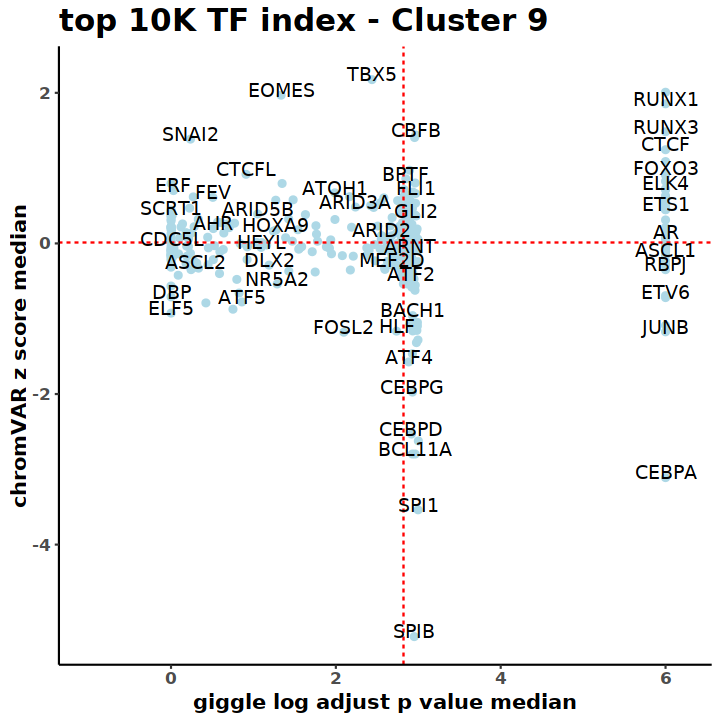

In [59]:
## p vs z
options(repr.plot.width=6, repr.plot.height=6)
ov_table <- merge(giggle_p,zscore_median,by = "name")
colnames(ov_table) <- c("name", "giggle_log_adjust_p_value_median", "chromVAR_z_score_median")
ov_table <- as.data.frame(ov_table)

ggplot(ov_table, aes(x = giggle_log_adjust_p_value_median, y = chromVAR_z_score_median)) +
geom_point(color="light blue")+
# geom_smooth(method="lm")+
geom_hline(aes(yintercept=median(chromVAR_z_score_median)), color = "red", linetype="dashed")+ 
geom_vline(aes(xintercept=median(giggle_log_adjust_p_value_median)), color = "red", linetype="dashed")+
geom_text(aes(y = chromVAR_z_score_median + .07, label = name), check_overlap=T)+
scale_colour_brewer(palette = "Set1")+
lims(x=c(-1,6.2))+
labs(x="giggle log adjust p value median",y="chromVAR z score median", title = "top 10K TF index - Cluster 9")+ 
theme_classic(base_size = 10) +
theme(axis.title.x = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5), 
      axis.title.y = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5),
      title = element_text(size = 15, face = "bold", vjust = 2, hjust = 0.5),
      axis.text = element_text(size = 10, face = "bold")
     )

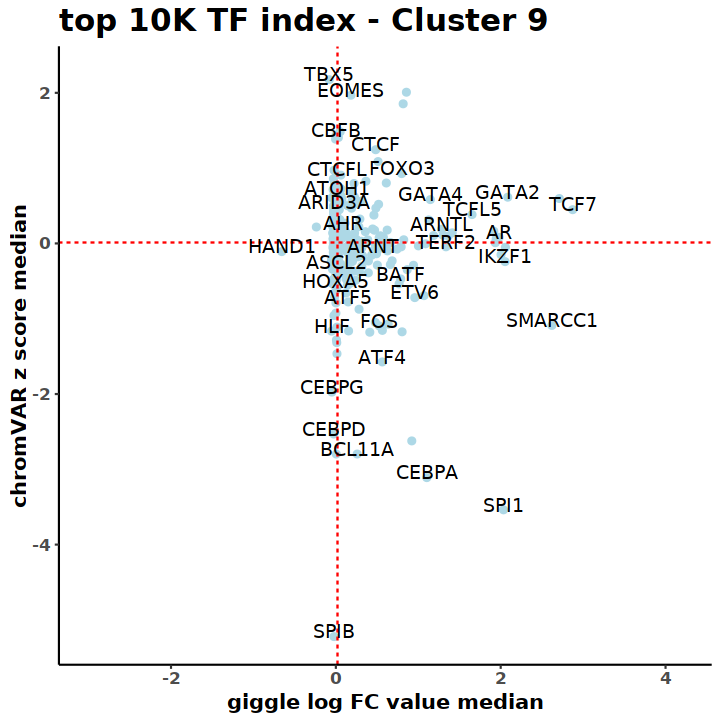

In [60]:
## fc vs z
options(repr.plot.width=6, repr.plot.height=6)
ov_table <- merge(giggle_fc, zscore_median,by = "name")
colnames(ov_table) <- c("name", "giggle_log_adjust_fc_value_median", "chromVAR_z_score_median")
ov_table <- as.data.frame(ov_table)

ggplot(ov_table, aes(x = giggle_log_adjust_fc_value_median, y = chromVAR_z_score_median)) +
geom_point(color="light blue")+
geom_hline(aes(yintercept=median(chromVAR_z_score_median)), color = "red", linetype="dashed")+ 
geom_vline(aes(xintercept=median(giggle_log_adjust_fc_value_median)), color = "red", linetype="dashed")+
geom_text(aes(y = chromVAR_z_score_median + .07, label = name), check_overlap=T)+
scale_colour_brewer(palette = "Set1")+
lims(x=c(-3,4.2))+
labs(x="giggle log FC value median",y="chromVAR z score median", title = "top 10K TF index - Cluster 9")+ 
theme_classic(base_size = 10) +
theme(axis.title.x = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5), 
      axis.title.y = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5),
      title = element_text(size = 15, face = "bold", vjust = 2, hjust = 0.5),
      axis.text = element_text(size = 10, face = "bold")
     )

Warning message:
“Removed 3 rows containing missing values (geom_point).”
Warning message:
“Removed 3 rows containing missing values (geom_text).”


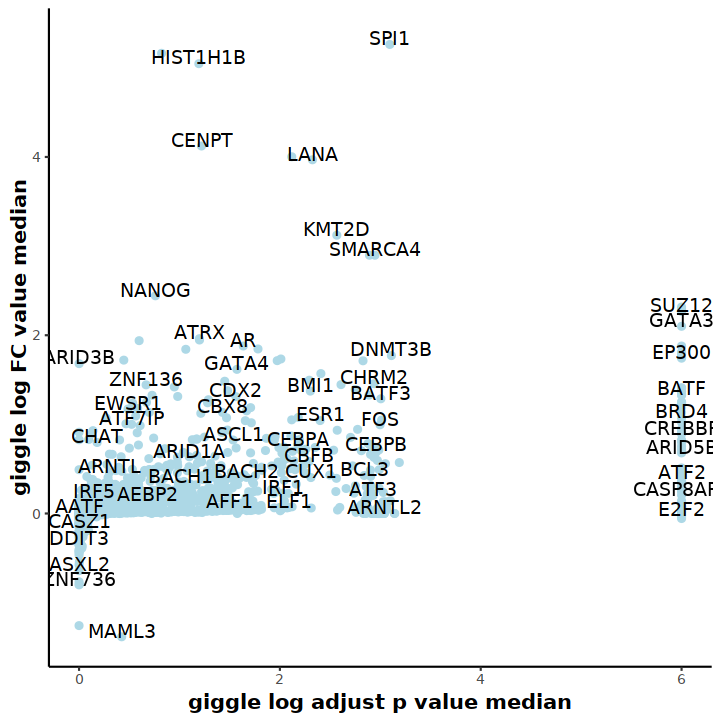

In [118]:
# P vs fc
ov_table <- merge(giggle_p,giggle_fc,by = "name")
colnames(ov_table) <- c("name", "giggle_adjust_p_value_median", "giggle_log_fc_value_median")
ov_table <- as.data.frame(ov_table)

ggplot(ov_table, aes(x = giggle_adjust_p_value_median, y = giggle_log_fc_value_median)) +
geom_point(color="light blue")+
geom_text(aes(y = giggle_log_fc_value_median + .07, label = name), check_overlap=T)+
scale_colour_brewer(palette = "Set1")+
xlab("giggle log adjust p value median") + 
ylab("giggle log FC value median")+
theme_classic(base_size = 10) +
theme(axis.title.x = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5), 
      axis.title.y = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5))

#### umap on factor

In [ ]:
options(repr.plot.width=6, repr.plot.height=6)
for (i in head(C_G_overlap)) {
    fig <- FeaturePlot(object = p_result$ATAC, feature=i)
    show(fig)
    fig <- FeaturePlot(object = chromVAR_result$ATAC, feature=i)
    show(fig)
}

In [92]:
markerTFlist <- c("BCL11A", "BCL11B")

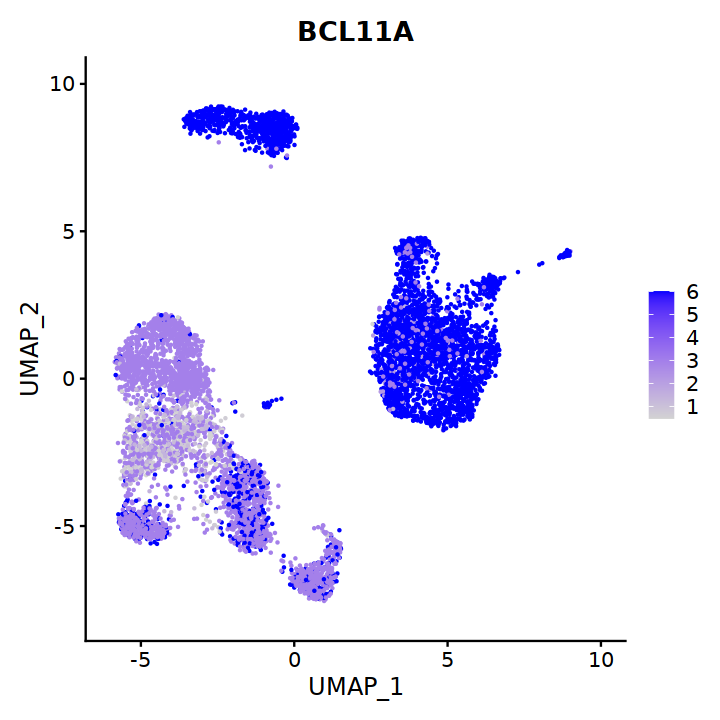

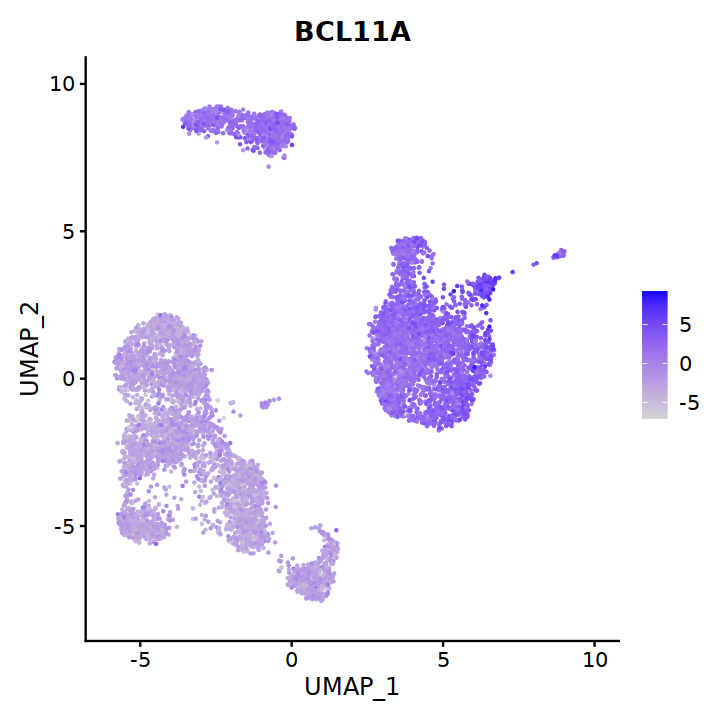

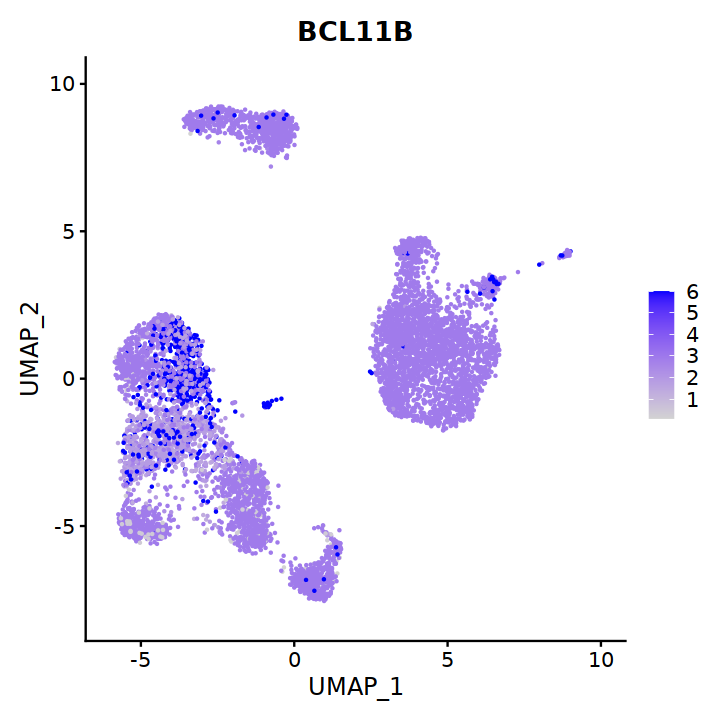

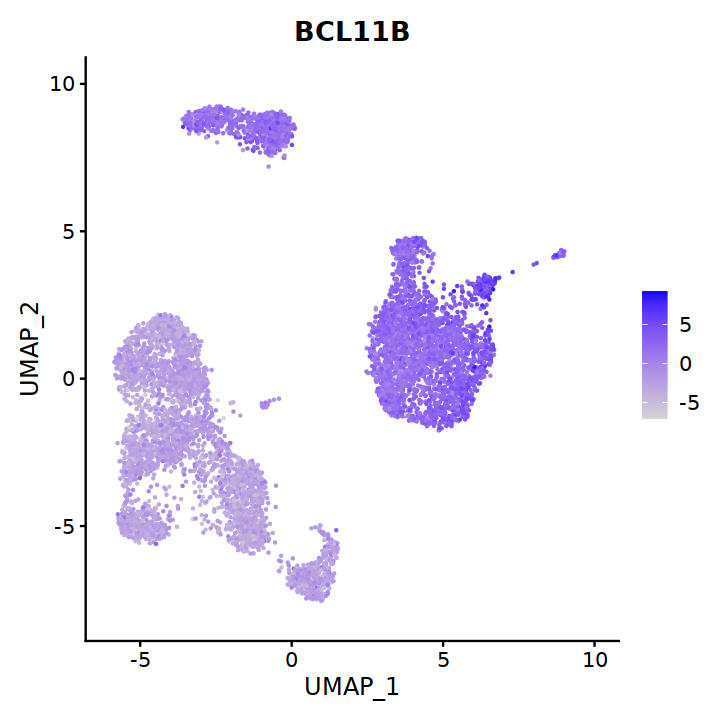

In [93]:
for (i in markerTFlist) {
    fig <- FeaturePlot(object = p_result$ATAC, feature=i)
    show(fig)
    fig <- FeaturePlot(object = chromVAR_result$ATAC, feature=i)
    show(fig)
}

In [83]:
p_result

$ATAC
An object of class Seurat 
102895 features across 7573 samples within 2 assays 
Active assay: ACTIVITY (42393 features, 2000 variable features)
 1 other assay present: ATAC
 2 dimensional reductions calculated: lsi, umap

$peaks
              p_val  avg_logFC pct.1 pct.2     p_val_adj cluster
1     1.964923e-120  0.5852602 0.337 0.100 1.188817e-115       0
2     7.628627e-118  0.5556964 0.338 0.102 2.307736e-113       0
3     2.158844e-109  0.5486518 0.345 0.113 4.353812e-105       0
4     1.526983e-103  0.5346281 0.333 0.110  2.309637e-99       0
5      2.623207e-97  0.5375795 0.366 0.138  3.174185e-93       0
6      2.672385e-96  0.5167901 0.279 0.083  2.694744e-92       0
7      7.736592e-96  0.5133011 0.328 0.114  6.686847e-92       0
8      1.610648e-94  0.4982463 0.285 0.088  1.218093e-90       0
9      1.236374e-88 -0.6356058 0.045 0.329  8.311453e-85       0
10     4.131058e-88  0.5189848 0.300 0.103  2.499373e-84       0
11     1.038896e-86  0.4932365 0.299 0.101  5.7141

### correlation

#### correlation by TF

In [392]:
pbmc.rp <- chromVAR_result$ATAC@assays$ACTIVITY@counts
# pbmc.chromvar <- chromVAR_result$ATAC@meta.data[,12:length(chromVAR_result$ATAC@meta.data)]
# pbmc.clusters.info <- chromVAR_result$ATAC@meta.data["assign.ident"]
# pbmc.p.giggle <- p_result$ATAC@meta.data[,11:length(p_result$ATAC@meta.data)]

,Row.names,orig.ident,nCount_ATAC,nFeature_ATAC,ATAC_snn_res.0.6,seurat_clusters,nCount_ACTIVITY,nFeature_ACTIVITY,assign.ident,assign.score,⋯,PBX4,NKX62,HOXA4,CR8477943,RORB,SMAD5,SMAD9,SOX6,TBX18,TBX22
,<I<chr>>,<fct>,<dbl>,<int>,<fct>,<fct>,<dbl>,<int>,<chr>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AAACGAAAGACACGGT,AAACGAAAGACACGGT,atac_pbmc_10k_v1_S1_L001,3026,3026,5,5,3597.6226,7184,CD4Tconv,0.11724116,⋯,1.46187756,1.757008150,0.2082414,1.34574250,-0.95256063,-0.01529903,0.37158306,0.69474744,1.388720604,1.388720604
AAACGAAAGAGGTGGG,AAACGAAAGAGGTGGG,atac_pbmc_10k_v1_S1_L001,2517,2517,6,6,2589.4861,7848,Mono/Macro,0.76535819,⋯,-0.24746565,-0.681658816,1.5236184,-0.15182603,0.21053919,-0.30224089,0.03266092,0.13309098,1.115080162,1.115080162
AAACGAAAGCACGTAG,AAACGAAAGCACGTAG,atac_pbmc_10k_v1_S1_L001,3317,3317,6,6,3401.6051,9881,Mono/Macro,0.76535819,⋯,-0.28734606,-0.214971306,0.1188281,0.42821675,1.65750622,-0.24521951,-0.01021797,-0.67854030,-0.370345238,-0.370345238
AAACGAAAGCGCCTAC,AAACGAAAGCGCCTAC,atac_pbmc_10k_v1_S1_L001,2980,2980,0,0,3077.3342,9085,Mono/Macro,1.03903755,⋯,0.01029806,-0.199101551,-1.0974149,-0.32175689,0.20108214,-0.72589237,-1.24646219,-0.66358223,1.540715021,1.540715021
AAACGAAAGCTTTCCC,AAACGAAAGCTTTCCC,atac_pbmc_10k_v1_S1_L001,2993,2993,5,5,3433.1439,7361,CD4Tconv,0.11724116,⋯,0.33258378,1.316428820,0.2187901,-0.95163922,-0.48262695,-0.70653053,0.01016004,-0.91315084,-0.093401875,-0.093401875
AAACGAAAGGCGTCCT,AAACGAAAGGCGTCCT,atac_pbmc_10k_v1_S1_L001,2761,2761,1,1,3256.2735,6692,CD4Tconv,0.04945659,⋯,-0.18650476,0.157821729,0.2351621,1.08042475,0.55862897,0.93867457,-0.16415718,-0.15890190,-0.011575300,-0.011575300
AAACGAAAGGCTTTAC,AAACGAAAGGCTTTAC,atac_pbmc_10k_v1_S1_L001,3310,3310,6,6,3463.2474,9491,Mono/Macro,0.76535819,⋯,-0.86152886,-0.512930494,-0.6096800,0.53661862,-0.96719263,-0.22238137,0.27929527,-0.62421458,-1.057322101,-1.057322101
AAACGAAAGTGATATG,AAACGAAAGTGATATG,atac_pbmc_10k_v1_S1_L001,4532,4532,2,2,4618.3482,12254,Mono/Macro,1.20321468,⋯,0.19769006,-1.139406645,0.8390388,0.05230764,2.04482043,-0.90579287,-0.21945969,0.05355105,-0.876998497,-0.876998497
AAACGAAAGTTTGGAA,AAACGAAAGTTTGGAA,atac_pbmc_10k_v1_S1_L001,581,581,5,5,733.7765,1483,CD4Tconv,0.11724116,⋯,0.01785148,0.475966056,0.6183203,-0.10952895,0.61431388,-0.95423993,-0.62630928,0.21358681,0.407102980,0.407102980


In [168]:
p_result$ATAC@meta.data[,11:length(p_result$ATAC@meta.data)]

,AATF,ADNP,AEBP2,AFF1,AFF4,AGO1,AGO2,AHR,AHRR,ALKBH3,⋯,ZSCAN22,ZSCAN23,ZSCAN29,ZSCAN31,ZSCAN5A,ZSCAN5B,ZTA,ZXDB,ZXDC,ZZZ3
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AAACGAAAGACACGGT,-0.44691793,0.16087543,-0.30389111,0.63562409,0.04586575,-0.52819945,-0.15863858,-0.771596756,-0.81767374,-0.808387438,⋯,0.02487905,-0.4621325,0.12962021,-0.64169119,0.40189180,-0.18900572,-0.88160535,-0.1828385,-0.8875449,-0.7780372
AAACGAAAGAGGTGGG,-0.39079764,-0.34844335,-0.41517824,-0.42582343,-0.45590507,-0.45591585,-0.18734862,-0.250245679,-0.43285413,-0.429195219,⋯,-0.45591588,-0.4559159,-0.45583495,-0.45398505,-0.45586110,-0.45571894,-0.35860885,-0.4559159,-0.4513923,-0.3768918
AAACGAAAGCACGTAG,-0.44764669,-0.42534648,-0.44928177,-0.32315797,-0.44976972,-0.44977073,-0.39284970,0.037337211,-0.44612937,-0.449728568,⋯,-0.44977113,-0.4497711,-0.44888982,-0.40527652,-0.44976350,-0.44948955,0.60272264,-0.4497711,-0.4497618,-0.4473915
AAACGAAAGCGCCTAC,-0.48791254,-0.48206313,-0.48865321,-0.47979710,-0.48866608,-0.48867228,-0.46269923,0.486277047,-0.48842035,-0.488672269,⋯,-0.48867228,-0.4886723,-0.48407258,-0.48866022,-0.48867219,-0.48867060,2.45222564,-0.4886723,-0.4885323,-0.4846037
AAACGAAAGCTTTCCC,-0.75895406,-0.33003523,-0.42016313,0.64448655,-0.14779992,-0.14632138,-0.58106666,-0.826766866,-0.55171574,-0.661036995,⋯,0.65474815,-0.5749188,0.66873063,-0.85112080,0.55751812,-0.69754967,-0.83327483,0.5374661,-0.8629391,-0.5343487
AAACGAAAGGCGTCCT,-0.92641595,-0.47941385,0.88319732,0.78482732,1.87597509,0.25277145,-0.45975299,-1.028511546,-0.57718194,-0.736752243,⋯,1.44004862,0.2411234,-0.13189989,-1.02543460,0.78595962,-0.91925077,-0.91428190,1.7830413,-0.4225996,-0.7920398
AAACGAAAGGCTTTAC,-0.47324544,-0.47415684,-0.48938625,-0.40986615,-0.48947951,-0.48947964,-0.44256254,-0.004264448,-0.48632196,-0.489479216,⋯,-0.48947967,-0.4894797,-0.46839432,-0.48947223,-0.48926718,-0.45297912,1.74727066,-0.4894797,-0.4894457,-0.4894796
AAACGAAAGTGATATG,-0.42983504,-0.42075521,-0.50235616,-0.25176666,-0.50235209,-0.50235616,-0.38430612,0.031673118,-0.50235557,-0.502329781,⋯,-0.50235616,-0.5023562,-0.50176538,-0.50235613,-0.50225368,-0.50223003,2.50103030,-0.5023562,-0.5023561,-0.4973636
AAACGAAAGTTTGGAA,0.34509502,-0.15162514,0.12815208,-0.16114641,1.04062971,-0.58531934,-0.11226445,-1.068141908,-1.08265924,-0.402231641,⋯,0.51472760,-0.6524284,-0.83040613,-0.84437093,0.32092971,-0.76748624,-0.89536318,1.0366179,-1.0592369,-0.6660581


In [434]:
rp_table <- as.matrix(t(pbmc.rp[C_G_overlap,]))
giggle_table <- pbmc.p.giggle[,C_G_overlap]
chromVar_table <- pbmc.chromvar[,C_G_overlap]

In [398]:
rp_table

,SPIB,CEBPA,SPI1,CEBPB,CEBPD,JUNB,FOS,FOSL1,JUND,SMARCC1,⋯,KLF15,ZNF263,DNMT1,KLF5,WT1,ZBTB7A,SP1,MAZ,ZFX,SP2
AAACGAAAGACACGGT,0.000000000,0.0000000000,0.0000000,0.000000000,0.000000e+00,0.0000000000,1.840829e+00,0.0000000000,0.000000e+00,0.6051858,⋯,0.000000000,9.738685e-01,0.0279807802,0.0000000,0,0.899378300,0.994125545,0.0000000000,0.0000000,1.1013215780
AAACGAAAGAGGTGGG,0.000000000,0.9844569564,1.5110829,0.511247456,0.000000e+00,1.4496961832,1.041063e+00,0.0000000000,1.236807e+00,0.0000000,⋯,0.000000000,9.174569e-05,0.0000000000,0.0000000,0,0.000000000,1.082238674,0.9659363031,0.0000000,0.0001345799
AAACGAAAGCACGTAG,0.004614692,0.1413114220,0.0000000,0.513670444,4.488435e-04,0.5391841531,7.206897e-01,0.9996912479,1.847252e-03,0.0000000,⋯,0.000000000,0.000000e+00,0.0085901553,0.2804262,0,0.931030273,1.537719011,0.0000000000,0.0000000,1.1014561653
AAACGAAAGCGCCTAC,0.004614692,0.0000000000,0.0000000,0.511247456,4.591368e-01,1.7612873316,7.240574e-01,0.0000000000,1.472416e+00,0.0000000,⋯,0.000000000,0.000000e+00,0.0085901553,0.0000000,0,0.599092245,0.694115877,0.0000000000,0.0000000,1.1013215780
AAACGAAAGCTTTCCC,0.000000000,0.0007207068,0.0000000,0.000000000,0.000000e+00,2.3107378483,2.051392e+00,0.0000000000,9.866772e-01,0.0000000,⋯,0.000000000,0.000000e+00,0.0000000000,0.0000000,0,0.005347944,0.994125545,0.0007452696,0.0000000,1.1013215780
AAACGAAAGGCGTCCT,0.000000000,0.0000000000,0.0000000,0.000000000,0.000000e+00,1.9394099712,9.025946e-01,0.9994802475,4.038104e-01,0.0000000,⋯,0.000000000,0.000000e+00,0.0000000000,0.0000000,0,0.000000000,0.150522396,0.0006737495,0.0000000,0.0001345799
AAACGAAAGGCTTTAC,0.000000000,0.0000000000,0.6828276,0.511247456,6.957845e-05,0.9105120301,9.043928e-01,0.9257214069,1.601557e+00,0.0000000,⋯,0.000344144,0.000000e+00,0.0000000000,0.0000000,0,0.395856649,1.537719011,0.0000000000,0.0000000,1.1013215780
AAACGAAAGTGATATG,0.000000000,1.5681817532,0.9996830,0.006891117,4.591368e-01,0.9105120301,1.738101e+00,0.9994802475,1.476160e+00,0.1568628,⋯,0.000000000,0.000000e+00,0.9825735688,0.0000000,0,0.887423694,0.631706536,0.8834068775,0.0000000,0.0001345799
AAACGAAAGTTTGGAA,0.000000000,0.0000000000,0.0000000,0.000000000,0.000000e+00,0.5594697595,0.000000e+00,0.0000000000,0.000000e+00,0.0000000,⋯,0.000000000,0.000000e+00,0.0000000000,0.0000000,0,0.000000000,0.000000000,0.0000000000,0.0000000,0.0000000000
AAACGAACAAACGACG,0.000000000,0.0000000000,0.0000000,0.048351351,0.000000e+00,0.5494505763,0.000000e+00,0.0000000000,3.859881e-02,0.0000000,⋯,0.000000000,0.000000e+00,0.0000000000,0.0000000,0,0.000000000,0.001665937,0.0522744581,0.0000000,0.0000000000


In [403]:
C_G_overlap <- head(colnames(rp_table)[order(apply(rp_table, 2, sd), decreasing = T)], 200)

In [382]:
factor_name <- colnames(rp_table)[order(colSums(rp_table),decreasing = T)]

In [385]:
C_G_overlap <- head(factor_name, 200)

In [387]:
giggle_table

,FOS,MNT,JUNB,EGR1,JUND,FOXO3,SP1,MYC,KLF13,FOSL2,⋯,CREB3L4,ELF1,HOXA1,GFI1B,RUNX2,ELK3,ELK4,JDP2,MECP2,VDR
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AAACGAAAGACACGGT,0.66982124,-0.81968623,-0.41187003,2.1739906,-0.44218494,1.5315450,3.2943669,4.11293655,-0.3153959,-0.5896834,⋯,-0.7885168,1.6400453,-0.6611132,-0.364304328,-0.8674405,-0.8823438,-0.123565807,-0.82396612,-0.61675537,-0.82044692
AAACGAAAGAGGTGGG,2.83281011,-0.43563216,1.63667864,-0.4558730,1.37998786,-0.3337513,-0.3635069,-0.01192491,-0.4559159,1.9335539,⋯,-0.4559154,-0.4558285,-0.4559159,-0.399921321,-0.2253870,-0.4559159,-0.260856636,-0.43770621,-0.45588002,4.15179500
AAACGAAAGCACGTAG,3.58227256,-0.43167364,2.04346981,-0.4497711,1.20508836,0.2258642,-0.4001283,-0.13990033,-0.4497711,2.3881426,⋯,-0.4496548,-0.4474083,-0.4497711,-0.447093056,-0.1206706,-0.4497711,-0.442652193,-0.41826982,-0.44977089,3.62752305
AAACGAAAGCGCCTAC,2.72731218,-0.48866759,2.72731218,-0.4886717,2.72731218,-0.4036013,-0.4834389,-0.46054530,-0.4886723,2.7273122,⋯,-0.4886678,-0.4886723,-0.4886723,-0.473633221,0.6232333,-0.4886723,-0.488628943,-0.42997680,-0.48867228,2.72731158
AAACGAAAGCTTTCCC,1.67493239,-0.62757326,0.31268024,2.9325504,-0.41516225,0.6561914,3.4704533,3.38451704,-0.4845323,-0.8703142,⋯,-0.6954074,1.6747620,-0.1194434,-0.301276270,-0.8819624,-0.8181478,0.486193662,-0.85720492,-0.63195344,-0.54135024
AAACGAAAGGCGTCCT,1.96169423,1.76757343,-0.01793252,1.6009023,0.65529251,1.4232018,1.9645136,1.96434020,1.6825025,-0.9929842,⋯,1.1150014,1.9644957,1.9355841,0.207672319,-0.9170345,0.6458183,0.964052420,-1.01285113,1.15566301,0.65748727
AAACGAAAGGCTTTAC,2.93899759,-0.46628606,2.93899759,-0.4894437,2.93830916,-0.1677255,-0.3870170,-0.45288064,-0.4894797,2.9389730,⋯,-0.4886662,-0.4893860,-0.4894797,-0.484787043,-0.1967834,-0.4894797,-0.489263845,-0.20341121,-0.48947967,2.93899603
AAACGAAAGTGATATG,2.52297594,-0.50235605,2.52297594,-0.5023561,2.52297594,-0.1115478,-0.5023392,0.03625857,-0.5023562,2.5229759,⋯,-0.5023562,-0.5013001,-0.5023562,-0.347089517,0.5534780,-0.5023562,-0.501907518,0.08981388,-0.50235616,2.52297594
AAACGAAAGTTTGGAA,1.38271659,-0.41724993,-0.36973906,0.9781972,1.06480721,0.4829340,2.6696686,2.36096842,0.6916027,-0.9443337,⋯,-0.6673820,2.6790797,1.4360795,0.009291086,-1.0944664,0.6973851,1.557350067,-0.89158494,-0.42197437,0.44498051


In [171]:
chromVar_table

,SPIB,CEBPA,SPI1,CEBPB,CEBPD,JUNB,FOS,FOSL1,JUND,SMARCC1,⋯,KLF15,ZNF263,DNMT1,KLF5,WT1,ZBTB7A,SP1,MAZ,ZFX,SP2
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AAACGAAAGACACGGT,-5.98925312,-1.194135,-3.2466744,-2.971350,-1.4862577,-5.5549782,-5.7416837,-5.4382219,-5.07948487,-5.9330585,⋯,0.046931528,-0.42462621,1.79731648,-0.36261849,0.422413830,0.059314353,0.103899592,-0.79636831,-0.32355381,-0.35256481
AAACGAAAGAGGTGGG,6.26073513,2.541959,3.2737598,0.922979,2.5014029,-1.2970151,-0.4428561,-1.3499901,-0.87195860,-0.8159156,⋯,-0.480281329,-1.01985120,-0.81525496,0.85294481,-0.465684092,-0.368375406,-0.306573614,-0.40818682,0.04854069,0.21624349
AAACGAAAGCACGTAG,5.02100940,3.450112,3.9933931,2.149489,2.6882246,3.8555568,3.4253670,3.3995952,4.20163205,2.4728693,⋯,-1.783239510,0.25435278,-0.07320018,-0.09761333,0.040909308,-0.810099645,-0.481687878,-0.02659117,0.35815146,0.20953275
AAACGAAAGCGCCTAC,3.72942183,3.495277,3.9907281,2.657021,1.9280522,5.6570924,5.2151932,6.1514704,5.57205066,6.2286099,⋯,-1.262178707,1.93523129,-0.04746410,-0.11076109,-1.039290747,-0.043457290,-0.588274348,0.19879153,0.50550330,-0.54245879
AAACGAAAGCTTTCCC,-5.92975004,-3.461371,-3.2102284,-2.673419,-2.5260883,-2.8163330,-3.1814832,-2.9126228,-2.93433386,-3.0022152,⋯,-0.624180046,0.11743346,-0.58659306,-0.25272989,0.029521600,-0.944349886,0.018620002,0.18298319,-1.50492097,-0.25853906
AAACGAAAGGCGTCCT,-4.78385564,-2.964575,-3.5937681,-2.310251,-0.4731418,-2.5899576,-2.7848057,-2.8117361,-2.82733239,-2.5852100,⋯,-0.001088546,-0.11824708,0.55672700,0.33647756,0.258509094,0.559015927,-0.080312638,-1.16551360,-1.05308638,-0.19023979
AAACGAAAGGCTTTAC,5.61683944,5.230197,3.0169442,2.606033,3.6440078,0.4413507,0.9757705,0.4049897,0.74069537,0.8384390,⋯,0.628315612,1.25316597,-0.10918785,0.57548100,0.288722768,0.457038635,0.107601330,0.07916545,0.54517629,0.13055871
AAACGAAAGTGATATG,6.84785091,5.337945,5.7125618,5.488330,3.5440254,3.3151440,3.9855587,3.7267360,3.98003793,2.9969499,⋯,-1.116212421,0.54703779,0.34392860,-0.52199740,-1.159620093,0.371501626,-0.314122068,1.24557806,0.43055043,-0.95352895
AAACGAAAGTTTGGAA,-0.11441894,-1.990372,-0.3033604,-2.433471,-1.1994113,0.3318376,-0.4106809,-0.5064980,0.31363087,0.1434412,⋯,0.021423477,-0.27104763,-0.94530026,-0.51649699,0.394216879,-0.009408009,-0.721743977,-1.10666272,-1.11736449,-0.12060020


In [132]:
cor.test(rp_table[,'BCL11B'],chromVar_table[,'BCL11B'])$estimate

cor 
-0.3778581

In [133]:
cor.test(rp_table[,'BCL11B'],chromVar_table[,'BCL11B'])$p.value

[1] 1.293401e-255

In [131]:
cor.test(rp_table[,'BCL11B'],giggle_table[,'BCL11B'])$estimate

cor 
0.1740033

In [130]:
cor.test(rp_table[,'BCL11B'],giggle_table[,'BCL11B'])$p.value

[1] 1.494843e-52

In [435]:
cor_table <- data.frame(factor=c(), type=c(), correlation=c())
for (tf in C_G_overlap){
        chromvar_correlation_value <- cor.test(rp_table[,tf], chromVar_table[,tf],method = "spearman")
#         chromvar_mean_tf <- mean(chromVar_table[barcode,tf])
        giggle_correlation_value <- cor.test(rp_table[,tf], giggle_table[,tf], method = "spearman")
#         giggle_mean_tf <- mean(giggle_table[barcode,tf])
        correlation <- cor.test(chromVar_table[,tf], giggle_table[,tf],method = "spearman")
        if (is.na(chromvar_correlation_value$estimate) | is.na(giggle_correlation_value$estimate)){
            next
        } else {
            cor_table <- rbind(cor_table, data.frame(factor=c(tf, tf, tf), type=c("chromVAR", "GIGGLE", 'both'), 
                                                 correlation=c(chromvar_correlation_value$estimate, giggle_correlation_value$estimate, correlation$estimate), 
                                                 p=c(chromvar_correlation_value$p.value, chromvar_correlation_value$p.value, correlation$p.value)))
#           cor_table <- rbind(cor_table, data.frame(cluster=clu, factor=tf, type="GIGGLE", correlation=giggle_correlation_value))
        }
    }




Warning message in cor.test.default(rp_table[, tf], chromVar_table[, tf], method = "spearman"):
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(rp_table[, tf], giggle_table[, tf], method = "spearman"):
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(chromVar_table[, tf], giggle_table[, tf], method = "spearman"):
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(rp_table[, tf], chromVar_table[, tf], method = "spearman"):
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(rp_table[, tf], giggle_table[, tf], method = "spearman"):
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(chromVar_table[, tf], giggle_table[, tf], method = "spearman"):
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(rp_table[, tf], chromVar_table[, tf], method = "spearman"):
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(r

In [149]:
cor_table

factor,type,correlation,p
<chr>,<chr>,<dbl>,<dbl>
SPIB,chromVAR,0.213701011,6.075026e-79
SPIB,GIGGLE,0.190485784,6.075026e-79
CEBPA,chromVAR,0.335002588,5.423839e-198
CEBPA,GIGGLE,0.275238307,5.423839e-198
SPI1,chromVAR,0.386957301,5.015678e-269
SPI1,GIGGLE,0.313049928,5.015678e-269
CEBPB,chromVAR,0.136789569,5.888064e-33
CEBPB,GIGGLE,0.080173548,5.888064e-33
CEBPD,chromVAR,0.281990099,1.952677e-138


In [176]:
cor_table

factor,type,correlation,p
<chr>,<chr>,<dbl>,<dbl>
SPIB,chromVAR,0.211257710,3.768926e-77
SPIB,GIGGLE,0.146932317,3.768926e-77
SPIB,both,0.754958284,0.000000e+00
CEBPA,chromVAR,0.369072104,4.570696e-243
CEBPA,GIGGLE,0.261173399,4.570696e-243
CEBPA,both,0.306703844,1.153027e-164
SPI1,chromVAR,0.421993257,0.000000e+00
SPI1,GIGGLE,0.269176275,0.000000e+00
SPI1,both,0.696384406,0.000000e+00


In [79]:
cor_table$log.padj.p <- -log10(cor_table$adj.p)

In [177]:
plt.data <- cor_table[which(cor_table$type == 'both'),]
plt.data$adj.p <- p.adjust(plt.data$p)
plt.data$log.padj.p <- -log10(plt.data$adj.p)

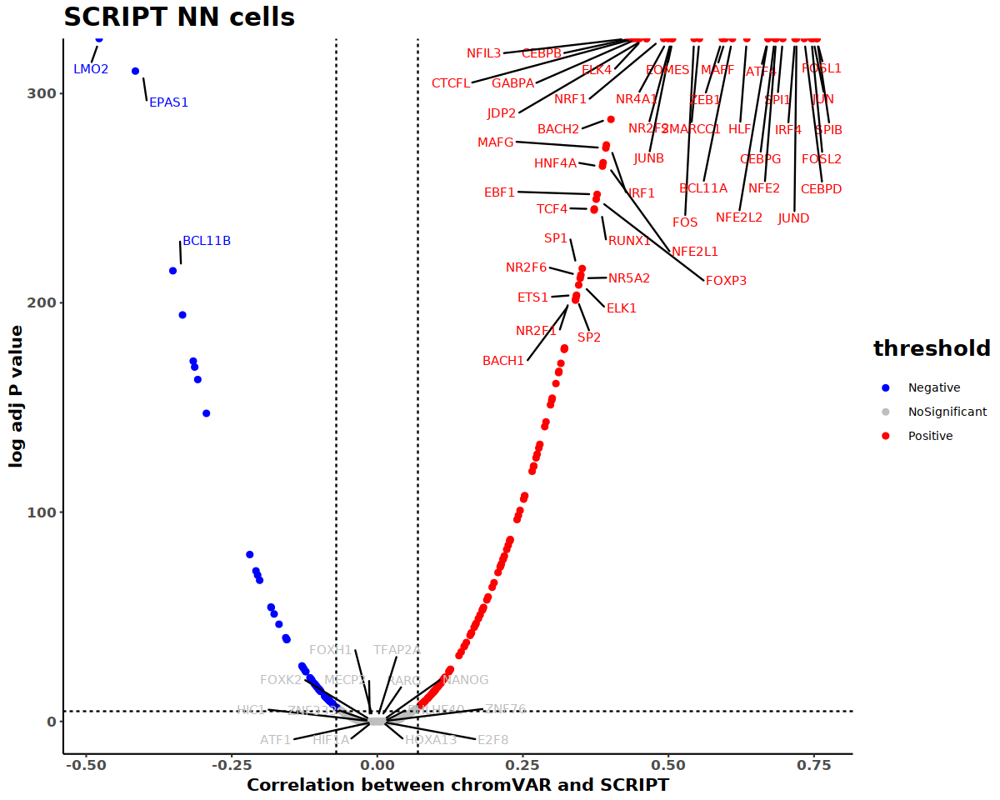

In [186]:
# cluster_setting <- 3
# for (i in seq(0,13)){
#     cluster_setting <- 10
    correlation_threshold <- 0.07
    p_threshold <- 5

    
    plt.data$threshold = as.factor(ifelse(plt.data$log.padj.p > p_threshold & abs(plt.data$correlation) >= correlation_threshold, 
                                          ifelse(plt.data$correlation > correlation_threshold ,'Positive','Negative'),'NoSignificant'))


    options(repr.plot.width=10, repr.plot.height=8)
    p <- ggplot(plt.data, aes(x=correlation, y=log.padj.p, color = threshold, label=factor))+
    geom_point()+
    scale_color_manual(values=c("blue", "grey","red"))+
#     geom_text(data = subset(plt.data, plt.data$log.padj.p <= p_threshold | abs(plt.data$correlation) <= correlation_threshold), 
#               aes(y = p_threshold + .07, label = factor), check_overlap=T)+
    geom_vline(xintercept=c(-correlation_threshold, correlation_threshold), color = "black", linetype="dashed")+ 
    geom_hline(yintercept=p_threshold, color = "black", linetype="dashed")+
#     labs(x="Correlation with Mean RP",y="log adj P value", title='SCRIPT NN cells')+ 
    labs(x="Correlation between chromVAR and SCRIPT",y="log adj P value", title='SCRIPT NN cells')+ 
    theme_classic(base_size = 10) +
    theme(axis.title.x = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5), 
          axis.title.y = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5),
          title = element_text(size = 15, face = "bold", vjust = 2, hjust = 0.5),
          axis.text = element_text(size = 10, face = "bold"),
         )+
    geom_text_repel(
            data = subset(plt.data, plt.data$log.padj.p > 200 & abs(plt.data$correlation) >= correlation_threshold),
            aes(label = factor),
            size = 3,
            box.padding = unit(0.5, "lines"),
            point.padding = unit(0.8, "lines"), segment.color = "black", show.legend = FALSE)+
    geom_text_repel(
            data = subset(plt.data, plt.data$log.padj.p < p_threshold & abs(plt.data$correlation) <= 0.005),
            aes(label = factor),
            size = 3,
            box.padding = unit(0.5, "lines"),
            point.padding = unit(0.8, "lines"), segment.color = "black", show.legend = FALSE)
  show(p)  
# }

In [436]:
cor_table <- data.frame(factor=c(), chromVAR_correlation_with_RP=c(), chromVAR_correlation_p = c(),  SCRIPT_correlation_with_RP=c(),  SCRIPT_correlation_p = c())
for (tf in C_G_overlap){
        chromvar_correlation_value <- cor.test(rp_table[,tf], chromVar_table[,tf],method = "spearman")
#         chromvar_mean_tf <- mean(chromVar_table[barcode,tf])
        giggle_correlation_value <- cor.test(rp_table[,tf], giggle_table[,tf], method = "spearman")
#         giggle_mean_tf <- mean(giggle_table[barcode,tf])
#         correlation <- cor.test(chromVar_table[,tf], giggle_table[,tf],method = "spearman")
        if (is.na(chromvar_correlation_value$estimate) | is.na(giggle_correlation_value$estimate)){
            next
        } 
        else {
            if (is.na(chromvar_correlation_value$p.value > 0.05) | is.na(giggle_correlation_value$p.value > 0.05)){
                next
            }else{
            cor_table <- rbind(cor_table, data.frame(factor=c(tf), chromVAR_correlation_with_RP=c(chromvar_correlation_value$estimate), chromVAR_correlation_p=chromvar_correlation_value$p.value, 
                                                 SCRIPT_correlation_with_RP=c(giggle_correlation_value$estimate), SCRIPT_correlation_p = giggle_correlation_value$p.value))
#           cor_table <- rbind(cor_table, data.frame(cluster=clu, factor=tf, type="GIGGLE", correlation=giggle_correlation_value))
        }
        }
    }

Warning message in cor.test.default(rp_table[, tf], chromVar_table[, tf], method = "spearman"):
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(rp_table[, tf], giggle_table[, tf], method = "spearman"):
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(rp_table[, tf], chromVar_table[, tf], method = "spearman"):
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(rp_table[, tf], giggle_table[, tf], method = "spearman"):
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(rp_table[, tf], chromVar_table[, tf], method = "spearman"):
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(rp_table[, tf], giggle_table[, tf], method = "spearman"):
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(rp_table[, tf], chromVar_table[, tf], method = "spearman"):
“Cannot compute exact p-value with ties”
Warning message in cor.test.default(rp_table[, 

In [431]:
cor_table <- cor_table[which(cor_table$chromVAR_correlation_p < 0.05 & cor_table$SCRIPT_correlation_p < 0.05),]

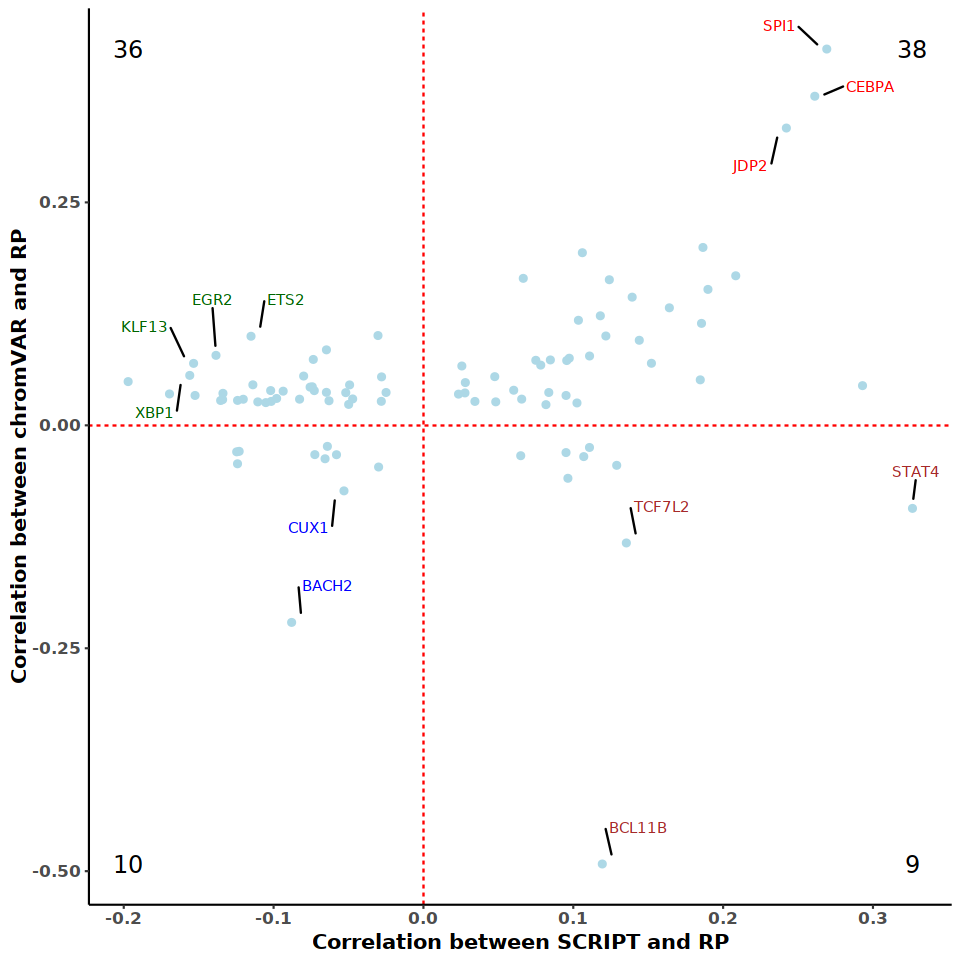

In [432]:
SCRIPT_cutoff = 0
chromVAR_cutoff = 0
options(repr.plot.width=8, repr.plot.height=8)
p <- ggplot(cor_table, aes(x=SCRIPT_correlation_with_RP, y=chromVAR_correlation_with_RP))+
geom_point(color='light blue')+
#     scale_color_manual(values=c("blue", "grey","red"))+
geom_text(aes(x=max(SCRIPT_correlation_with_RP), y = max(chromVAR_correlation_with_RP), 
              label = nrow(subset(cor_table, SCRIPT_correlation_with_RP >= SCRIPT_cutoff & chromVAR_correlation_with_RP >= chromVAR_cutoff))), check_overlap=T, size=5)+
geom_text(aes(x=min(SCRIPT_correlation_with_RP), y = max(chromVAR_correlation_with_RP), 
              label = nrow(subset(cor_table, SCRIPT_correlation_with_RP <= SCRIPT_cutoff & chromVAR_correlation_with_RP >= chromVAR_cutoff))), check_overlap=T, size=5)+
geom_text(aes(x=min(SCRIPT_correlation_with_RP), y = min(chromVAR_correlation_with_RP), 
              label = nrow(subset(cor_table, SCRIPT_correlation_with_RP <= SCRIPT_cutoff & chromVAR_correlation_with_RP <= chromVAR_cutoff))), check_overlap=T, size=5)+
geom_text(aes(x=max(SCRIPT_correlation_with_RP), y = min(chromVAR_correlation_with_RP), 
              label = nrow(subset(cor_table, SCRIPT_correlation_with_RP >= SCRIPT_cutoff & chromVAR_correlation_with_RP <= chromVAR_cutoff))), check_overlap=T, size=5)+
geom_vline(xintercept=SCRIPT_cutoff, color = "red", linetype="dashed")+ 
geom_hline(yintercept=chromVAR_cutoff, color = "red", linetype="dashed")+
# #     labs(x="Correlation with Mean RP",y="log adj P value", title='SCRIPT NN cells')+ 
labs(x="Correlation between SCRIPT and RP",y="Correlation between chromVAR and RP")+ 
theme_classic(base_size = 10) +
theme(axis.title.x = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5), 
      axis.title.y = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5),
      title = element_text(size = 15, face = "bold", vjust = 2, hjust = 0.5),
      axis.text = element_text(size = 10, face = "bold"),
     )+
geom_text_repel(
        data = subset(cor_table, cor_table$SCRIPT_correlation_with_RP > 0.2 & cor_table$chromVAR_correlation_with_RP >= 0.2),
        aes(label = factor),
        size = 3,
        color= 'red',
        box.padding = unit(0.5, "lines"),
        point.padding = unit(0.8, "lines"), segment.color = "black", show.legend = FALSE)+
geom_text_repel(
        data = subset(cor_table, cor_table$SCRIPT_correlation_with_RP < -0.05 & cor_table$chromVAR_correlation_with_RP < -0.05),
        aes(label = factor),
        size = 3,
        color= 'blue',
        box.padding = unit(0.5, "lines"),
        point.padding = unit(0.8, "lines"), segment.color = "black", show.legend = FALSE)+
geom_text_repel(
        data = subset(cor_table, cor_table$SCRIPT_correlation_with_RP < -0.1 & cor_table$chromVAR_correlation_with_RP >= 0.05),
        aes(label = factor),
        size = 3,
        color= 'dark green',
        box.padding = unit(0.5, "lines"),
        point.padding = unit(0.8, "lines"), segment.color = "black", show.legend = FALSE)+
geom_text_repel(
        data = subset(cor_table, cor_table$SCRIPT_correlation_with_RP > 0.1 & cor_table$chromVAR_correlation_with_RP <= -0.05),
        aes(label = factor),
        size = 3,
        color= 'brown',
        box.padding = unit(0.5, "lines"),
        point.padding = unit(0.8, "lines"), segment.color = "black", show.legend = FALSE)
show(p)  

In [232]:
nrow(subset(cor_table, cor_table$SCRIPT_correlation_with_RP >= 0 & cor_table$chromVAR_correlation_with_RP >= 0))

[1] 116

In [35]:
rp_table <- as.matrix(t(pbmc.rp[C_G_overlap,]))
giggle_table <- pbmc.p.giggle[,C_G_overlap]
chromVar_table <- pbmc.chromvar[,C_G_overlap]

cor_table <- data.frame(cluster=c(), factor=c(), type=c(), correlation=c())
for (clu in unique(pbmc.clusters.info)$seurat_clusters){
    barcode <- rownames(pbmc.clusters.info)[which(pbmc.clusters.info==clu)]
    for (tf in C_G_overlap){
        chromvar_correlation_value <- cor(rp_table[barcode,tf], chromVar_table[barcode,tf],method = "spearman")
        chromvar_mean_tf <- mean(chromVar_table[barcode,tf])
        giggle_correlation_value <- cor(rp_table[barcode,tf], giggle_table[barcode,tf],method = "spearman")
        giggle_mean_tf <- mean(giggle_table[barcode,tf])
        if (is.na(chromvar_correlation_value) | is.na(giggle_correlation_value)){
            next
        } else {
            cor_table <- rbind(cor_table, data.frame(cluster=c(clu, clu), factor=c(tf, tf), type=c("chromVAR", "GIGGLE"), 
                                                 correlation=c(chromvar_correlation_value, giggle_correlation_value), 
                                                 tf_regulation=c(chromvar_mean_tf, giggle_mean_tf)))
#           cor_table <- rbind(cor_table, data.frame(cluster=clu, factor=tf, type="GIGGLE", correlation=giggle_correlation_value))
        }
    }
}

cor_table$cluster = factor(cor_table$cluster, levels=c(0:max(unique(pbmc.clusters.info)$seurat_clusters))) 



Warning message in cor(rp_table[barcode, tf], giggle_table[barcode, tf], method = "spearman"):
“标准差为零”
Warning message in cor(rp_table[barcode, tf], giggle_table[barcode, tf], method = "spearman"):
“标准差为零”
Warning message in cor(rp_table[barcode, tf], giggle_table[barcode, tf], method = "spearman"):
“标准差为零”
Warning message in cor(rp_table[barcode, tf], giggle_table[barcode, tf], method = "spearman"):
“标准差为零”
Warning message in cor(rp_table[barcode, tf], giggle_table[barcode, tf], method = "spearman"):
“标准差为零”
Warning message in cor(rp_table[barcode, tf], giggle_table[barcode, tf], method = "spearman"):
“标准差为零”
Warning message in cor(rp_table[barcode, tf], giggle_table[barcode, tf], method = "spearman"):
“标准差为零”
Warning message in cor(rp_table[barcode, tf], giggle_table[barcode, tf], method = "spearman"):
“标准差为零”
Warning message in cor(rp_table[barcode, tf], giggle_table[barcode, tf], method = "spearman"):
“标准差为零”
Warning message in cor(rp_table[barcode, tf], giggle_table[barcode, tf], 

ERROR: Error in Summary.factor(structure(c(6L, 7L, 1L, 2L, 3L, 11L, 4L, 9L, 8L, : ‘max’ not meaningful for factors


In [2]:
cor.test(rp_table[barcode,tf], giggle_table[barcode,tf],method = "spearman")

ERROR: Error in cor.test(rp_table[barcode, tf], giggle_table[barcode, tf], method = "spearman"): 找不到对象'rp_table'


In [50]:
head(plt.data)

,cluster,factor,type,correlation,tf_regulation
,<chr>,<chr>,<chr>,<dbl>,<dbl>
1434,1,SPIB,GIGGLE,0.066970555,3.011169
1436,1,CEBPA,GIGGLE,-0.030284074,3.353232
1438,1,SPI1,GIGGLE,-0.006980963,3.939381
1440,1,CEBPB,GIGGLE,0.037425860,3.059603
1442,1,CEBPD,GIGGLE,0.030202194,2.487291
1444,1,JUNB,GIGGLE,0.046824449,1.682007


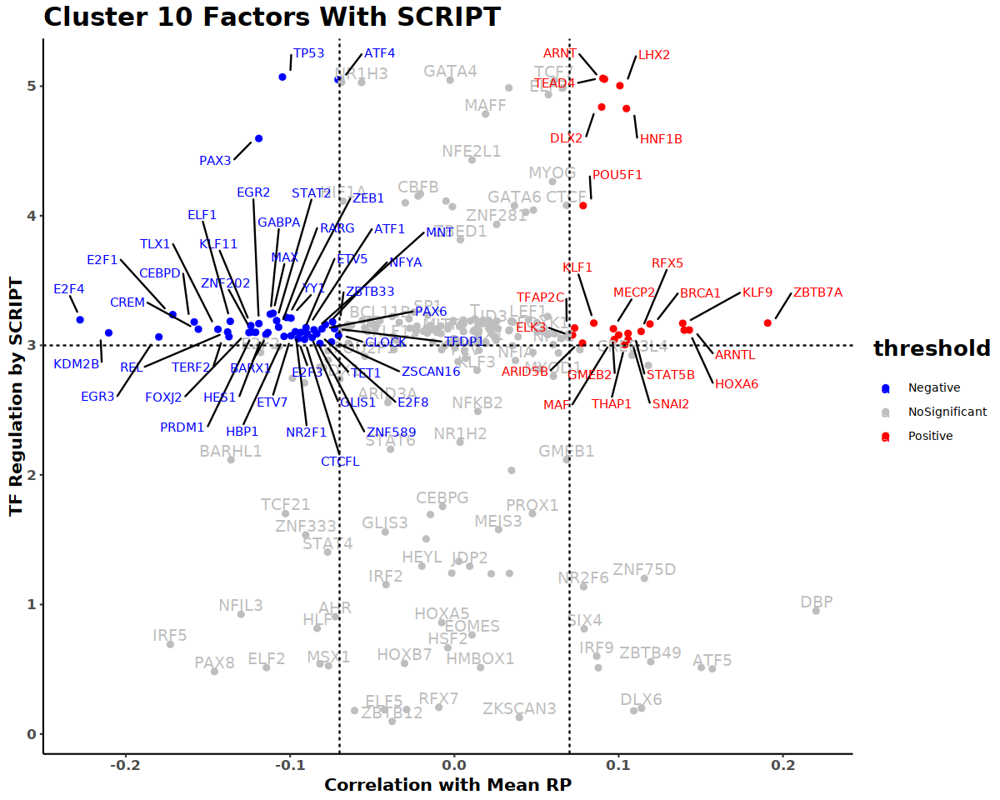

In [137]:
# cluster_setting <- 3
# for (i in seq(0,13)){
    cluster_setting <- 10
    correlation_threshold <- 0.07
    tf_regulation_threshold <- 3

    plt.data <- cor_table[which(cor_table$cluster == cluster_setting & cor_table$type == 'GIGGLE'),]
    plt.data$threshold = as.factor(ifelse(plt.data$tf_regulation > tf_regulation_threshold & abs(plt.data$correlation) >= correlation_threshold, 
                                          ifelse(plt.data$correlation > correlation_threshold ,'Positive','Negative'),'NoSignificant'))


    options(repr.plot.width=10, repr.plot.height=8)
    p <- ggplot(plt.data, aes(x=correlation, y=tf_regulation, color = threshold, label=factor))+
    geom_point()+
    scale_color_manual(values=c("blue", "grey","red"))+
    geom_text(data = subset(plt.data, plt.data$tf_regulation <= tf_regulation_threshold | abs(plt.data$correlation) <= correlation_threshold), 
              aes(y = tf_regulation + .07, label = factor), check_overlap=T)+
    geom_vline(xintercept=c(-correlation_threshold, correlation_threshold), color = "black", linetype="dashed")+ 
    geom_hline(yintercept=tf_regulation_threshold, color = "black", linetype="dashed")+ 
    labs(x="Correlation with Mean RP",y="TF Regulation by SCRIPT", title=paste0('Cluster ',cluster_setting,' Factors With SCRIPT'))+ 
    theme_classic(base_size = 10) +
    theme(axis.title.x = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5), 
          axis.title.y = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5),
          title = element_text(size = 15, face = "bold", vjust = 2, hjust = 0.5),
          axis.text = element_text(size = 10, face = "bold"),
         )+
    geom_text_repel(
            data = subset(plt.data, plt.data$tf_regulation > tf_regulation_threshold & abs(plt.data$correlation) >= correlation_threshold),
            aes(label = factor),
            size = 3,
            box.padding = unit(0.5, "lines"),
            point.padding = unit(0.8, "lines"), segment.color = "black", show.legend = FALSE)
  show(p)  
# }


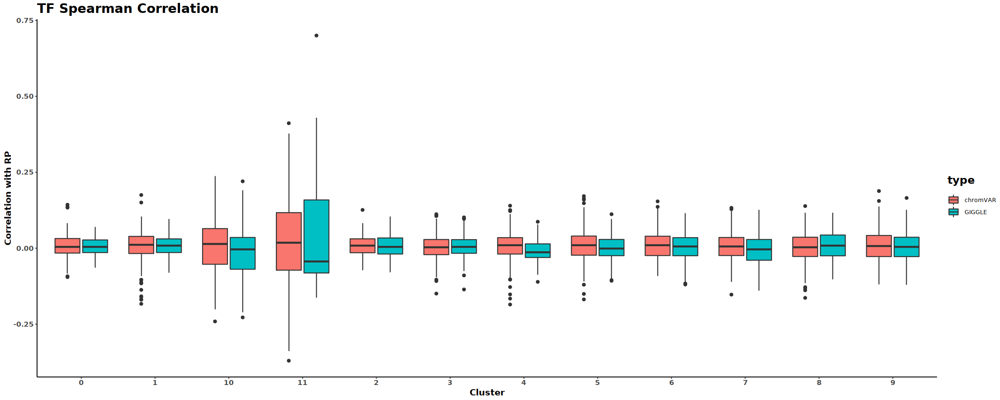

In [135]:
options(repr.plot.width=20, repr.plot.height=8)
ggplot(cor_table, aes(x=cluster, y=correlation, fill=type)) +
geom_boxplot()+
# xlab("Cluster") + 
# ylab("Correlation with RP")+
labs(x="Cluster",y="Correlation with RP", title = "TF Spearman Correlation")+ 
theme_classic(base_size = 10) +
theme(axis.title.x = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5), 
      axis.title.y = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5),
      title = element_text(size = 15, face = "bold", vjust = 2, hjust = 0.5),
      axis.text = element_text(size = 10, face = "bold")
     )


In [38]:
rp_table <- as.matrix(t(pbmc.rp[C_G_overlap,]))
giggle_table <- pbmc.p.giggle[,C_G_overlap]
chromVar_table <- pbmc.chromvar[,C_G_overlap]

cor_table <- data.frame(cluster=c(), factor=c(), type=c(), correlation=c())
for (clu in unique(pbmc.clusters.info)$seurat_clusters){
    barcode <- rownames(pbmc.clusters.info)[which(pbmc.clusters.info==clu)]
    cluster_rp <- apply(rp_table[barcode,],1,sum)
    for (tf in C_G_overlap){
        chromvar_correlation_value <- cor(cluster_rp, chromVar_table[barcode,tf], method = "spearman")
        giggle_correlation_value <- cor(cluster_rp, giggle_table[barcode,tf],method = "spearman")
        if (is.na(chromvar_correlation_value) | is.na(giggle_correlation_value)){
            next
        } else {
            cor_table <- rbind(cor_table, data.frame(cluster=c(clu, clu), factor=c(tf, tf), type=c("chromVAR", "GIGGLE"), 
                                                 correlation=c(chromvar_correlation_value, giggle_correlation_value)))
#           cor_table <- rbind(cor_table, data.frame(cluster=clu, factor=tf, type="GIGGLE", correlation=giggle_correlation_value))
        }
    }
}

cor_table$cluster = factor(cor_table$cluster, levels=c(0:max(unique(glioma.clusters.info)$seurat_clusters))) 

Warning message in cor(cluster_rp, giggle_table[barcode, tf], method = "spearman"):
“标准差为零”
Warning message in cor(cluster_rp, giggle_table[barcode, tf], method = "spearman"):
“标准差为零”
Warning message in cor(cluster_rp, giggle_table[barcode, tf], method = "spearman"):
“标准差为零”
Warning message in cor(cluster_rp, giggle_table[barcode, tf], method = "spearman"):
“标准差为零”
Warning message in cor(cluster_rp, giggle_table[barcode, tf], method = "spearman"):
“标准差为零”
Warning message in cor(cluster_rp, giggle_table[barcode, tf], method = "spearman"):
“标准差为零”
Warning message in cor(cluster_rp, giggle_table[barcode, tf], method = "spearman"):
“标准差为零”
Warning message in cor(cluster_rp, giggle_table[barcode, tf], method = "spearman"):
“标准差为零”
Warning message in cor(cluster_rp, giggle_table[barcode, tf], method = "spearman"):
“标准差为零”
Warning message in cor(cluster_rp, giggle_table[barcode, tf], method = "spearman"):
“标准差为零”
Warning message in cor(cluster_rp, giggle_table[barcode, tf], method = "spearman

ERROR: Error in h(simpleError(msg, call)): 在为'unique'函数选择方法时评估'x'参数出了错: 找不到对象'glioma.clusters.info' 


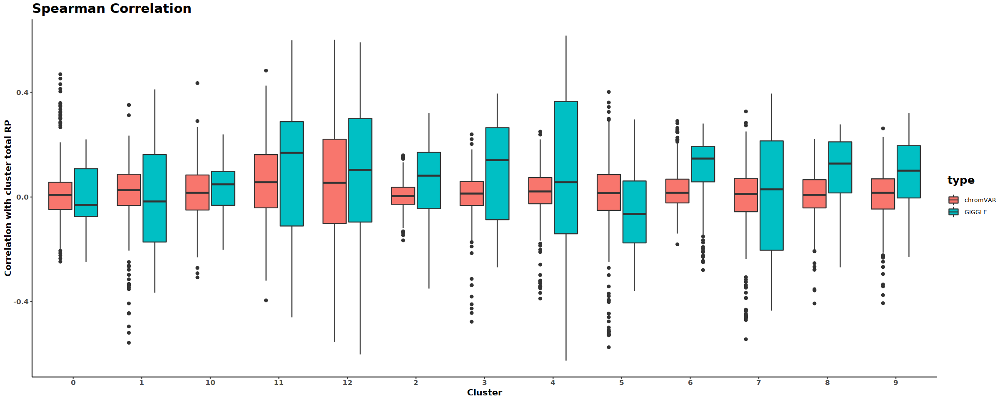

In [39]:
options(repr.plot.width=20, repr.plot.height=8)
ggplot(cor_table, aes(x=cluster, y=correlation, fill=type)) +
geom_boxplot()+
# xlab("Cluster") + 
# ylab("Correlation with RP")+
labs(x="Cluster",y="Correlation with cluster total RP", title = "Spearman Correlation")+ 
theme_classic(base_size = 10) +
theme(axis.title.x = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5), 
      axis.title.y = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5),
      title = element_text(size = 15, face = "bold", vjust = 2, hjust = 0.5),
      axis.text = element_text(size = 10, face = "bold")
     )

In [327]:
pbmc.clusters.info

,seurat_clusters
,<fct>
AAACGAAAGACACGGT,5
AAACGAAAGAGGTGGG,6
AAACGAAAGCACGTAG,6
AAACGAAAGCGCCTAC,0
AAACGAAAGCTTTCCC,5
AAACGAAAGGCGTCCT,1
AAACGAAAGGCTTTAC,6
AAACGAAAGTGATATG,2
AAACGAAAGTTTGGAA,5


#### cluster total rp (sum) (by cell)

In [360]:
rp_table <- as.matrix(t(pbmc.rp[C_G_overlap,]))
giggle_table <- pbmc.p.giggle[,C_G_overlap]
chromVar_table <- pbmc.chromvar[,C_G_overlap]

cor_table <- data.frame(cluster=c(), factor=c(), type=c(), correlation=c())
for (clu in unique(pbmc.clusters.info)$assign.ident){
    message(clu)
    barcode <- rownames(pbmc.clusters.info)[which(pbmc.clusters.info==clu)]
    message(length(barcode))
    cluster_rp <- apply(rp_table[barcode,],2,sum)
    for (cell in barcode){
        chromvar_correlation_value <- cor(cluster_rp, t(chromVar_table[cell,]), method = "spearman")
        giggle_correlation_value <- cor(cluster_rp, t(giggle_table[cell,]),method = "spearman")
        if (is.na(chromvar_correlation_value) | is.na(giggle_correlation_value)){
            next
        } else {
            cor_table <- rbind(cor_table, data.frame(cluster=c(clu, clu), factor=c(cell, cell), type=c("chromVAR", "SCRIPT"), 
                                                 correlation=c(chromvar_correlation_value, giggle_correlation_value)))
#           cor_table <- rbind(cor_table, data.frame(cluster=clu, factor=tf, type="GIGGLE", correlation=giggle_correlation_value))
        }
    }
}

# cor_table$cluster = factor(cor_table$cluster, levels=c(0:max(as.numeric(unique(cor_table$cluster)))))

CD4Tconv

2201

Mono/Macro

2920

NK

1240

B

785

CD8T

427



In [99]:
qsave(cor_table, "10X_ATAC/per_50_cell_peak/10k_TF_index/cor_table_rp.qs")

In [358]:
t.test(cor_table[which(cor_table$cluster == 'NK' & cor_table$type == 'GIGGLE'),]$correlation, cor_table[which(cor_table$cluster == 'NK' & cor_table$type == 'chromVAR'),]$correlation)


	Welch Two Sample t-test

data:  cor_table[which(cor_table$cluster == "NK" & cor_table$type == "GIGGLE"), ]$correlation and cor_table[which(cor_table$cluster == "NK" & cor_table$type == "chromVAR"), ]$correlation
t = 8.4612, df = 2468, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 0.01580094 0.02533423
sample estimates:
  mean of x   mean of y 
-0.04606615 -0.06663373 


In [ ]:
p-value < 2.2e-16
p-value < 2.2e-16
p-value = 2.409e-08
p-value < 2.2e-16
p-value < 2.2e-16

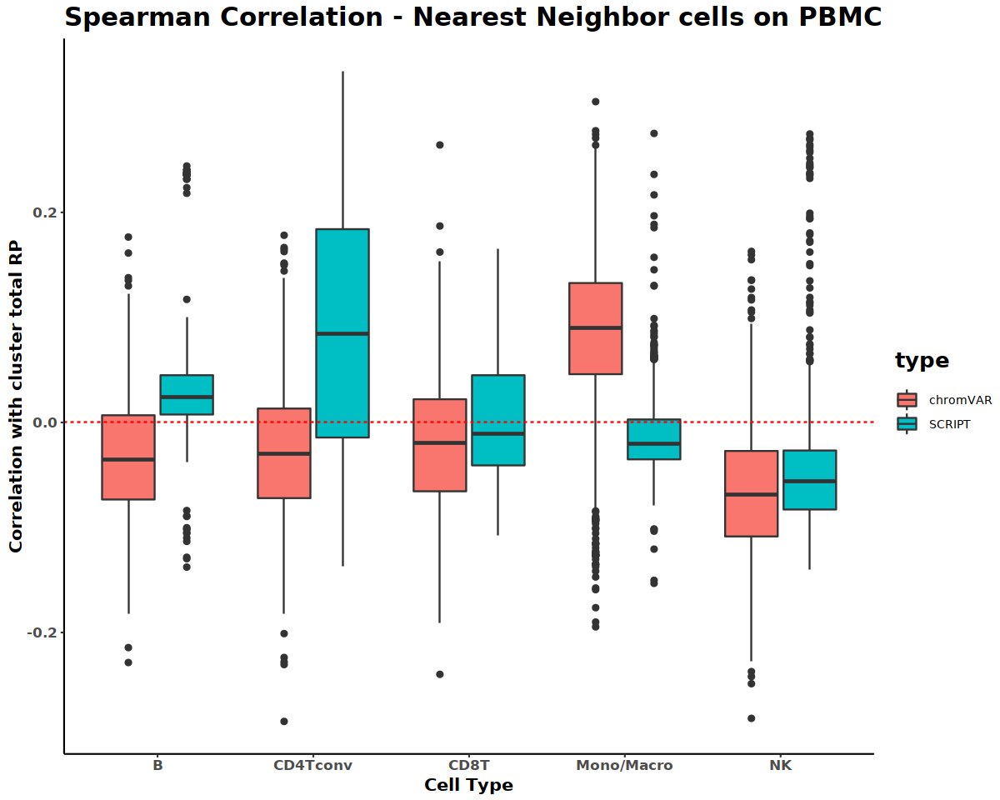

In [363]:
options(repr.plot.width=10, repr.plot.height=8)
ggplot(cor_table, aes(x=cluster, y=correlation, fill=type)) +
geom_boxplot()+
# xlab("Cluster") + 
# ylab("Correlation with RP")+
labs(x="Cell Type",y="Correlation with cluster total RP", title = "Spearman Correlation - Nearest Neighbor cells on PBMC")+ 
geom_hline(aes(yintercept=0), color = "red", linetype="dashed")+ 
theme_classic(base_size = 10) +
theme(axis.title.x = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5), 
      axis.title.y = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5),
      title = element_text(size = 15, face = "bold", vjust = 2, hjust = 0.5),
      axis.text = element_text(size = 10, face = "bold")
     )

#### correlate with cluster RP

In [52]:
cluster_rp_table = read.csv("10X_ATAC/cluster_rp_table.txt", sep = "\t", row.names = "Factor")

In [53]:
ovlap_tf = intersect(C_G_overlap, rownames(cluster_rp_table))

In [76]:
p_result_5fold <- qread('10X_ATAC/per_50_cell_peak/5_fold_tf_index/pvalue.qs')

In [77]:
pbmc.p.giggle.5fold <- p_result_5fold$giggle

In [79]:
pbmc.chromvar <- chromVAR_result$ATAC@meta.data[,12:length(chromVAR_result$ATAC@meta.data)]

In [81]:
pbmc.clusters.info <- chromVAR_result$ATAC@meta.data["seurat_clusters"]

In [87]:
rp_table <- as.matrix(cluster_rp_table[ovlap_tf,])
giggle_table.10k <- pbmc.p.giggle.10k[,ovlap_tf]
giggle_table.1k <- pbmc.p.giggle.1k[,ovlap_tf]
giggle_table.5fold <- pbmc.p.giggle.5fold[,ovlap_tf]
giggle_table.300_10k <- pbmc.p.giggle.300_10k[,ovlap_tf]
chromVar_table <- pbmc.chromvar[,ovlap_tf]

cor_table <- data.frame(cluster=c(), factor=c(), type=c(), correlation=c())
for (clu in unique(pbmc.clusters.info)$seurat_clusters){
    message(clu)
    barcode <- rownames(pbmc.clusters.info)[which(pbmc.clusters.info==clu)]
    message(length(barcode))
    cluster_rp <- rp_table[,paste0("C", clu)]
    for (cell in barcode){
        if ((cell %in% rownames(giggle_table.1k)) & (cell %in% rownames(giggle_table.300_10k)) & (cell %in% rownames(giggle_table.10k))){
            chromvar_correlation_value <- cor(cluster_rp, t(chromVar_table[cell,]), method = "spearman")
            giggle_10k_correlation_value <- cor(cluster_rp, giggle_table.10k[cell,],method = "spearman")
            giggle_1k_correlation_value <- cor(cluster_rp, giggle_table.1k[cell,], method = "spearman")
            giggle_5fold_correlation_value <- cor(cluster_rp, giggle_table.5fold[cell,], method = "spearman")
            giggle_300_10k_correlation_value <- cor(cluster_rp, giggle_table.300_10k[cell,], method = "spearman")
            if (is.na(chromvar_correlation_value) | is.na(giggle_10k_correlation_value)){
                message("NA occored!")
                next
            } else {
                cor_table <- rbind(cor_table, data.frame(cluster=c(clu, clu, clu, clu, clu), 
                                                         factor=c(cell, cell, cell, cell, cell), 
                                                         type=c("chromVAR", "GIGGLE_10k", "GIGGLE_300_10k", "GIGGLE_1k", "GIGGLE_5fold"), 
                                                         correlation=c(chromvar_correlation_value, giggle_10k_correlation_value, giggle_300_10k_correlation_value, 
                                                                       giggle_1k_correlation_value, giggle_5fold_correlation_value)))
            }
        } else {
            next
        }
        
    }
}

# cor_table$cluster = factor(cor_table$cluster, levels=c(0:max(as.numeric(unique(cor_table$cluster)))))

5

691

6

574

0

1238

1

1020

2

893

10

164

3

785

8

455

7

490

4

760

9

427

11

51

12

25



[1] TRUE

In [88]:
qsave(cor_table, "10X_ATAC/per_50_cell_peak/300_10k_tf_index/cor_table_cluster_rp_1k_10k_30010k_5fold_chromVAR.qs")

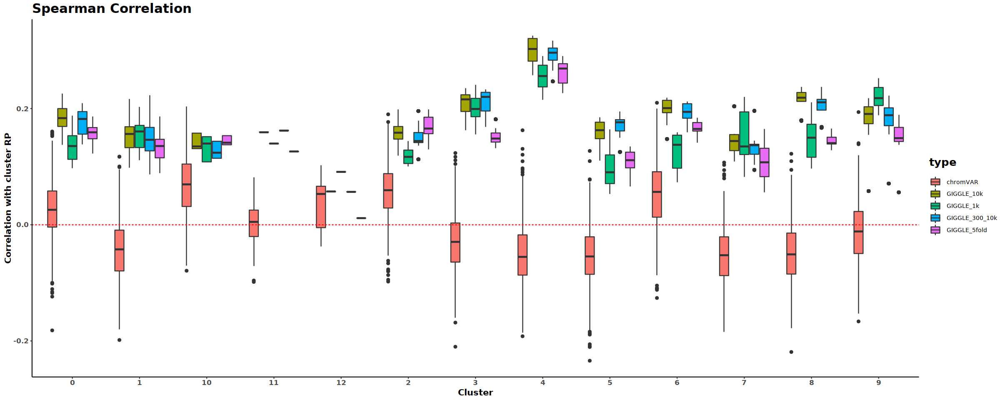

In [89]:
options(repr.plot.width=20, repr.plot.height=8)
ggplot(cor_table, aes(x=cluster, y=correlation, fill=type)) +
geom_boxplot()+
# xlab("Cluster") + 
# ylab("Correlation with RP")+
labs(x="Cluster",y="Correlation with cluster RP", title = "Spearman Correlation")+ 
geom_hline(aes(yintercept=0), color = "red", linetype="dashed")+ 
theme_classic(base_size = 10) +
theme(axis.title.x = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5), 
      axis.title.y = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5),
      title = element_text(size = 15, face = "bold", vjust = 2, hjust = 0.5),
      axis.text = element_text(size = 10, face = "bold")
     )

### cluster deviation

In [ ]:
# rp_table <- as.matrix(t(pbmc.rp[C_G_overlap,]))
giggle_table <- pbmc.p.giggle[,C_G_overlap]
chromVar_table <- pbmc.chromvar[,C_G_overlap]

dev_table <- data.frame(cluster=c(), factor=c(), type=c(), sd=c())
for (clu in unique(pbmc.clusters.info)$seurat_clusters){
    message(clu)
    barcode <- rownames(pbmc.clusters.info)[which(pbmc.clusters.info==clu)]
    message(length(barcode))
    for (tf in C_G_overlap){
        chrom_std_deviation <- sd(chromVar_table[barcode,tf])
        giggle_std_deviation <- sd(giggle_table[barcode,tf])
        dev_table <- rbind(dev_table, data.frame(cluster=c(clu,clu), factor=c(tf,tf), type=c("chromVAR", "GIGGLE"), 
                                                     sd=c(chrom_std_deviation, giggle_std_deviation)))
    }
}

In [158]:
qsave(dev_table, "10X_ATAC/per_50_cell_peak/1k_TF_index/dev_table.qs")

In [159]:
dev_table$factor

[1] "SPIB"    "SPIB"    "CEBPA"   "CEBPA"   "SPI1"    "SPI1"    "CEBPB"  
    [8] "CEBPB"   "CEBPD"   "CEBPD"   "JUNB"    "JUNB"    "FOS"     "FOS"    
   [15] "FOSL1"   "FOSL1"   "JUND"    "JUND"    "SMARCC1" "SMARCC1" "FOSL2"  
   [22] "FOSL2"   "JUN"     "JUN"     "BCL11A"  "BCL11A"  "BCL11B"  "BCL11B" 
   [29] "BACH1"   "BACH1"   "JDP2"    "JDP2"    "CEBPG"   "CEBPG"   "CEBPE"  
   [36] "CEBPE"   "CTCF"    "CTCF"    "BACH2"   "BACH2"   "ATF4"    "ATF4"   
   [43] "NFE2"    "NFE2"    "NFE2L2"  "NFE2L2"  "IRF4"    "IRF4"    "EOMES"  
   [50] "EOMES"   "TBX5"    "TBX5"    "HLF"     "HLF"     "SNAI2"   "SNAI2"  
   [57] "CTCFL"   "CTCFL"   "TCF4"    "TCF4"    "RUNX2"   "RUNX2"   "STAT2"  
   [64] "STAT2"   "SNAI1"   "SNAI1"   "ZEB1"    "ZEB1"    "ID3"     "ID3"    
   [71] "ID4"     "ID4"     "BATF"    "BATF"    "DBP"     "DBP"     "IRF1"   
   [78] "IRF1"    "MAFF"    "MAFF"    "RUNX3"   "RUNX3"   "RUNX1"   "RUNX1"  
   [85] "LEF1"    "LEF1"    "NFKB1"   "NFKB1"   "NRF1"    "NRF1"    "ELF5"   
   [92] "ELF5"    "CBFB"    "CBFB"    "LMO2"    "LMO2"    "IRF8"    "IRF8"   
   [99] "TCF7L2"  "TCF7L2"  "NR2F2"   "NR2F2"   "MYOD1"   "MYOD1"   "BPTF"   
  [106] "BPTF"    "RELA"    "RELA"    "ETV6"    "ETV6"    "POU2F2"  "POU2F2" 
  [113] "MAFK"    "MAFK"    "STAT6"   "STAT6"   "IRF9"    "IRF9"    "REL"    
  [120] "REL"     "NR4A1"   "NR4A1"   "NFIL3"   "NFIL3"   "ELK4"    "ELK4"   
  [127] "ERG"     "ERG"     "TCF7L1"  "TCF7L1"  "MITF"    "MITF"    "NR2F1"  
  [134] "NR2F1"   "ESRRA"   "ESRRA"   "GATA2"   "GATA2"   "IRF2"    "IRF2"   
  [141] "FOXP3"   "FOXP3"   "T"       "T"       "FOXO3"   "FOXO3"   "RORA"   
  [148] "RORA"    "FEV"     "FEV"     "HNF4A"   "HNF4A"   "ATF5"    "ATF5"   
  [155] "ERF"     "ERF"     "NFE2L1"  "NFE2L1"  "NFE2L3"  "NFE2L3"  "TCF7"   
  [162] "TCF7"    "ETV1"    "ETV1"    "ETV4"    "ETV4"    "ELK1"    "ELK1"   
  [169] "ELK3"    "ELK3"    "GABPA"   "GABPA"   "FOXO4"   "FOXO4"   "ATF2"   
  [176] "ATF2"    "HIVEP1"  "HIVEP1"  "HIVEP3"  "HIVEP3"  "PRDM1"   "PRDM1"  
  [183] "IRF3"    "IRF3"    "POU2F1"  "POU2F1"  "ETV5"    "ETV5"    "NFKB2"  
  [190] "NFKB2"   "EPAS1"   "EPAS1"   "MAFG"    "MAFG"    "NR5A2"   "NR5A2"  
  [197] "ETS1"    "ETS1"    "FOXO1"   "FOXO1"   "FOXG1"   "FOXG1"   "FLI1"   
  [204] "FLI1"    "GATA1"   "GATA1"   "TCF12"   "TCF12"   "ELF2"    "ELF2"   
  [211] "SPDEF"   "SPDEF"   "FOXN3"   "FOXN3"   "EBF1"    "EBF1"    "FOXP1"  
  [218] "FOXP1"   "FOXK1"   "FOXK1"   "RELB"    "RELB"    "NR2F6"   "NR2F6"  
  [225] "IRF5"    "IRF5"    "NR1D1"   "NR1D1"   "SMAD4"   "SMAD4"   "FOXJ2"  
  [232] "FOXJ2"   "ATOH1"   "ATOH1"   "GATA3"   "GATA3"   "RBPJ"    "RBPJ"   
  [239] "FOXM1"   "FOXM1"   "KLF12"   "KLF12"   "E2F1"    "E2F1"    "NFATC3" 
  [246] "NFATC3"  "MECOM"   "MECOM"   "RARA"    "RARA"    "FOXD3"   "FOXD3"  
  [253] "RXRG"    "RXRG"    "PKNOX1"  "PKNOX1"  "ZFP42"   "ZFP42"   "ZNF740" 
  [260] "ZNF740"  "PAX6"    "PAX6"    "TBX21"   "TBX21"   "TFEB"    "TFEB"   
  [267] "HNF4G"   "HNF4G"   "GATA4"   "GATA4"   "RXRA"    "RXRA"    "GATA6"  
  [274] "GATA6"   "ATF3"    "ATF3"    "CIC"     "CIC"     "FOXK2"   "FOXK2"  
  [281] "SRF"     "SRF"     "FOXP2"   "FOXP2"   "ZNF35"   "ZNF35"   "TFE3"   
  [288] "TFE3"    "CREB3"   "CREB3"   "CREB3L4" "CREB3L4" "TGIF2"   "TGIF2"  
  [295] "ATF7"    "ATF7"    "NR1I2"   "NR1I2"   "PPARD"   "PPARD"   "SOX3"   
  [302] "SOX3"    "E2F5"    "E2F5"    "ZNF784"  "ZNF784"  "TFAP2C"  "TFAP2C" 
  [309] "FOXF2"   "FOXF2"   "FERD3L"  "FERD3L"  "MEF2B"   "MEF2B"   "ARNTL2" 
  [316] "ARNTL2"  "SIX2"    "SIX2"    "EGR3"    "EGR3"    "FOXF1"   "FOXF1"  
  [323] "ARNT"    "ARNT"    "ARNTL"   "ARNTL"   "MEIS2"   "MEIS2"   "PBX1"   
  [330] "PBX1"    "NR2C2"   "NR2C2"   "E2F2"    "E2F2"    "BHLHE41" "BHLHE41"
  [337] "NEUROD1" "NEUROD1" "SCRT1"   "SCRT1"   "TFAP4"   "TFAP4"   "CUX1"   
  [344] "CUX1"    "BATF3"   "BATF3"   "MYOG"    "MYOG"    "NFYA"    "NFYA"   
  [351] "MSC"     "MSC"     "TP53"    "TP53"    "HOXA5"   "HOXA5"   "CEBPZ"  
  [358] "CEBPZ"   "USF1"  

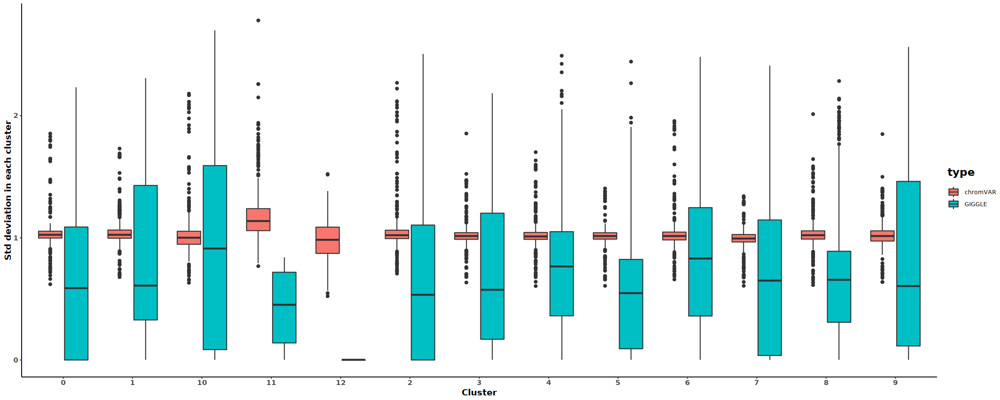

In [142]:
options(repr.plot.width=20, repr.plot.height=8)
ggplot(dev_table, aes(x=cluster, y=sd, fill=type)) +
geom_boxplot()+
labs(x="Cluster", y="Std deviation in each cluster")+ 
# geom_hline(aes(yintercept=0), color = "red", linetype="dashed")+ 
theme_classic(base_size = 10) +
theme(axis.title.x = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5), 
      axis.title.y = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5),
      title = element_text(size = 15, face = "bold", vjust = 2, hjust = 0.5),
      axis.text = element_text(size = 10, face = "bold")
     )

In [160]:
tf_marker <- "BCL11A"
subdev_table <- subset(dev_table, factor==tf_marker)

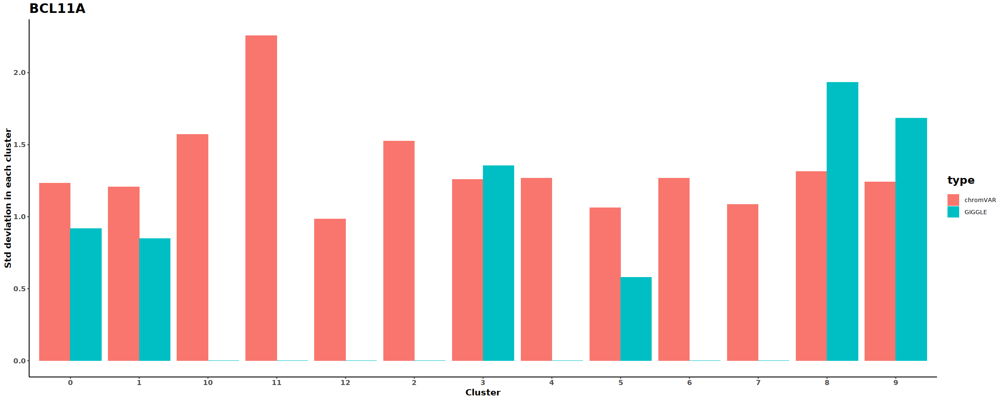

In [161]:
options(repr.plot.width=20, repr.plot.height=8)
ggplot(subdev_table, aes(x=cluster, weight=sd, fill=type)) +
geom_bar(position="dodge")+
labs(x="Cluster", y="Std deviation in each cluster", title=tf_marker)+ 
# geom_hline(aes(yintercept=0), color = "red", linetype="dashed")+ 
theme_classic(base_size = 10) +
theme(axis.title.x = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5), 
      axis.title.y = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5),
      title = element_text(size = 15, face = "bold", vjust = 2, hjust = 0.5),
      axis.text = element_text(size = 10, face = "bold")
     )

In [ ]:
print(variability['name'])

In [ ]:
TFlist_chromvar <- variability[order(variability['variability'], decreasing=T),]$name
p_sd <- data.frame(apply(p_result$giggle, 2, sd))
TFlist_p <- rownames(p_sd)[order(p_sd, decreasing = T)]

In [ ]:
write.table(setdiff(TFlist_chromvar,TFlist_p), "motif_list.txt", col.names = F, row.names = F, quote = F)

------------
------------
------------
# run BCC PBMC (GSE129785)

### ATAC-seq

In [57]:
bcc.peak <- Read10X_h5('BCC_PBMC/data/GSE129785_BCC_scATAC_peak_count.h5')

bcc.peak <- bcc.peak[which(Matrix::rowSums(bcc.peak)>50),]

bcc.result <- ATACRunSeurat(inputMat = bcc.peak , 
                                project = "BCC_PBMC/bcc_pbmc_scATAC", 
                                method = "LSI",
                                min.c = 50,
                                min.p = 500,
                                dims.use = 1:30,
                                cluster.res = 0.6,
                                peaks.test.use = "presto",
                                peaks.cutoff = 1e-05)

bcc.result.RP <- ATACCalculateGenescore(inputMat = bcc.peak)
bcc.result$ATAC <- ATACAttachGenescore(bcc.result$ATAC, bcc.result.RP)
bcc.result$ATAC <- ATACAnnotateCelltype(bcc.result$ATAC, signatures = "human.immune.CIBERSORT", min.score = 0, genes.test.use = "presto", genes.cutoff = 1E-5, orig.ident = NULL)

In [66]:
qsave(bcc.result, "BCC_PBMC/BCC_GSE129785.qs", nthreads = 2)

In [5]:
bcc.result <- qread("BCC_PBMC/ATAC/BCC_ATAC.qs")

In [6]:
bcc.singlecell.experiment <- as.SingleCellExperiment(bcc.result$ATAC)
saveRDS(bcc.singlecell.experiment, "BCC_PBMC/ATAC/BCC_single_cell_experiment.rds")

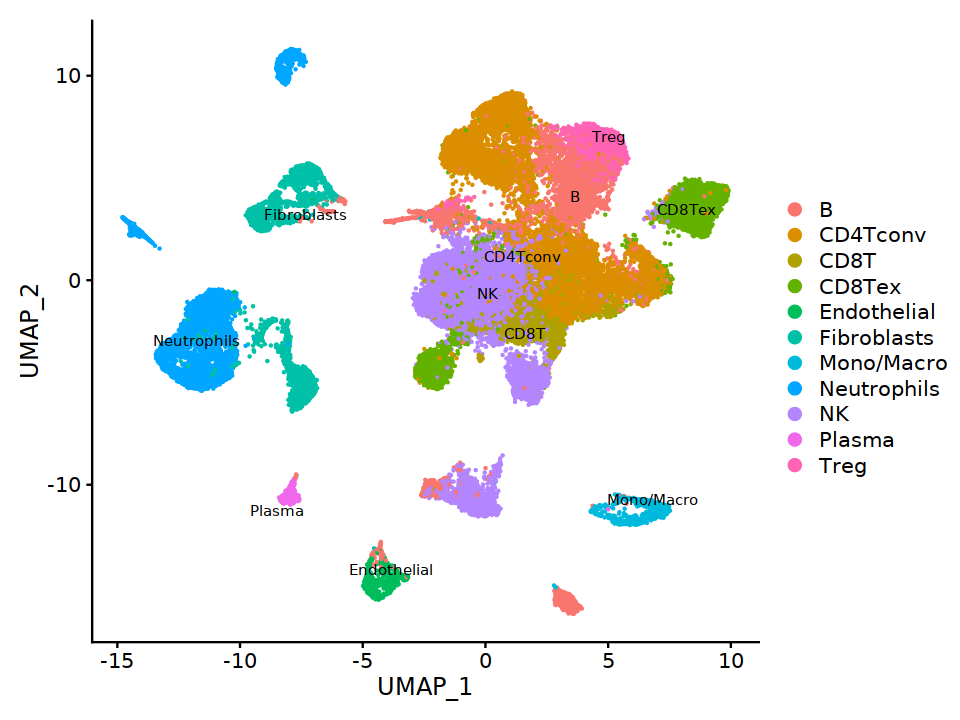

In [69]:
options(repr.plot.width=8, repr.plot.height=6)
DimPlot(object <- bcc.result$ATAC, label = TRUE, pt.size = 0.2, group.by = "assign.ident", label.size = 3, repel = TRUE)

### RNA-seq

In [ ]:
# bcc <- read.table('BCC_GSE129785/GSE123813/GSE123813_bcc_scRNA_counts.txt', sep = "\t")

In [49]:
bcc <- qread("BCC_PBMC/data/GSE123813_bcc_scRNA_counts.qs")

In [ ]:
bcc.expr <- RNACountToTPM(bcc, idType = "Symbol")

In [4]:
qsave(bcc.expr, "BCC_GSE129785/GSE123813/GSE123813_bcc_scRNA_expr.qs")

In [70]:
# bcc <- Read10X_h5('BCC_GSE129785/GSE123813_BCC_scRNA_counts.h5')
# bcc.expr <- RNACountToTPM(bcc, idType = "Symbol")
bcc.expr <- log2(bcc.expr/10+1)
bcc.RNA.res <- RNARunSeurat(inputMat = bcc.expr, 
                              project = "BCC_PBMC/GSE123813_BCC_scRNA", 
                              min.c = 10,
                              min.g = 500,
                              dims.use = 1:15,
                              variable.genes = 2000, 
                              organism = "GRCh38",
                              cluster.res = 0.6,
                              genes.test.use = "presto",
                              genes.cutoff = 1e-05)
data(human.immune.CIBERSORT)
bcc.RNA.res$RNA <- RNAAnnotateCelltype(RNA = bcc.RNA.res$RNA, 
                                         gene = bcc.RNA.res$gene,
                                         signatures = human.immune.CIBERSORT, 
                                         min.score = 0.05)

Normalization and identify variable genes ...

Regressing out nCount_RNA

Centering and scaling data matrix

PCA analysis ...

PC_ 1 
Positive:  CD74, TRBC2, CXCR4, CD52, CD7, CD3D, HCST, TRBC1, S100A4, LTB 
	   TNFRSF18, CCL5, TNFRSF4, NKG7, DUSP2, GZMB, GNLY, IFITM1, GZMH, ZFP36L2 
	   AC133644.2, BST2, HIST1H4C, SIT1, AC017002.1, TRAPPC1, ZBED2, AC090498.1, CLIC3, CCL4 
Negative:  S100A14, KRT14, KRT17, SFN, S100A2, KRT15, KRT5, LGALS7B, KRT16, GJB2 
	   TM4SF1, EFNA1, GJB6, EDN1, SOX9, CYR61, FXYD3, TACSTD2, KRT6B, BGN 
	   APOE, KRT6A, ELF3, IER3, MAFB, SLPI, IRX2, CLDN4, EGR1, GJB3 
PC_ 2 
Positive:  S100A14, LGALS7B, KRT16, SFN, KRT15, FXYD3, KRT14, KRT6A, KRT6B, CLDN4 
	   ELF3, KRT17, SLPI, LY6D, GJB3, KRT5, S100A2, S100A7, EDN1, TACSTD2 
	   CD7, GJB6, SOX9, CD3D, CALML5, RHOV, KRTDAP, GJB5, DUSP2, TRBC2 
Negative:  COL1A2, COL3A1, LUM, CTSK, MXRA8, SOD3, SERPINF1, CTHRC1, ISLR, THY1 
	   COL6A1, SFRP2, DCN, PCOLCE, COL1A1, CPXM1, CD248, IGHG4, IGKC, C11orf96 
	   TPM2, COX7A

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 52917
Number of edges: 1654439

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9040
Number of communities: 18
Elapsed time: 25 seconds


Identify cluster specific genes ...



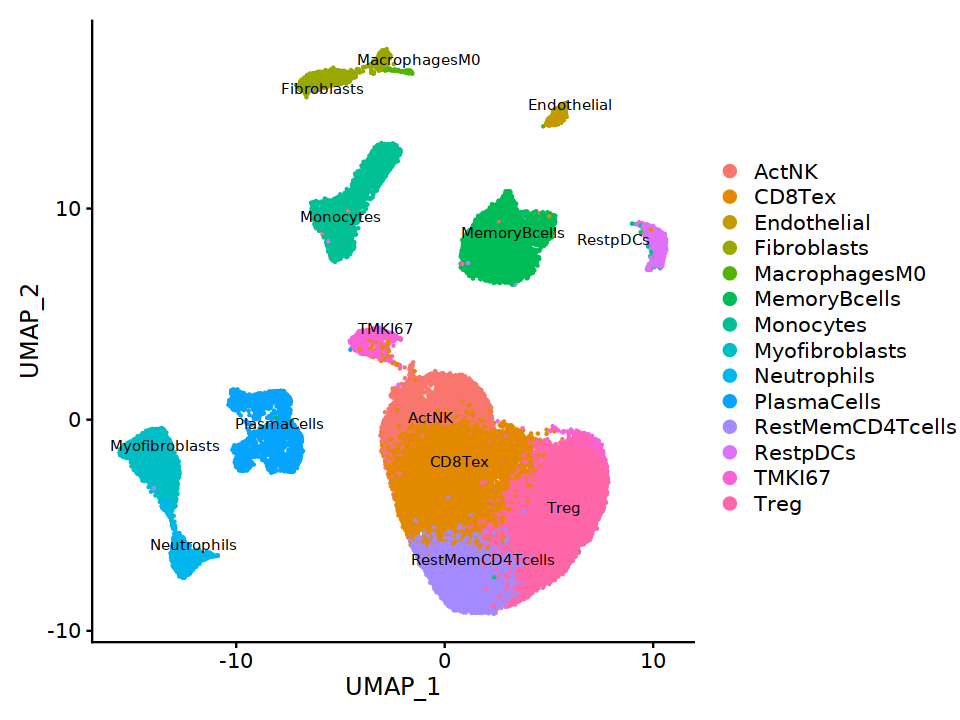

In [71]:
options(repr.plot.width=8, repr.plot.height=6)
DimPlot(object <- bcc.RNA.res$RNA, label = TRUE, pt.size = 0.2, group.by = "assign.ident", label.size = 3, repel = TRUE)

In [72]:
bcc.RNA.anno <- read.delim("BCC_PBMC/data/GSE123813_bcc_all_metadata.txt")
bcc.RNA.res$RNA@meta.data <- cbind(bcc.RNA.res$RNA@meta.data, bcc.RNA.anno[match(colnames(bcc.RNA.res$RNA), bcc.RNA.anno[,1]),c(2,3,5)])
# p = DimPlot(object <- bcc.RNA.res$RNA, label = TRUE, pt.size = 0.2, group.by = "cluster", label.size = 3, repel = TRUE)
# ggsave(paste0(bcc.RNA.res$RNA@project.name, "_annotated_meta.png"), p, width=6.5, height=4.5)

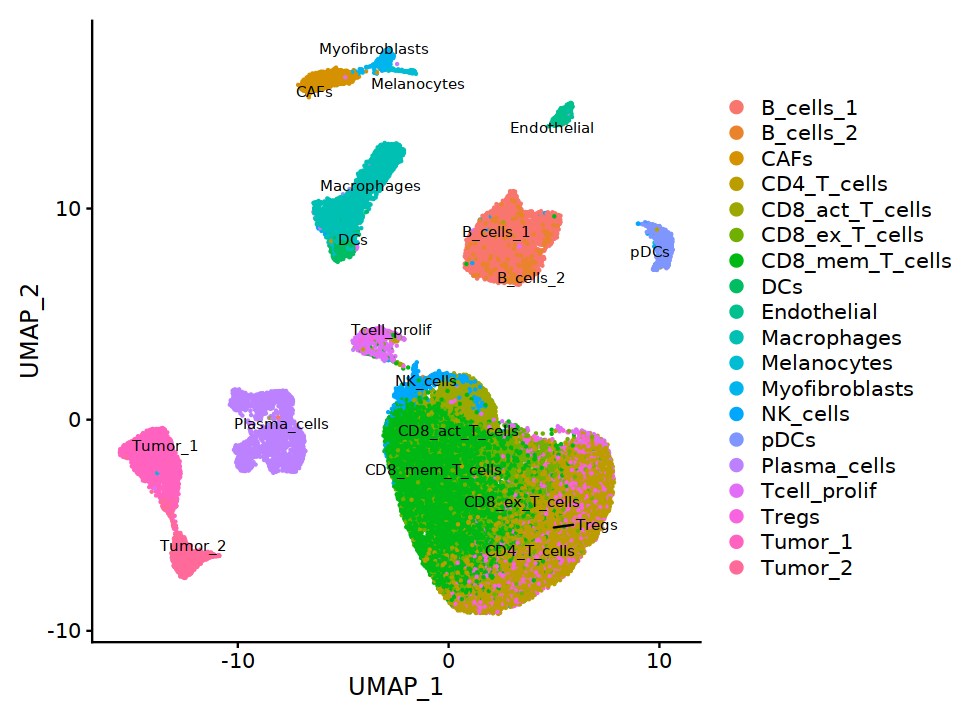

In [73]:
options(repr.plot.width=8, repr.plot.height=6)
DimPlot(object <- bcc.RNA.res$RNA, label = TRUE, pt.size = 0.2, group.by = "cluster", label.size = 3, repel = TRUE)

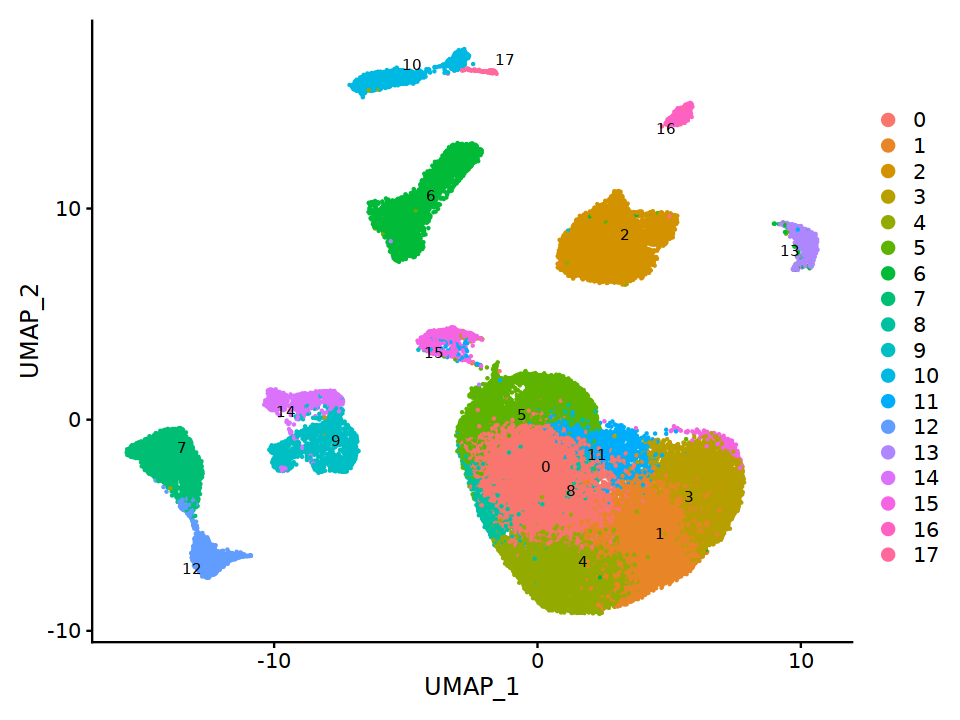

In [74]:
DimPlot(object <- bcc.RNA.res$RNA, label = TRUE, pt.size = 0.2, label.size = 3, repel = TRUE)

In [78]:
current.cluster.ids <- levels(bcc.RNA.res$RNA@meta.data$seurat_clusters)
new.cluster.ids <- c("0:CD8Teff", "1:Treg", "2:B", "3:Treg", "4:CD4Tconv", 
                       "5:Treg", "6:MonoMac", "7:Malignant", "8:CD8Teff", "9:Plasma", 
                       "10:CAF", "11:CD8Teff", "12:Malignant", "13:pDC", "14:Plasma", 
                       "15:TProliferation", "16:Endothelial", "17:Melanocyte")
# new.cluster.ids <- c("0:CD8Teff", "1:CD4Tconv", "2:B", "3:CD4Tconv", "4:Treg", 
#                        "5:CD8Teff", "6:CD8Teff", "7:Malignant", "8:mDC", "9:Plasma", 
#                        "10:MonoMac", "11:CAF", "12:TProliferation", "13:pDC", "14:Malignant", 
#                        "15:Plasma", "16:Endothelial", "17:CAF", "18:Melanocyte")
assign.ident.mannual <- plyr::mapvalues(x = bcc.RNA.res$RNA@meta.data$seurat_clusters, from = current.cluster.ids, to = new.cluster.ids)
bcc.RNA.res$RNA@meta.data$assign.ident.CIBERSORT = bcc.RNA.res$RNA@meta.data$assign.ident
bcc.RNA.res$RNA@meta.data$assign.ident = assign.ident.mannual
p = DimPlot(object = bcc.RNA.res$RNA, label = TRUE, pt.size = 0.2, group.by = "assign.ident", label.size = 3, repel = T)
ggsave(paste0(bcc.RNA.res$RNA@project.name, "_annotated_mannually.png"), p, width=6, height=4)

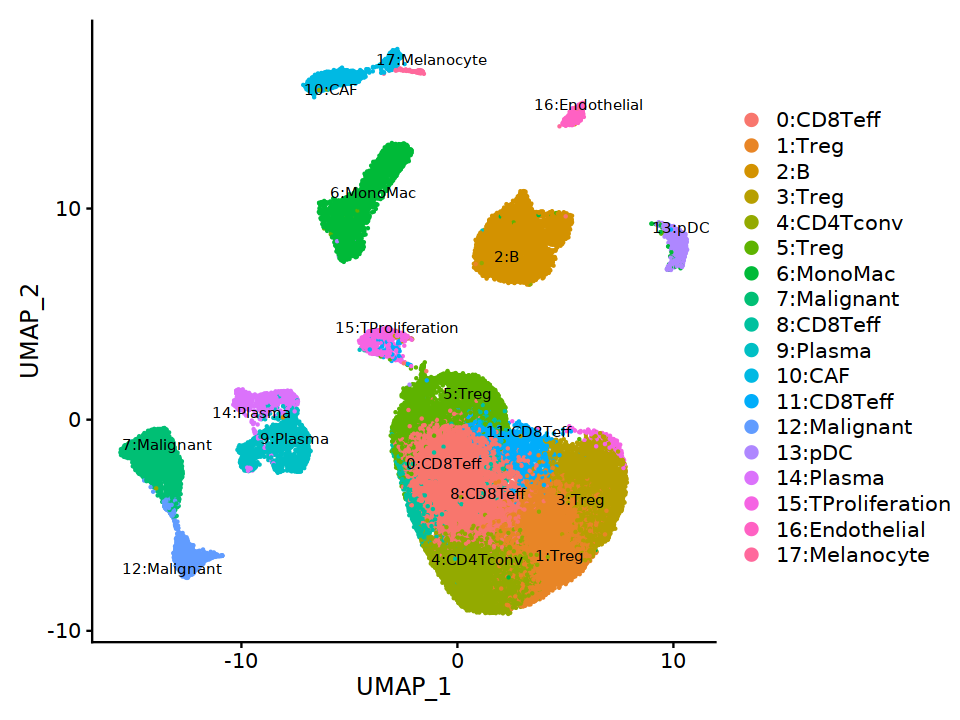

In [79]:
p

In [80]:
qsave(bcc.RNA.res, "BCC_PBMC/GSE123813_bcc_scRNA_seurat_object_well_annotated.qs")

In [77]:
bcc.RNA.res <- qread("BCC_PBMC/GSE123813_bcc_scRNA_seurat_object.qs")

In [81]:
bcc.coembedded.res <- Incorporate(RNA = bcc.RNA.res$RNA, ATAC = bcc.result$ATAC, project = "BCC_integrated", dims.use = 1:15)

Warning message in RunCCA.Seurat(object1 = reference, object2 = query, features = features, :
“Running CCA on different assays”
Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 56323 anchors

Filtering anchors

	Retained 8504 anchors

Extracting within-dataset neighbors

Finding integration vectors

Finding integration vector weights

Predicting cell labels

Finding integration vectors

Finding integration vector weights

Transfering 2000 features onto reference data

Centering data matrix

20:27:59 UMAP embedding parameters a = 0.9922 b = 1.112

Found more than one class "dist" in cache; using the first, from namespace 'BiocGenerics'

Also defined by ‘spam’

20:27:59 Read 90735 rows and found 15 numeric columns

20:27:59 Using Annoy for neighbor search, n_neighbors = 30

Found more than one class "dist" in cache; using the first, from namespace 'BiocGenerics'

Also defined by ‘spam’

20:27:59 Building Annoy index with metric = cosine, n_trees = 50

0%   10 

In [82]:
 DimPlot(object = bcc.coembedded.res$RNA, label = TRUE, pt.size = 0.2, group.by = "assign.ident", label.size = 3, repel = T)

ERROR: Error in which(x = object.classes, useNames = TRUE): 参数'which'必需是逻辑值


[1] 12201

### perform TF analysis

In [ ]:
#  generate background bed
map_list <- list()
step = 50
# key <- "0-1"
path <- "BCC_GSE129785/per_50_cell_peak/bg_bed/"
for (i in seq(1,1000)) {
    cl_name <- colnames(bcc.peak)
    map_list[[i]] <- cl_name[sample(1:length(cl_name), step)]
    peak_sub <- bcc.peak[,map_list[[i]]]
    peak_sub_matrix <- as.matrix(peak_sub[which(rowSums(peak_sub) > 5),])
    peaks <- rownames(peak_sub_matrix)
    peaks <- data.frame(chr=unlist(strsplit(peaks,'_'))[seq(1,length(peaks)*3,3)], 
                    start=as.numeric(unlist(strsplit(peaks,'_'))[seq(2,length(peaks)*3,3)]),
                    end=as.numeric(unlist(strsplit(peaks,'_'))[seq(3,length(peaks)*3,3)]))  
    write.table(peaks, paste0(path, as.character(i), ".bed") ,sep="\t",quote = F, row.names = F, col.names = F)
}
saveRDS(map_list, "BCC_GSE129785/per_50_cell_peak/bg_map_list.rds")

In [ ]:
map_list <- list()
step = 50
# key <- "0-1"
path <- "BCC_GSE129785/per_50_cell_peak/bed/"
for (i in unique(metadata$seurat_clusters)){
    cluster_cell_name <- rownames(metadata)[metadata$seurat_clusters==i]
    start = seq(1, length(cluster_cell_name), step)
    j = 1
    for (s in start){
        cl_name <- cluster_cell_name[s:(s + step -1)]
        key = paste0(as.character(i), "_", as.character(j))
        message(key)
        map_list[[key]] <- na.omit(cl_name)
        if (length(na.omit(cl_name)) < 20) {
            message(paste(key, "only have", length(na.omit(cl_name)), "cells, skip generate bed file."))
            next
        } else {
            peak_sub <- bcc.peak[,map_list[[key]]]
            peak_sub_matrix <- as.matrix(peak_sub[which(rowSums(peak_sub) > 5),])
            peaks <- rownames(peak_sub_matrix)
            peaks <- data.frame(chr=unlist(strsplit(peaks,'_'))[seq(1,length(peaks)*3,3)], 
                            start=as.numeric(unlist(strsplit(peaks,'_'))[seq(2,length(peaks)*3,3)]),
                            end=as.numeric(unlist(strsplit(peaks,'_'))[seq(3,length(peaks)*3,3)]))  
            write.table(peaks, paste0(path, key, ".bed") ,sep="\t",quote = F, row.names = F, col.names = F)
            j <- j+1
        }
    }
}
saveRDS(map_list, "BCC_GSE129785/per_50_cell_peak/bed_map_list.rds")

#### run chromVAR


In [ ]:
library(future)
plan("multiprocess", workers = 8)
options(future.globals.maxSize = 10*1024^3)

In [ ]:
bcc_chromVAR <- RunchromVAR(bcc.peak, min.c = 100, min.p = 700)

In [ ]:
bcc_chromVAR

In [ ]:
qsave(bcc_chromVAR, "BCC_GSE129785/BCC_GSE129785_run_chromVAR.qs")

In [ ]:
bcc_chromVAR <- qread("BCC_GSE129785/BCC_GSE129785_run_chromVAR.qs")

In [ ]:
plotVariability(bcc_chromVAR$variability, use_plotly = T)

In [ ]:
# bcc_variability[order(bcc_variability['variability'], decreasing=T),]

In [ ]:
# bcc_chromVAR$zscore

In [ ]:
bcc_TFlist <- head(bcc_chromVAR$variability[order(bcc_chromVAR$variability['variability'], decreasing=T),],10)$name
bcc_z_frame <- t(assays(bcc_dev)$z)
col_name <- c() 
for (i in lapply(rownames(assays(bcc_dev)$z), strsplit, "_")){
    col_name <- c(col_name, i[[1]][3])
}
colnames(bcc_z_frame) <- col_name

In [ ]:
bcc_TFlist

In [ ]:
bcc_z_frame

In [ ]:
bcc_chromVAR_result = readRDS("/mnt/Storage/home/dongxin/Storage2/Projects/scATAC/BCC_GSE129785/BCC_GSE129785.rds")
bcc_chromVAR_result <- mergeChromVarResult(bcc_chromVAR_result, bcc_z_frame)


In [ ]:
for (i in bcc_TFlist) {
    fig <- FeaturePlot(object = bcc_chromVAR_result$ATAC, feature=i)
    show(fig)
}

In [ ]:
qsave(bcc_chromVAR_result, "BCC_GSE129785/BCC_GSE129785_chromVAR_result_more_motif.qs")

In [12]:
bcc_chromVAR_result <- qread("BCC_GSE129785/BCC_GSE129785_chromVAR_result_more_motif.qs")

#### Pvalue calculation

In [ ]:
giggle_table_file <- 'BCC_GSE129785/per_50_cell_peak/result_p.txt'
map_list <- readRDS("BCC_GSE129785/per_50_cell_peak/bed_map_list.rds")
rds_file <- 'BCC_GSE129785/per_50_cell_peak/pvalue.rds'

In [ ]:
giggle <- read.table(giggle_table_file, sep="\t", header = T, row.names="Factor")

In [ ]:
giggle

In [ ]:
bc_start_site <- dim(giggle)[2] + 1 
for (i in names(map_list)){
#     message(i)
    if (length(map_list[i][[1]]) < 20){
        next
    } else {
        for (j in seq(1,length(map_list[i][[1]]))){
#             message(j)
            giggle[,map_list[i][[1]][j]] <- giggle[,paste0('X', i)]
        }
    }    
}

In [ ]:
giggle <- t(giggle[,bc_start_site:dim(giggle)[2]])
giggle <- apply(giggle, 2, p.adjust, "fdr")
giggle <- -log10(giggle+0.00001)

In [ ]:
saveRDS(giggle, 'BCC_GSE129785/per_50_cell_peak/giggle_p.rds')

In [ ]:
giggle <- readRDS('BCC_GSE129785/per_50_cell_peak/giggle_p.rds')

In [ ]:
vari <- data.frame(apply(giggle, 2, sd))
TFlist <- head(rownames(vari)[order(vari, decreasing = T)],10)
# TFlist <- c("SPI1", "CEBPA", "CEBPB", TFlist)

In [ ]:
TFlist

In [ ]:
p_result = readRDS('BCC_GSE129785/BCC_GSE129785.rds')

p_result <- mergeGiggleResult(p_result, giggle)

In [ ]:
p_result$giggle

In [ ]:
for (i in TFlist) {
    fig <- FeaturePlot(object = p_result$ATAC, feature=i)
    show(fig)
}

In [ ]:
qsave(p_result, 'BCC_GSE129785/per_50_cell_peak/p.qs')

In [ ]:
tmp.path <- 'BCC_GSE129785/per_50_cell_peak/giggle_fc.rds'
tmp <- readRDS(tmp.path)
qsave(tmp, str_replace(tmp.path, ".rds", ".qs"))

#### FC BCC calculation

In [ ]:
giggle_table_file <- 'BCC_GSE129785/per_50_cell_peak/result_fc.txt'
map_list <- readRDS("BCC_GSE129785/per_50_cell_peak/bed_map_list.rds")
qs_file <- 'BCC_GSE129785/per_50_cell_peak/fc.qs'

In [ ]:
giggle <- read.table(giggle_table_file, sep="\t", header = T, row.names="Factor")

In [ ]:
bc_start_site <- dim(giggle)[2] + 1 
for (i in names(map_list)){
#     message(i)
    if (length(map_list[i][[1]]) < 20){
        next
    } else {
        for (j in seq(1,length(map_list[i][[1]]))){
#             message(j)
            giggle[,map_list[i][[1]][j]] <- giggle[,paste0('X', i)]
        }
    }    
}

In [ ]:
giggle <- t(giggle[,bc_start_site:dim(giggle)[2]])
giggle <- log2(giggle)

In [ ]:
qsave(giggle, 'BCC_GSE129785/per_50_cell_peak/giggle_fc.qs')

In [ ]:
giggle <- qread('BCC_GSE129785/per_50_cell_peak/giggle_fc.qs')

In [ ]:
vari <- data.frame(apply(giggle, 2, sd))
TFlist <- head(rownames(vari)[order(vari, decreasing = T)],6)
# TFlist <- c("SPI1", "CEBPA", "CEBPB", TFlist)

In [ ]:
TFlist

In [ ]:
fc_result = readRDS('BCC_GSE129785/BCC_GSE129785.rds')
fc_result <- mergeGiggleResult(fc_result, giggle)

In [ ]:
for (i in TFlist) {
    fig <- FeaturePlot(object = fc_result$ATAC, feature=i)
    show(fig)
}

In [ ]:
qsave(fc_result, 'BCC_GSE129785/per_50_cell_peak/fc.qs', nthreads = 4)

In [ ]:
# fig <- FeaturePlot(object = result$ATAC, feature="ARID3B")
# show(fig)


#### ANALYSIS

In [6]:
origin_chromVAR <- qread("BCC_GSE129785/BCC_GSE129785_run_chromVAR.qs")
chromVAR_result <- qread('BCC_GSE129785/BCC_GSE129785_chromVAR_result_more_motif.qs')
p_result <- qread('BCC_GSE129785/per_50_cell_peak/p.qs')
fc_result <- qread('BCC_GSE129785/per_50_cell_peak/fc.qs')

In [ ]:
TFlist_chromvar <- head(variability[order(variability['variability'], decreasing=T),]$name, 100)
p_sd <- data.frame(apply(p_result$giggle, 2, sd))
TFlist_p <- head(rownames(p_sd)[order(p_sd, decreasing = T)],100)
fc_sd <- data.frame(apply(fc_result$giggle, 2, sd))
TFlist_fc <- head(rownames(fc_sd)[order(fc_sd, decreasing = T)],100)

In [10]:
chromTFlist <- variability[order(variability['variability'], decreasing=T),]$name

p_sd <- data.frame(apply(p_result$giggle, 2, sd))
giggle_TFlist <- rownames(p_sd)[order(p_sd, decreasing = T)]
G_C_overlap <- intersect(giggle_TFlist,chromTFlist)
C_G_overlap <- intersect(chromTFlist,giggle_TFlist)

In [27]:
metadata <- p_result$ATAC@meta.data
cluster <- 9
cluster_all_bc <- metadata[which(metadata$seurat_clusters == cluster),]$Row.names
cluster_bc <- cluster_all_bc[cluster_all_bc %in% intersect(rownames(p_result$giggle), 
                                                           rownames(chromVAR_result$zscore))]

In [ ]:
z_frame <-  chromVAR_result$zscore[cluster_bc,]
p_giggle <- p_result$giggle[cluster_bc,]
fc_giggle <- fc_result$giggle[cluster_bc,]

In [ ]:
cluster_bc

In [ ]:
zscore_median <- data.frame(apply(z_frame,2,median))
colnames(zscore_median) <- c("chromVAR_zscore_median")
zscore_median[,"name"] <- rownames(zscore_median)

giggle_p <- data.frame(apply(p_giggle,2,median))
colnames(giggle_p) <- c("giggle_p_value")
giggle_p[,"name"] <- rownames(giggle_p)

giggle_fc <- data.frame(apply(fc_giggle,2,median))
colnames(giggle_fc) <- c("giggle_fc_value")
giggle_fc[,"name"] <- rownames(giggle_fc)

In [ ]:
## p vs z
options(repr.plot.width=6, repr.plot.height=6)
ov_table <- merge(giggle_p,zscore_median,by = "name")
colnames(ov_table) <- c("name", "giggle_log_adjust_p_value_median", "chromVAR_z_score_median")
ov_table <- as.data.frame(ov_table)

ggplot(ov_table, aes(x = giggle_log_adjust_p_value_median, y = chromVAR_z_score_median)) +
geom_point(color="light blue")+
geom_smooth(method="lm")+
geom_text(aes(y = chromVAR_z_score_median + .07, label = name), check_overlap=T)+
scale_colour_brewer(palette = "Set1")+
xlab("giggle log adjust p value median") + 
ylab("chromVAR z score median")+
theme_classic(base_size = 10) +
theme(axis.title.x = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5), 
      axis.title.y = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5),
      title = element_text(size = 15, face = "bold", vjust = 2, hjust = 0.5),
      axis.text = element_text(size = 10, face = "bold")
     )

In [ ]:
## fc vs z
options(repr.plot.width=6, repr.plot.height=6)
ov_table <- merge(giggle_fc, zscore_median,by = "name")
colnames(ov_table) <- c("name", "giggle_log_adjust_fc_value_median", "chromVAR_z_score_median")
ov_table <- as.data.frame(ov_table)

ggplot(ov_table, aes(x = giggle_log_adjust_fc_value_median, y = chromVAR_z_score_median)) +
geom_point(color="light blue")+
geom_smooth(method="lm")+
geom_text(aes(y = chromVAR_z_score_median + .07, label = name), check_overlap=T)+
scale_colour_brewer(palette = "Set1")+
xlab("giggle log FC value median") + 
ylab("chromVAR z score median")+
theme_classic(base_size = 10) +
theme(axis.title.x = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5), 
      axis.title.y = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5),
      title = element_text(size = 15, face = "bold", vjust = 2, hjust = 0.5),
      axis.text = element_text(size = 10, face = "bold")
     )

In [ ]:
# P vs fc
ov_table <- merge(giggle_p,giggle_fc,by = "name")
colnames(ov_table) <- c("name", "giggle_adjust_p_value_median", "giggle_log_fc_value_median")
ov_table <- as.data.frame(ov_table)

ggplot(ov_table, aes(x = giggle_adjust_p_value_median, y = giggle_log_fc_value_median)) +
geom_point(color="light blue")+
geom_smooth(method="lm")+
geom_text(aes(y = giggle_log_fc_value_median + .07, label = name), check_overlap=T)+
scale_colour_brewer(palette = "Set1")+
xlab("giggle log adjust p value median") + 
ylab("giggle log FC value median")+
theme_classic(base_size = 10) +
theme(axis.title.x = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5), 
      axis.title.y = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5))

In [ ]:
options(repr.plot.width=6, repr.plot.height=6)
for (i in head(C_G_overlap)) {
    fig <- FeaturePlot(object = p_result$ATAC, feature=i)
    show(fig)
    fig <- FeaturePlot(object = chromVAR_result$ATAC, feature=i)
    show(fig)
}

In [ ]:
markerTFlist <- c("STAT4", "TBX21", "FOXP3", "YY1", "FOXO1", "SPI1", "CEBPB", "GATA1")

In [ ]:
for (i in markerTFlist) {
    fig <- FeaturePlot(object = p_result$ATAC, feature=i)
    show(fig)
    fig <- FeaturePlot(object = chromVAR_result$ATAC, feature=i)
    show(fig)
}

### extract expression by intergrating RNA-seq and ATAC-seq  

In [11]:
bcc.expr <- qread("BCC_GSE129785/GSE123813/GSE123813_bcc_scRNA_expr.qs")

In [11]:
bcc.result <- qread("BCC_GSE129785/BCC_GSE129785.qs")

In [6]:
bcc.RNA.res <- qread("BCC_GSE129785/GSE123813/GSE123813_bcc_scRNA_seurat_object.qs")

In [3]:
bcc.coembedded.res <- qread("BCC_PBMC/integrated/bcc_coembed_seurat_object.qs")

ERROR: Error in qread("BCC_PBMC/integrated/bcc_coembed_seurat_object.qs"): 没有"qread"这个函数


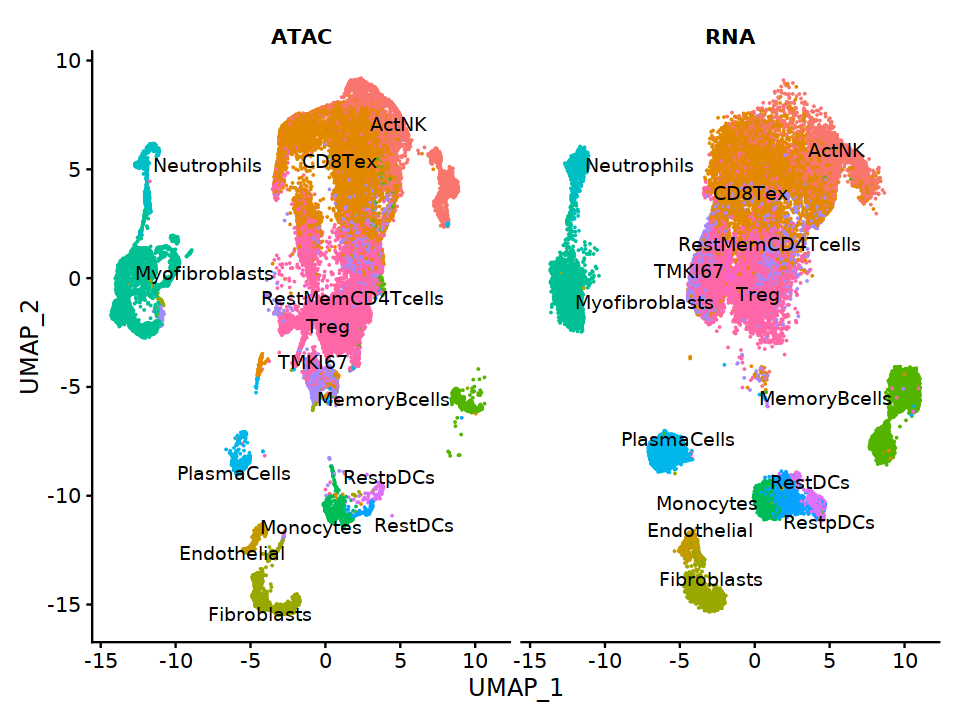

In [55]:
DimPlot(bcc.coembedded.res, split.by = "tech", group.by = "assign.ident", label = TRUE, repel = TRUE) + NoLegend()

In [13]:
bcc.coembedded.res.meta.data <- bcc.coembedded.res@meta.data
rm(bcc.coembedded.res)

In [ ]:
bcc.RNA.res.meta.data <- bcc.RNA.res$RNA@meta.data

In [35]:
bcc.ATAC.res.meta.data <- bcc.result$ATAC@meta.data

In [15]:
rna_bc <- rownames(subset(bcc.coembedded.res.meta.data, assign.ident == "Neutrophils" & tech == "RNA" ))

In [16]:
atac_bc <- rownames(subset(bcc.coembedded.res.meta.data, assign.ident == "Neutrophils" & tech == "ATAC" ))

In [43]:
print(unique(bcc.coembedded.res.meta.data["assign.ident"]))

                                              assign.ident
bcc.su001.pre.tcell_AAACCTGCAGATCGGA                CD8Tex
bcc.su001.pre.tcell_AAACCTGCAGGGATTG      RestMemCD4Tcells
bcc.su001.pre.tcell_AAAGATGAGACAGGCT                  Treg
bcc.su001.pre.tcell_ACGGGCTAGCGTTGCC                TMKI67
bcc.su001.pre.tcell_ACGGGTCAGAGGTTAT                 ActNK
bcc.su001.pre.tumor.cd45_AAAGCAAGTAAGGATT         RestpDCs
bcc.su001.pre.tumor.cd45_AACCGCGTCAAACCAC          RestDCs
bcc.su001.pre.tumor.cd45_ACGATACAGTATCTCG        Monocytes
bcc.su001.pre.tumor.cd45_CTCTAATGTATTCTCT     MemoryBcells
bcc.su001.pre_AAACCTGCATAAGACA              Myofibroblasts
bcc.su001.pre_ACAGCTAAGTGGTAGC                 Endothelial
bcc.su001.pre_ACCCACTTCGTGACAT                 Fibroblasts
bcc.su001.pre_GACAGAGAGTTAACGA                 PlasmaCells
bcc.su002.pre_ACCGTAAAGAGTGACC                 Neutrophils


In [ ]:
bcc.expr[,rna_bc]

In [ ]:
head(bcc.expr)

In [ ]:
bcc.chromvar <- chromVAR_result$ATAC@meta.data[,12:length(chromVAR_result$ATAC@meta.data)]
bcc.clusters.info <- bcc.coembedded.res.meta.data["assign.ident"]
bcc.p.giggle <- p_result$ATAC@meta.data[,12:length(p_result$ATAC@meta.data)]

In [65]:
all_overlap <- intersect(C_G_overlap, rownames(bcc.expr))
bcc.expr.table <- as.matrix(t(bcc.expr[all_overlap,]))
giggle_table <- bcc.p.giggle[,all_overlap]
chromVar_table <- bcc.chromvar[,all_overlap]


cor_table <- data.frame(cluster=c(), cell=c(), type=c(), correlation=c())
for (clu in unique(bcc.clusters.info)$assign.ident){
    message(clu)
    barcode <- rownames(subset(bcc.coembedded.res.meta.data, assign.ident == clu & tech == "RNA" ))
    atac_bc <- rownames(subset(bcc.coembedded.res.meta.data, assign.ident == clu & tech == "ATAC" ))
    message(length(atac_bc))
    cluster_expr <- apply(bcc.expr.table[barcode,],2,mean)
    for (cell in rownames(giggle_table[atac_bc,])){
        chromvar_correlation_value <- cor(cluster_expr, t(chromVar_table[cell,all_overlap]), method = "spearman")
        giggle_correlation_value <- cor(cluster_expr, t(giggle_table[cell,all_overlap]),method = "spearman")
        if (is.na(chromvar_correlation_value) | is.na(giggle_correlation_value)){
            next
        } else {
            cor_table <- rbind(cor_table, data.frame(cluster=c(clu, clu), cell=c(cell, cell), type=c("chromVAR", "GIGGLE"), 
                                                 correlation=c(chromvar_correlation_value, giggle_correlation_value)))
#           cor_table <- rbind(cor_table, data.frame(cluster=clu, factor=tf, type="GIGGLE", correlation=giggle_correlation_value))
        }
    }
}

# cor_table$cluster = factor(cor_table$cluster, levels=c(0:max(unique(glioma.clusters.info)$seurat_clusters))) 

CD8Tex

12098

RestMemCD4Tcells

1452

Treg

11118

TMKI67

46

ActNK

4898

RestpDCs

125

RestDCs

166

Monocytes

571

MemoryBcells

698

Myofibroblasts

3681

Endothelial

534

Fibroblasts

1391

PlasmaCells

385

Neutrophils

655



In [66]:
qsave(cor_table, "BCC_GSE129785/GSE123813/cor_table.qs")

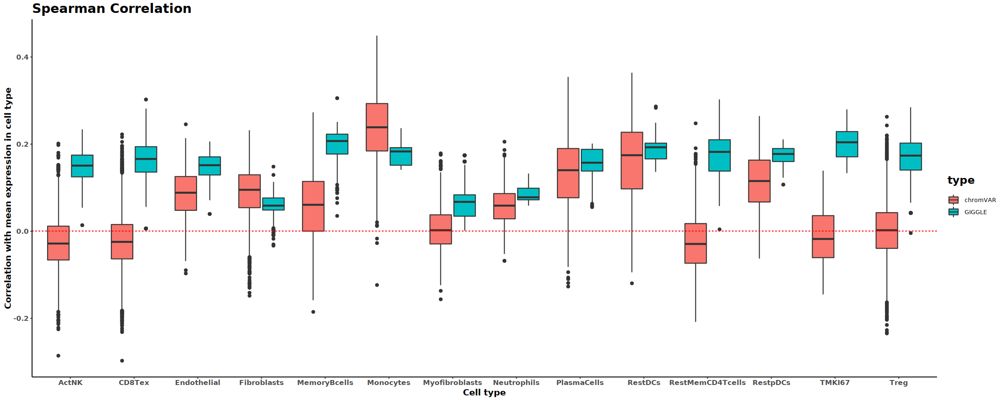

In [72]:
options(repr.plot.width=20, repr.plot.height=8)
ggplot(cor_table, aes(x=cluster, y=correlation, fill=type)) +
geom_boxplot()+
geom_hline(aes(yintercept=0), color = "red", linetype="dashed")+ 
labs(x="Cell type",y="Correlation with mean expression in cell type", title = "Spearman Correlation")+ 
theme_classic(base_size = 10) +
theme(axis.title.x = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5), 
      axis.title.y = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5),
      title = element_text(size = 15, face = "bold", vjust = 2, hjust = 0.5),
      axis.text = element_text(size = 10, face = "bold")
     )

### correlation

In [71]:
"0:CD8Teff", "1:Treg", "2:B", "3:Treg", "4:CD4Tconv", "5:Treg", "6:MonoMac", "7:Malignant", "8:CD8Teff", "9:Plasma",  "10:CAF", "11:CD8Teff", "12:Malignant", "13:pDC", "14:Plasma",  "15:TProliferation", "16:Endothelial", "17:Melanocyte"

geom_abline {ggplot2},R Documentation
mapping,Set of aesthetic mappings created by aes() or aes_().
data,"The data to be displayed in this layer. There are three options: If NULL, the default, the data is inherited from the plot data as specified in the call to ggplot(). A data.frame, or other object, will override the plot data. All objects will be fortified to produce a data frame. See fortify() for which variables will be created. A function will be called with a single argument, the plot data. The return value must be a data.frame, and will be used as the layer data. A function can be created from a formula (e.g. ~ head(.x, 10))."
...,"Other arguments passed on to layer(). These are often aesthetics, used to set an aesthetic to a fixed value, like colour = ""red"" or size = 3. They may also be parameters to the paired geom/stat."
na.rm,"If FALSE, the default, missing values are removed with a warning. If TRUE, missing values are silently removed."
show.legend,"logical. Should this layer be included in the legends? NA, the default, includes if any aesthetics are mapped. FALSE never includes, and TRUE always includes. It can also be a named logical vector to finely select the aesthetics to display."
"xintercept, yintercept, slope, intercept","Parameters that control the position of the line. If these are set, data, mapping and show.legend are overridden."


In [4]:
bcc.coembedded.res <- qread("BCC/integrated/embed.qs")

In [ ]:
bcc.expr <- qread("BCC/RNA/BCC_RNA_GSE123813_expr.qs")

In [4]:
CD8Teff_cells <- rownames(subset(bcc.coembedded.res@meta.data, (assign.ident == "0:CD8Teff"|assign.ident == "8:CD8Teff" | assign.ident == "11:CD8Teff"  ) & tech=="RNA"))
Treg_cells <- rownames(subset(bcc.coembedded.res@meta.data, (assign.ident == "1:Treg"|assign.ident == "3:Treg" | assign.ident == "5:Treg"  ) & tech=="RNA"))
B_cells <- rownames(subset(bcc.coembedded.res@meta.data, (assign.ident == "2:B") & tech=="RNA"))
CD4Tconv_cells <- rownames(subset(bcc.coembedded.res@meta.data, (assign.ident == "4:CD4Tconv") & tech=="RNA"))
MonoMac_cells <- rownames(subset(bcc.coembedded.res@meta.data, (assign.ident ==   "6:MonoMac" ) & tech=="RNA"))
Malignant_cells <- rownames(subset(bcc.coembedded.res@meta.data, (assign.ident == "7:Malignant" |  assign.ident == "12:Malignant") & tech=="RNA"))
Plasma_cells <- rownames(subset(bcc.coembedded.res@meta.data, (assign.ident == "9:Plasma" | assign.ident == "14:Plasma"  ) & tech=="RNA"))
CAF_cells <- rownames(subset(bcc.coembedded.res@meta.data, (assign.ident == "10:CAF" ) & tech=="RNA"))
pDC_cells <- rownames(subset(bcc.coembedded.res@meta.data, (assign.ident == "13:pDC") & tech=="RNA"))
TProliferation_cells <- rownames(subset(bcc.coembedded.res@meta.data, (assign.ident == "15:TProliferation" ) & tech=="RNA"))
Endothelial_cells <- rownames(subset(bcc.coembedded.res@meta.data, (assign.ident == "16:Endothelial" ) & tech=="RNA"))
Melanocyte_cells <- rownames(subset(bcc.coembedded.res@meta.data, (assign.ident == "17:Melanocyte" ) & tech=="RNA"))

In [ ]:
Melanocyte <- apply(bcc.expr[,cells],1, mean)

expre_table = cbind(CD8Teff, Treg, B, CD4Tconv, MonoMac, Malignant, Plasma, CAF, pDC, TProliferation, Endothelial, Melanocyte)

write.table(expre_table,'BCC/RNA/expression.cluster.txt', sep = "\t", quote = FALSE)

In [97]:


expre_table <- read.table('BCC/RNA/expression.cluster.txt', sep = "\t")

In [7]:
expre_table

,CD8Teff,Treg,B,CD4Tconv,MonoMac,Malignant,Plasma,CAF,pDC,TProliferation,Endothelial,Melanocyte
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
FO538757.2,67.4374894,90.4369403,61.9056148,70.6701684,83.9988955,90.9648054,5.23713699,73.0431137,87.9542345,62.9450822,62.5693273,99.6978053
LINC00115,17.2991385,17.3819294,18.6420401,22.0181391,16.6107861,15.1160219,1.17313194,19.9636616,11.2087088,8.5901688,25.8905838,20.7938071
FAM41C,0.5446228,0.7296068,0.6688886,0.8814252,0.3489830,3.0851648,0.01247177,0.6204397,0.6688562,0.6617640,0.4325336,1.1673389
NOC2L,15.0705789,16.4723171,16.3735657,13.4226958,5.4899316,14.1575618,1.65459453,12.5602868,13.9202115,14.4367385,12.4669962,15.6275661
KLHL17,2.5493154,2.8156393,0.9258962,3.0364508,2.1318922,1.2303163,0.28219180,1.4893258,2.5029476,3.0891316,1.1423085,2.2412060
PLEKHN1,0.7848111,1.0150761,0.2686012,0.9306916,0.7173296,1.8210309,0.48319402,1.1332751,0.0000000,0.2211301,0.1542677,0.0000000
HES4,41.9573711,110.8791962,11.7387197,99.7828244,227.8655286,52.2458160,0.16045159,597.5897841,240.9094487,32.4900940,91.3791996,357.5686001
ISG15,60.6811807,59.0027697,34.4327784,34.8576146,72.6452704,7.2826122,2.46193556,83.3559673,50.3485293,67.0677773,43.6404218,54.9710078
C1orf159,0.7788060,1.1207773,0.7812931,0.8909915,0.5044776,1.2485329,0.07633240,0.8936553,0.8340312,1.2402108,0.8320653,1.3982223


In [5]:
CD8Teff_cells <- rownames(subset(bcc.coembedded.res@meta.data, (assign.ident == "0:CD8Teff"|assign.ident == "8:CD8Teff" | assign.ident == "11:CD8Teff"  ) & tech=="ATAC"))
Treg_cells <- rownames(subset(bcc.coembedded.res@meta.data, (assign.ident == "1:Treg"|assign.ident == "3:Treg" | assign.ident == "5:Treg"  ) & tech=="ATAC"))
B_cells <- rownames(subset(bcc.coembedded.res@meta.data, (assign.ident == "2:B") & tech=="ATAC"))
CD4Tconv_cells <- rownames(subset(bcc.coembedded.res@meta.data, (assign.ident == "4:CD4Tconv") & tech=="ATAC"))
MonoMac_cells <- rownames(subset(bcc.coembedded.res@meta.data, (assign.ident ==   "6:MonoMac" ) & tech=="ATAC"))
Malignant_cells <- rownames(subset(bcc.coembedded.res@meta.data, (assign.ident == "7:Malignant" |  assign.ident == "12:Malignant") & tech=="ATAC"))
Plasma_cells <- rownames(subset(bcc.coembedded.res@meta.data, (assign.ident == "9:Plasma" | assign.ident == "14:Plasma"  ) & tech=="ATAC"))
CAF_cells <- rownames(subset(bcc.coembedded.res@meta.data, (assign.ident == "10:CAF" ) & tech=="ATAC"))
pDC_cells <- rownames(subset(bcc.coembedded.res@meta.data, (assign.ident == "13:pDC") & tech=="ATAC"))
TProliferation_cells <- rownames(subset(bcc.coembedded.res@meta.data, (assign.ident == "15:TProliferation" ) & tech=="ATAC"))
Endothelial_cells <- rownames(subset(bcc.coembedded.res@meta.data, (assign.ident == "16:Endothelial" ) & tech=="ATAC"))
Melanocyte_cells <- rownames(subset(bcc.coembedded.res@meta.data, (assign.ident == "17:Melanocyte" ) & tech=="ATAC"))

In [6]:
bcc_chromVAR <- qread("trash/BCC_GSE129785/BCC_GSE129785_run_chromVAR.qs")$z

In [7]:
bcc_script <- t(qread('BCC/SCRIPT_result/per20//ztable.qs'))

In [8]:
ovlp_factor <- intersect(rownames(bcc_script) , rownames(bcc_chromVAR))
ovlp_factor <- intersect(ovlp_factor, rownames(expre_table))

In [133]:
expre_table[ovlp_factor,]

,CD8Teff,Treg,B,CD4Tconv,MonoMac,Malignant,Plasma,CAF,pDC,TProliferation,Endothelial,Melanocyte
AHR,7.176081e-01,1.40765107,2.657785e-01,1.594177e+00,1.65020992,2.67075470,2.121564e-02,2.05640674,1.913731e+00,6.961740e-01,2.136341e+00,1.21861237
AHRR,1.236200e-02,0.11938880,4.050519e-03,3.532268e-02,0.11562172,0.01832224,0.000000e+00,0.37561174,4.807947e-02,1.262004e-01,2.840596e-01,0.22944606
AR,1.099801e-03,0.01194799,4.000895e-03,4.255444e-03,0.01145273,0.04378733,0.000000e+00,0.33333740,1.491806e-01,1.046782e-03,8.967755e-03,0.00000000
ARID2,1.024687e+00,1.45996423,1.030285e+00,1.432889e+00,0.74353367,1.12531543,8.859203e-02,0.80373203,2.199916e+00,9.839051e-01,6.173008e-01,0.87929787
ARID3A,3.687997e-01,0.41080234,6.852777e-01,3.594045e-01,1.59117554,0.90644786,3.584002e-01,0.72982582,9.144818e+00,7.268288e-01,1.761491e-01,0.10806738
ARID5B,4.708833e+00,5.57430205,6.354867e+00,7.039724e+00,1.00051189,10.35456241,4.269697e-01,13.72041883,3.176080e-01,2.383630e+00,7.152477e+00,2.95518843
ARNT,1.032292e+00,1.17960557,8.793803e-01,1.047787e+00,0.85170398,1.00834379,4.310532e-02,1.59241462,1.185460e+00,9.534984e-01,9.095267e-01,1.11944102
ARNT2,0.000000e+00,0.00000000,0.000000e+00,0.000000e+00,0.05542094,0.01421747,0.000000e+00,0.02559466,1.650619e-03,0.000000e+00,0.000000e+00,0.46265502
ARNTL,1.634550e+00,2.87221185,4.756454e-01,2.147464e+00,0.56545532,1.01880611,6.920267e-02,1.01518398,3.431879e-01,1.854012e+00,5.363243e-01,0.38718905
ASCL1,7.920983e-02,0.31980057,1.836246e-01,2.921345e-01,0.00000000,0.97236332,4.675335e-02,0.00000000,0.000000e+00,9.969916e-01,0.000000e+00,0.00000000


In [136]:
bcc_script[ovlp_factor, CD8Teff_cells]

,SU001_Tcell_Post#TGCACCTTCTGGCGCA-1,SU001_Tcell_Post#ACAGCGCTCTATACCT-1,SU001_Tcell_Post#GGTACCGGTACAAATG-1,SU001_Tcell_Post#AGCCCGAAGCAATGTA-1,SU001_Tcell_Post#GAATCTGAGCGTTAGG-1,SU001_Tcell_Post#GCTCACTCAATGCACT-1,SU001_Tcell_Post#GATTAGCCAAGTCTCA-1,SU001_Tcell_Post#CGCGCAACAGTATCTG-1,SU001_Tcell_Post#AGCTGATGTGGACGAT-1,SU001_Tcell_Post#AAAGGGCTCGACCCGA-1,⋯,SU005_Total_Post#TTGTTGTAGTTCCAGT-1,SU005_Total_Post#TGCATGACAAGGGAGG-1,SU005_Total_Post#ACCTGCTCACAGAAGC-1,SU005_Total_Post#GATGATCCACGTTAGT-1,SU005_Total_Post#GTGTGATTCCATGACA-1,SU005_Total_Post#TCACAGATCGCATAAC-1,SU005_Total_Post#TATTGCTGTTCAGTAC-1,SU005_Total_Post#ATAGGCTTCCTCCAGT-1,SU005_Total_Post#AGCTGATTCCTTTGCG-1,SU005_Total_Post#CGCTAGGGTCCTCAGG-1
AHR,-0.1986843,-0.26731445,-0.19272623,-0.16190637,-0.2511834,-0.2747222,-0.29139592,-0.26099529,-0.2796282,-0.1413689,⋯,-1.08087620,-0.39904068,-0.6843313,-0.38136973,-0.71491004,-0.50373855,-0.68886263,-0.7643735,-0.58600376,-0.55165336
AHRR,-0.1986843,-0.28346339,-0.31409126,-0.19605974,-0.2511834,-0.2747222,-0.29139592,-0.26099529,-0.2796282,-0.2826939,⋯,-0.80078727,0.23876175,-0.6843313,-0.38136973,-0.71491004,-0.50373855,-0.68886263,-0.7643735,-0.58600376,-0.55165336
AR,11.2277880,5.32597767,6.48850229,0.56321605,10.4904005,7.5413767,6.64269382,1.09139187,6.8202186,2.6374529,⋯,1.06328787,0.65944128,1.4082786,0.53151365,2.03474076,1.77811087,0.97107563,1.9396542,1.34470818,2.27460825
ARID2,-0.1986843,-0.28346339,-0.31409126,-0.19605974,-0.2511834,-0.2747222,-0.29139592,-0.26099529,-0.2796282,-0.2826939,⋯,0.36627670,-0.39904068,-0.6843313,-0.38136973,-0.71491004,-0.50373855,-0.68886263,-0.7643735,-0.58600376,-0.55165336
ARID3A,-0.1986843,-0.28346339,-0.31409126,-0.19605974,-0.2511834,-0.2747222,-0.29139592,-0.26099529,-0.2796282,-0.2826939,⋯,-1.06683833,1.04050566,2.3797770,0.86011427,2.98217076,2.08371960,2.94816938,1.9492848,0.75188219,2.31157959
ARID5B,-0.1986843,-0.28346339,-0.31409126,-0.19605974,-0.2511834,-0.2747222,-0.29139592,-0.26099529,-0.2796282,-0.2826939,⋯,0.74760411,0.43199931,2.3641957,0.74694262,2.04472654,0.85100226,2.50480572,1.9491377,1.37429740,0.37198658
ARNT,-0.1986843,0.15515449,-0.19300196,-0.19605974,-0.2511834,-0.2747222,-0.29139592,2.22967839,-0.2796282,-0.1098263,⋯,0.14338476,0.11038335,1.0679791,-0.38136973,1.56021321,-0.20270763,1.46252959,1.1440833,0.16224772,-0.29556245
ARNT2,-0.1986843,-0.28346339,-0.31409126,-0.19605974,-0.2511834,-0.2747222,-0.29139592,-0.26099529,-0.2796282,-0.2826939,⋯,-0.71177043,-0.39904068,-0.2308408,-0.38136973,-0.58145195,-0.50373855,-0.32175104,-0.1082757,-0.05862776,-0.55165336
ARNTL,-0.1986843,-0.28346339,-0.31409126,-0.19605974,-0.2511834,-0.2747222,-0.29139592,-0.26099529,-0.2796282,-0.2826939,⋯,0.93870568,1.48054351,-0.1479187,1.52478485,3.17384943,-0.45261083,0.68296370,-0.3327558,-0.49914731,2.04388686
ASCL1,-0.1986843,-0.28346339,-0.31409126,0.08508803,0.6421641,-0.1418057,1.11390510,1.71951297,-0.2796282,0.3324661,⋯,0.99474649,1.32753557,2.3797035,1.71623686,1.10340378,1.99841272,2.64292989,1.6181772,2.61358797,2.02679294


In [9]:
clty_list = list('CD8Teff' = CD8Teff_cells, 
                 'Treg'= Treg_cells, 
                 'B'= B_cells, 
                 'CD4Tconv'= CD4Tconv_cells, 
                 'MonoMac'= MonoMac_cells, 
                 'Malignant'= Malignant_cells, 
                 'Plasma'= Plasma_cells, 
                 'CAF'= CAF_cells, 
                 'pDC'= pDC_cells, 
                 'TProliferation'= TProliferation_cells, 
                 'Endothelial'= Endothelial_cells, 
                 'Melanocyte'= Melanocyte_cells)

In [145]:
clty_list['Plasma']

$Plasma
  [1] "SU001_Tcell_Post#GGATGAGTCCATAACG-1"       
  [2] "SU001_Tcell_Post#ATCCCTGGTCCAGACC-1"       
  [3] "SU001_Tcell_Post#ATTCGTTGTCCAAGTT-1"       
  [4] "SU001_Tcell_Post#GAAGTCTGTGTGAGGT-1"       
  [5] "SU001_Tcell_Post#CCAATGATCCTCAAGA-1"       
  [6] "SU006_Immune_Pre#CACAGATCACCTATTT-1"       
  [7] "SU006_Immune_Pre#CTTGTCGGTAGAATAC-1"       
  [8] "SU006_Immune_Pre#TGGGTTAGTATTGTCG-1"       
  [9] "SU006_Immune_Pre#TAGCGGCAGTATGCTC-1"       
 [10] "SU006_Immune_Pre#GCCAGACGTCAACTGT-1"       
 [11] "SU006_Immune_Pre#CGCTGGAAGTCACACT-1"       
 [12] "SU006_Immune_Pre#TCAGGTAGTACATGGG-1"       
 [13] "SU006_Immune_Pre#CACCTTGTCGAAGCCC-1"       
 [14] "SU006_Immune_Pre#GCCTAGGAGCATTCCA-1"       
 [15] "SU006_Immune_Pre#AACCTTTGTGCGTCCA-1"       
 [16] "SU006_Immune_Pre#CAACGGCAGTGCTCGC-1"       
 [17] "SU006_Tcell_Pre#ACCCAAAGTTTAAGCC-1"        
 [18] "SU006_Tcell_Pre#GTTCAAGGTGTCGGTC-1"        
 [19] "SU006_Tcell_Pre#TTTGAGGGTTGCCTGG-1"        
 [20] "SU006_Total_Post#CTCGCTAGTCCGTCGA-1"       
 [21] "SU006_Total_Post#CTCACCAAGTTCTCCC-1"       
 [22] "SU006_Total_Post#GTTGGTAGTTAAGGGC-1"       
 [23] "SU006_Total_Post#TTAGCTTAGTCGAGCA-1"       
 [24] "SU006_Total_Post#TCACTCGAGAGAAGCA-1"       
 [25] "SU006_Total_Post#ACAGAAATCTTAAGCG-1"       
 [26] "SU006_Total_Post#TTGTTCAGTGCGTAGA-1"       
 [27] "SU006_Total_Post#CACCACTCACTACACA-1"       
 [28] "SU006_Total_Post#GGTGCTGCAATGACTC-1"       
 [29] "SU006_Total_Post#CATTCATCAGATTAAG-1"       
 [30] "SU006_Total_Post#GCTGCGAGTCACTCTC-1"       
 [31] "SU006_Total_Post#GTGATCATCTCGCGTT-1"       
 [32] "SU006_Total_Post#AATGGAACAGGCATCC-1"       
 [33] "SU006_Total_Post#GAGATTCTCCCAGCGA-1"       
 [34] "SU006_Total_Post#TTGCGAAAGGTGATGC-1"       
 [35] "SU006_Total_Post#CATTCCGAGGAGTCTG-1"       
 [36] "SU006_Total_Post#TGCTTCGGTTCTTAGG-1"       
 [37] "SU006_Total_Post#ACTGCGGGTGCATTCA-1"       
 [38] "SU006_Total_Post#GAGCGCTTCTCGTGAA-1"       
 [39] "SU006_Total_Post#ACAATCGAGACTTCCA-1"       
 [40] "SU006_Total_Post#TCTCAGCGTGCTTACA-1"       
 [41] "SU006_Total_Post#TTAGCGACATGCGCTG-1"       
 [42] "SU006_Total_Post#AACAAAGAGTGATTAG-1"       
 [43] "SU006_Total_Post#GCGCCAATCCCACTTG-1"       
 [44] "SU006_Total_Post#AAAGATGCAAGGAACC-1"       
 [45] "SU006_Total_Post#GCTTAAGCATACTGCA-1"       
 [46] "SU006_Total_Post#AGTCAACAGAAACGCC-1"       
 [47] "SU006_Total_Post#CAAGAAAAGTAACACA-1"       
 [48] "SU006_Total_Post#TAGCACAGTTGTGACT-1"       
 [49] "SU006_Total_Post#AACTTGGTCTATCCTA-1"       
 [50] "SU006_Total_Post#AACCAACAGTTATGAG-1"       
 [51] "SU006_Total_Post#ATCCTGCAGGTAGGAA-1"       
 [52] "SU006_Total_Post#TCGGGACCACGTTGTA-1"       
 [53] "SU006_Total_Post#TGCCTCATCAAACCAC-1"       
 [54] "SU006_Total_Post#ACTGTCCTCTTGTGCC-1"       
 [55] "SU006_Total_Post#CAACGGCAGGTTCGAG-1"       
 [56] "SU006_Total_Post#CTCCCAATCTGGGCGT-1"       
 [57] "SU006_Total_Post#CTTAATCCAATGTGCT-1"       
 [58] "SU006_Total_Post#TCACTCGAGAGCTACG-1"       
 [59] "SU006_Total_Post#GTGTGATCAGCGTAGA-1"       
 [60] "SU006_Total_Post#GTAGGAGTCTCTGCAC-1"       
 [61] "SU006_Total_Post#CTTGCCATCGCAGATT-1"       
 [62] "SU006_Total_Post#TATTGCTTCACAGGGA-1"       
 [63] "SU006_Total_Post#TGTGGCGAGGCCAATG-1"       
 [64] "SU006_Total_Post#AGCGTGCCATGGTATC-1"       
 [65] "SU006_Total_Post#TTGTTGTGTCATAAGA-1"       
 [66] "SU006_Total_Post#TACCTCGGTGATAGAT-1"       
 [67] "SU006_Total_Post#ACTTTCATCTATACCT-1"       
 [68] "SU006_Total_Post#TGACTCCCAAAGGAAG-1"       
 [69] "SU006_Total_Post#TATTGCTTCAGAATGA-1"       
 [70] "SU006_Total_Post#TCGAGCGCAAGAGCGT-1"       
 [71] "SU006_Total_Post#ACAGCGCAGTGCTCGC-1"       
 [72] "SU006_Total_Post#CCGAAGCAGAGCGGTT-1"       
 [73] "SU006_Total_Post#TACATTCCATCGTGAT-1"       
 [74] "SU006_Total_Post#GGGTTATGTAGAATAC-1"       
 [75] "SU006_Total_Post#CATAACGCAGAGCCAA-1"       
 [76] "SU006_Total_Post#TTAGGTGCACCCTTTG-1"       
 [77] "SU006_Total_Post#GCCTAGGGTTGGGAAC-1"       
 [78] "SU006_Total_Post#GGGTCTGGTTTCTTAC-1"       
 [79] "SU006_T

In [10]:
options(warn = -1)

In [11]:
cor_table <- data.frame(cell_type=c(), type=c(), correlation_with_expression=c(), correlation_p = c())
for (cell_type in c('CD8Teff', 'Treg', 'B', 'CD4Tconv', 'MonoMac', 'Malignant', 'Plasma', 'CAF', 'pDC', 'TProliferation', 'Endothelial', 'Melanocyte'))
{
    message(cell_type)
    for (bc in clty_list[[cell_type]])
    {
        if (is.na(bcc_script[ovlp_factor,bc][1]) | !(bc %in% colnames(bcc_chromVAR)) | !(bc %in% colnames(bcc_script)))
        {
            next
        }
        chromvar_correlation_value <- cor.test(expre_table[ovlp_factor,cell_type], bcc_chromVAR[ovlp_factor,bc],method = "spearman")
        giggle_correlation_value <- cor.test(expre_table[ovlp_factor,cell_type], bcc_script[ovlp_factor,bc], method = "spearman")
        if (is.na(chromvar_correlation_value$estimate) | is.na(giggle_correlation_value$estimate))
        {
            next
        } 
        else 
        {
            if (is.na(chromvar_correlation_value$p.value > 0.05) | is.na(giggle_correlation_value$p.value > 0.05))
            {
                next
            } 
            else 
            {
            cor_table <- rbind(cor_table, data.frame(cell_type=c(cell_type, cell_type), 
                                                     type=c('chromVAR','SCRIPT'),
                                                     correlation_with_expression=c(chromvar_correlation_value$estimate, giggle_correlation_value$estimate), 
                                                     correlation_p= c(chromvar_correlation_value$p.value, giggle_correlation_value$p.value)))
            }
        }
    }
}
                                                    

CD8Teff

Treg

B

CD4Tconv

MonoMac

Malignant

Plasma

CAF

pDC

TProliferation

Endothelial

Melanocyte



In [31]:
cor_table

[1] TRUE

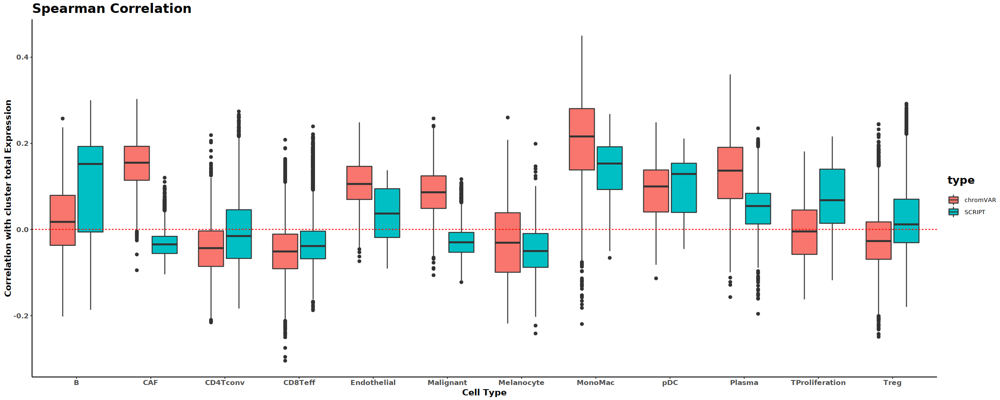

In [12]:
options(repr.plot.width=20, repr.plot.height=8)
ggplot(cor_table, aes(x=cell_type, y=correlation_with_expression, fill=type)) +
geom_boxplot()+
# xlab("Cluster") + 
# ylab("Correlation with RP")+
labs(x="Cell Type",y="Correlation with cluster total Expression", title = "Spearman Correlation ")+ 
geom_hline(aes(yintercept=0), color = "red", linetype="dashed")+ 
theme_classic(base_size = 10) +
theme(axis.title.x = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5), 
      axis.title.y = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5),
      title = element_text(size = 15, face = "bold", vjust = 2, hjust = 0.5),
      axis.text = element_text(size = 10, face = "bold")
     )

------------
------------
------------
# run glioma (GSM4119513)

In [ ]:
glioma_file <- Read10X('/mnt/Storage/home/dongxin/Storage2/Projects/scATAC/Glioma/data/GSM4119513/',gene.column=1)

In [ ]:
glioma.result <- ATACRunSeurat(inputMat = glioma_file, 
                                project = "GSM4119513_Glioma_scATAC", 
                                method = "LSI",
                                min.c = 50,
                                min.p = 500,
                                dims.use = 1:30,
                                cluster.res = 0.6,
                                peaks.test.use = "presto",
                                peaks.cutoff = 1e-05)

In [ ]:
glioma.result.RP <- ATACCalculateGenescore(inputMat = glioma_file)
glioma.result$ATAC <- ATACAttachGenescore(glioma.result$ATAC, glioma.result.RP)
glioma.result$ATAC <- ATACAnnotateCelltype(glioma.result$ATAC, signatures = "human.immune.CIBERSORT", min.score = 0, genes.test.use = "presto", genes.cutoff = 1E-5, orig.ident = NULL)


In [ ]:
saveRDS(glioma.result,"/mnt/Storage/home/dongxin/Storage2/Projects/scATAC/Glioma/GSM4119513/GSM4119513.rds")


In [ ]:
# p <- DimPlot(object = glioma.result$ATAC, pt.size = 0.15, group.by = "active.ident", label = TRUE, label.size = 3, repel = TRUE)

In [ ]:
#  generate background bed
map_list <- list()
step = 50
# key <- "0-1"
path <- "Glioma/GSM4119513/per_50_cell_peak/bg_bed/"
for (i in seq(1,1000)) {
    cl_name <- colnames(glioma_file)
    map_list[[i]] <- cl_name[sample(1:length(cl_name), step)]
    peak_sub <- glioma_file[,map_list[[i]]]
    peak_sub_matrix <- as.matrix(peak_sub[which(rowSums(peak_sub) > 5),])
    peaks <- rownames(peak_sub_matrix)
    peaks <- data.frame(chr=unlist(strsplit(peaks,'_'))[seq(1,length(peaks)*3,3)], 
                    start=as.numeric(unlist(strsplit(peaks,'_'))[seq(2,length(peaks)*3,3)]),
                    end=as.numeric(unlist(strsplit(peaks,'_'))[seq(3,length(peaks)*3,3)]))  
    write.table(peaks, paste0(path, as.character(i), ".bed") ,sep="\t",quote = F, row.names = F, col.names = F)
}
saveRDS(map_list, "Glioma/GSM4119513/per_50_cell_peak/bg_bed/bg_map_list.rds")

In [ ]:
map_list <- list()
step = 50
# key <- "0-1"
path <- "Glioma/GSM4119513/per_50_cell_peak/bed/"
for (i in unique(metadata$seurat_clusters)){
    cluster_cell_name <- rownames(metadata)[metadata$seurat_clusters==i]
    start = seq(1, length(cluster_cell_name), step)
    j = 1
    for (s in start){
        cl_name <- cluster_cell_name[s:(s + step -1)]
        key = paste0(as.character(i), "_", as.character(j))
        message(key)
        map_list[[key]] <- na.omit(cl_name)
        if (length(na.omit(cl_name)) < 20) {
            message(paste(key, "only have", length(na.omit(cl_name)), "cells, skip generate bed file."))
            next
        } else {
            peak_sub <- glioma_file[,map_list[[key]]]
            peak_sub_matrix <- as.matrix(peak_sub[which(rowSums(peak_sub) > 5),])
            peaks <- rownames(peak_sub_matrix)
            peaks <- data.frame(chr=unlist(strsplit(peaks,'_'))[seq(1,length(peaks)*3,3)], 
                            start=as.numeric(unlist(strsplit(peaks,'_'))[seq(2,length(peaks)*3,3)]),
                            end=as.numeric(unlist(strsplit(peaks,'_'))[seq(3,length(peaks)*3,3)]))  
            write.table(peaks, paste0(path, key, ".bed") ,sep="\t",quote = F, row.names = F, col.names = F)
            j <- j+1
        }
    }
}
saveRDS(map_list, "Glioma/GSM4119513/per_50_cell_peak/bed_map_list.rds")

#### run chromVAR


In [ ]:
glioma_chromVAR <- RunchromVAR(glioma_file)

In [ ]:
saveRDS(glioma_chromVAR, "Glioma/GSM4119513/chromVAR_result_more_motif.rds")

In [ ]:
glioma_chromVAR <- readRDS("Glioma/GSM4119513/chromVAR_result_more_motif.rds")

In [ ]:
dev <- glioma_chromVAR$dev
variability <- computeVariability(dev)
plotVariability(variability, use_plotly = T)

In [ ]:
variability[order(variability['variability'], decreasing=T),]

In [ ]:
glioma_chromVAR$zscore

In [ ]:
TFlist <- head(variability[order(variability['variability'], decreasing=T),],10)$name
z_frame <- t(assays(dev)$z)
col_name <- c() 
for (i in lapply(rownames(assays(dev)$z), strsplit, "_")){
    col_name <- c(col_name, i[[1]][3])
}
colnames(z_frame) <- col_name

In [ ]:
TFlist

In [ ]:
z_frame

In [ ]:
options(repr.plot.width=8, repr.plot.height=8)
Glioma_chromVarResult = readRDS("/mnt/Storage/home/dongxin/Storage2/Projects/scATAC/Glioma/GSM4119513/GSM4119513.rds")

p1 <- DimPlot(object = Glioma_chromVarResult$ATAC, pt.size = 0.5)
show(p1)

Glioma_chromVarResult$chromVARz <- z_frame
Glioma_chromVarResult$ATAC@meta.data <- merge(Glioma_chromVarResult$ATAC@meta.data, z_frame, by="row.names", all = TRUE)
rownames(Glioma_chromVarResult$ATAC@meta.data) <- Glioma_chromVarResult$ATAC@meta.data[,1]
for (i in colnames(z_frame)) {
    Glioma_chromVarResult$ATAC@meta.data[i][is.na(Glioma_chromVarResult$ATAC@meta.data[i])] <- min(Glioma_chromVarResult$ATAC@meta.data[i], na.rm=T)
}



In [ ]:
options(repr.plot.width=6, repr.plot.height=6)
for (i in TFlist) {
    fig <- FeaturePlot(object = Glioma_chromVarResult$ATAC, feature=i)
    show(fig)
}

In [ ]:
saveRDS(Glioma_chromVarResult, "Glioma/GSM4119513/GSM4119513_run_chromVAR.rds")

In [ ]:
glioma.result

#### Pvalue calculation

In [ ]:
giggle_table_file <- 'Glioma/GSM4119513/per_50_cell_peak/result_p.txt'
map_list <- readRDS("Glioma/GSM4119513/per_50_cell_peak/bed/map_list.rds")
rds_file <- 'Glioma/GSM4119513/per_50_cell_peak/pvalue.rds'

In [ ]:
giggle <- read.table(giggle_table_file, sep="\t", header = T, row.names="Factor")

In [ ]:
giggle

In [ ]:
bc_start_site <- dim(giggle)[2] + 1 
for (i in names(map_list)){
#     message(i)
    if (length(map_list[i][[1]]) < 20){
        next
    } else {
        for (j in seq(1,length(map_list[i][[1]]))){
#             message(j)
            giggle[,map_list[i][[1]][j]] <- giggle[,paste0('X', i)]
        }
    }    
}

In [ ]:
giggle <- t(giggle[,bc_start_site:dim(giggle)[2]])
giggle <- apply(giggle, 2, p.adjust, "fdr")
giggle <- -log10(giggle+0.00001)

In [ ]:
giggle

In [ ]:
vari <- data.frame(apply(giggle, 2, sd))
TFlist <- head(rownames(vari)[order(vari, decreasing = T)],10)
# TFlist <- c("SPI1", "CEBPA", "CEBPB", TFlist)

In [ ]:
p_result = readRDS('Glioma/GSM4119513/GSM4119513.rds')

p1 <- DimPlot(object = p_result$ATAC, pt.size = 0.5)
show(p1)

p_result$giggle <- giggle
p_result$ATAC@meta.data <- merge(p_result$ATAC@meta.data, giggle, by="row.names", all = TRUE)
rownames(p_result$ATAC@meta.data) <- p_result$ATAC@meta.data[,1]

for (i in colnames(giggle)) {
    p_result$ATAC@meta.data[i][is.na(p_result$ATAC@meta.data[i])] <- max(p_result$ATAC@meta.data[i], na.rm=T)
}

In [ ]:
p_result$giggle

In [ ]:
for (i in TFlist) {
    fig <- FeaturePlot(object = p_result$ATAC, feature=i)
    show(fig)
}

In [ ]:
saveRDS(p_result, rds_file)

In [ ]:
p_result <- readRDS('Glioma/GSM4119513/per_50_cell_peak/pvalue.rds')

#### FC glioma calculation

In [ ]:
giggle_table_file <- 'Glioma/GSM4119513/per_50_cell_peak/result_fc.txt'
map_list <- readRDS("Glioma/GSM4119513/per_50_cell_peak/bed/map_list.rds")
rds_file <- 'Glioma/GSM4119513/per_50_cell_peak/fc.rds'

In [ ]:
giggle <- read.table(giggle_table_file, sep="\t", header = T, row.names="Factor")

In [ ]:
bc_start_site <- dim(giggle)[2] + 1 
for (i in names(map_list)){
#     message(i)
    if (length(map_list[i][[1]]) < 20){
        next
    } else {
        for (j in seq(1,length(map_list[i][[1]]))){
#             message(j)
            giggle[,map_list[i][[1]][j]] <- giggle[,paste0('X', i)]
        }
    }    
}

In [ ]:
giggle <- t(giggle[,bc_start_site:dim(giggle)[2]])
giggle <- log2(giggle)

In [ ]:
vari <- data.frame(apply(giggle, 2, sd))
TFlist <- head(rownames(vari)[order(vari, decreasing = T)],6)
# TFlist <- c("SPI1", "CEBPA", "CEBPB", TFlist)

In [ ]:
fc_result = readRDS('Glioma/GSM4119513/GSM4119513.rds')

p1 <- DimPlot(object = fc_result$ATAC, pt.size = 0.5)
show(p1)

fc_result$giggle <- giggle
fc_result$ATAC@meta.data <- merge(fc_result$ATAC@meta.data, giggle, by="row.names", all = TRUE)
rownames(fc_result$ATAC@meta.data) <- fc_result$ATAC@meta.data[,1]

for (i in colnames(giggle)) {
    fc_result$ATAC@meta.data[i][is.na(fc_result$ATAC@meta.data[i])] <- max(fc_result$ATAC@meta.data[i], na.rm=T)
}



In [ ]:
for (i in TFlist) {
    fig <- FeaturePlot(object = fc_result$ATAC, feature=i)
    show(fig)
}

In [ ]:
saveRDS(fc_result, rds_file)

In [ ]:
fc_result <- readRDS('Glioma/GSM4119513/per_50_cell_peak/fc.rds')

In [ ]:
# fig <- FeaturePlot(object = result$ATAC, feature="ARID3B")
# show(fig)

In [ ]:
chromVAR_result <- readRDS('Glioma/GSM4119513/GSM4119513_run_chromVAR.rds')
p_result <- readRDS('Glioma/GSM4119513/per_50_cell_peak/pvalue.rds')
fdr_result <- readRDS('Glioma/GSM4119513/per_50_cell_peak/fc.rds')

In [ ]:
dev <- glioma_chromVAR$dev
variability <- computeVariability(dev)

In [ ]:
z_frame <- glioma_chromVAR$zscore

In [ ]:
TFlist_chromvar <- head(variability[order(variability['variability'], decreasing=T),]$name, 100)
vari <- data.frame(apply(p_result$giggle, 2, sd))
TFlist_p <- head(rownames(vari)[order(vari, decreasing = T)],100)
# vari <- data.frame(apply(fc_result$giggle, 2, sd))
# TFlist_fc <- head(rownames(vari)[order(vari, decreasing = T)],100)

In [ ]:
chromTFlist <- variability[order(variability['variability'], decreasing=T),]$name

vari <- data.frame(apply(p_result$giggle, 2, sd))
giggle_TFlist <- rownames(vari)[order(vari, decreasing = T)]
G_C_overlap <- intersect(giggle_TFlist,chromTFlist)
C_G_overlap <- intersect(chromTFlist,giggle_TFlist)

In [ ]:
# rownames(variability) <- variability[,"name"]

In [ ]:
zscore_median <- data.frame(apply(z_frame,1,median))
colnames(zscore_median) <- c("chromVAR_zscore_median")
zscore_median[,"name"] <- rownames(zscore_median)

In [ ]:
giggle_p <- data.frame(apply(p_result$giggle,2,median))
colnames(giggle_p) <- c("giggle_p_value")
giggle_p[,"name"] <- rownames(giggle_p)

In [ ]:
giggle_fc <- data.frame(apply(fc_result$giggle,2,median))
colnames(giggle_fc) <- c("giggle_fc_value")
giggle_fc[,"name"] <- rownames(giggle_fc)

In [ ]:
zscore_median

In [ ]:
## p vs z
ov_table <- merge(giggle_p,zscore_median,by = "name")
colnames(ov_table) <- c("name", "giggle_log_adjust_p_value_median", "chromVAR_z_score_median")
ov_table <- as.data.frame(ov_table)

ggplot(ov_table, aes(x = giggle_log_adjust_p_value_median, y = chromVAR_z_score_median)) +
geom_point(color="light blue")+
geom_smooth(method="lm")+
geom_text(aes(y = chromVAR_z_score_median + .07, label = name), check_overlap=T)+
scale_colour_brewer(palette = "Set1")+
xlab("giggle log adjust p value median") + 
ylab("chromVAR z score median")+
theme_classic(base_size = 10) +
theme(axis.title.x = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5), 
      axis.title.y = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5))

In [ ]:
# P vs fc
ov_table <- merge(giggle_p,giggle_fc,by = "name")
colnames(ov_table) <- c("name", "giggle_adjust_p_value_median", "giggle_log_fc_value_median")
ov_table <- as.data.frame(ov_table)

ggplot(ov_table, aes(x = giggle_adjust_p_value_median, y = giggle_log_fc_value_median)) +
geom_point(color="light blue")+
geom_smooth(method="lm")+
geom_text(aes(y = giggle_log_fc_value_median + .07, label = name), check_overlap=T)+
scale_colour_brewer(palette = "Set1")+
xlab("giggle log adjust p value median") + 
ylab("giggle log FC value median")+
theme_classic(base_size = 10) +
theme(axis.title.x = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5), 
      axis.title.y = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5))


In [ ]:
options(repr.plot.width=6, repr.plot.height=6)
for (i in head(C_G_overlap)) {
    fig <- FeaturePlot(object = p_result$ATAC, feature=i)
    show(fig)
    fig <- FeaturePlot(object = chromVAR_result$ATAC, feature=i)
    show(fig)
}

In [ ]:
markerTFlist <- c("STAT4", "TBX21", "FOXP3", "YY1", "FOXO1", "SPI1", "CEBPB", "GATA1")

In [ ]:
for (i in markerTFlist) {
    fig <- FeaturePlot(object = p_result$ATAC, feature=i)
    show(fig)
    fig <- FeaturePlot(object = chromVAR_result$ATAC, feature=i)
    show(fig)
}

In [ ]:
rp

In [ ]:
glioma.rp <- chromVAR_result$ATAC@assays$ACTIVITY@counts
glioma.chromvar <- chromVAR_result$ATAC@meta.data[,12:length(chromVAR_result$ATAC@meta.data)]
glioma.clusters.info <- chromVAR_result$ATAC@meta.data["seurat_clusters"]
glioma.p.giggle <- p_result$ATAC@meta.data[,12:length(p_result$ATAC@meta.data)]

In [ ]:
rp_table <- as.matrix(t(glioma.rp[C_G_overlap,]))
giggle_table <- glioma.p.giggle[,C_G_overlap]
chromVar_table <- glioma.chromvar[,C_G_overlap]

cor_table <- data.frame(cluster=c(), factor=c(), type=c(), correlation=c())
for (clu in unique(glioma.clusters.info)$seurat_clusters){
    barcode <- rownames(glioma.clusters.info)[which(glioma.clusters.info==clu)]
    for (tf in C_G_overlap){
        chromvar_correlation_value <- cor(rp_table[barcode,tf], chromVar_table[barcode,tf],method = "pearson")
        giggle_correlation_value <- cor(rp_table[barcode,tf], giggle_table[barcode,tf],method = "pearson")
        if (is.na(chromvar_correlation_value) | is.na(giggle_correlation_value)){
            next
        } else {
            cor_table <- rbind(cor_table, data.frame(cluster=c(clu, clu), factor=c(tf, tf), type=c("chromVAR", "GIGGLE"), 
                                                 correlation=c(chromvar_correlation_value, giggle_correlation_value)))
#           cor_table <- rbind(cor_table, data.frame(cluster=clu, factor=tf, type="GIGGLE", correlation=giggle_correlation_value))
        }
    }
}

cor_table$cluster = factor(cor_table$cluster, levels=c(0:max(unique(glioma.clusters.info)$seurat_clusters))) 

In [ ]:
options(repr.plot.width=20, repr.plot.height=8)
ggplot(cor_table, aes(x=cluster, y=correlation, fill=type)) +
geom_boxplot()+
xlab("Cluster") + 
ylab("Correlation with RP")+
theme_classic(base_size = 10) +
theme(axis.title.x = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5), 
      axis.title.y = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5))


----------
## compare cell cluster by cell number per cluster

In [ ]:
all_result <- readRDS('10X_ATAC/per_cell_peak/giggle_result_mean.rds')
cell_50_result <- readRDS('10X_ATAC/per_50_cell_peak/giggle_result_mean.rds')
cell_100_result <- readRDS('10X_ATAC/per_100_cell_peak/giggle_result_mean.rds')

In [ ]:
vari <- data.frame(apply(all_result$giggle, 2, sd))
TFlist_all <- head(rownames(vari)[order(vari, decreasing = T)],100)
vari <- data.frame(apply(cell_50_result$giggle, 2, sd))
TFlist_50 <- head(rownames(vari)[order(vari, decreasing = T)],100)
vari <- data.frame(apply(cell_100_result$giggle, 2, sd))
TFlist_100 <- head(rownames(vari)[order(vari, decreasing = T)],100)

In [ ]:
venn(list(TFlist_all, TFlist_50, TFlist_100), sname=c("per cell","per 50 cell","per 100 cell"), 
     ilabels =T, box=F, ilcs=1.5, sncs=1)

In [ ]:
for (i in intersect(TFlist_all, TFlist_50)){
#     message("per cell")
    fig <- FeaturePlot(object = all_result$ATAC, feature=i, label=T)
    show(fig)
#     message("per 50 cell")
    fig <- FeaturePlot(object = cell_50_result$ATAC, feature=i, label=T)
    show(fig)
#     message("per 100 cell")
    fig <- FeaturePlot(object = cell_100_result$ATAC, feature=i, label=T)
    show(fig)
}

-----------
## compare p fdr and chromVar

In [ ]:
chromVAR_result <- readRDS('10X_ATAC/chromVAR_result.rds')
p_result <- readRDS('10X_ATAC/per_50_cell_peak/1k_TF_index/pvalue.rds')
fdr_result <- readRDS('10X_ATAC/per_50_cell_peak/1k_TF_index/fc.rds')

In [ ]:
TFlist_chromvar <- head(variability[order(variability['variability'], decreasing=T),]$name, 100)
vari <- data.frame(apply(p_result$giggle, 2, sd))
TFlist_p <- head(rownames(vari)[order(vari, decreasing = T)],100)
vari <- data.frame(apply(fc_result$giggle, 2, sd))
TFlist_fc <- head(rownames(vari)[order(vari, decreasing = T)],100)

In [ ]:
venn(list(TFlist_chromvar, TFlist_p, TFlist_fc), sname=c("chromVAR top 100","p top 100","fc top 100"), 
     ilabels =T, box=F, ilcs=1.5, sncs=1)

In [ ]:
intersect(TFlist_p, TFlist_fc)

--------------
# run HSC 

In [16]:
peakcount = read.csv(file ='HSC/GSE96772_HSC_peaks_count.txt', sep="\t")

In [18]:
hsc.result <- ATACRunSeurat(inputMat = peakcount , 
                                project = "HSC_scATAC", 
                                method = "LSI",
                                min.c = 50,
                                min.p = 500,
                                dims.use = 1:30,
                                cluster.res = 0.6,
                                peaks.test.use = "presto",
                                peaks.cutoff = 1e-05)

hsc.result.RP <- ATACCalculateGenescore(inputMat = peakcount)
hsc.result$ATAC <- ATACAttachGenescore(hsc.result$ATAC, hsc.result.RP)
hsc.result$ATAC <- ATACAnnotateCelltype(hsc.result$ATAC, signatures = "human.immune.CIBERSORT", min.score = 0, genes.test.use = "presto", genes.cutoff = 1e-5, orig.ident = NULL)

Warning message:
“Feature names cannot have underscores ('_'), replacing with dashes ('-')”
LSI analysis ...

Warning message:
“RunLSI is being moved to Signac. Equivalent functionality can be achieved via the Signac::RunTFIDF and Signac::RunSVD functions; for more information on Signac, please see https://github.com/timoast/Signac”
Warning message:
“RunLSI is being moved to Signac. Equivalent functionality can be achieved via the Signac::RunTFIDF and Signac::RunSVD functions; for more information on Signac, please see https://github.com/timoast/Signac”
Warning message:
“RunLSI is being moved to Signac. Equivalent functionality can be achieved via the Signac::RunTFIDF and Signac::RunSVD functions; for more information on Signac, please see https://github.com/timoast/Signac”
Performing TF-IDF normalization

Running SVD on TF-IDF matrix

Scaling cell embeddings

UMAP analysis ...

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the 

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 2706
Number of edges: 78788

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8725
Number of communities: 14
Elapsed time: 0 seconds


Warning message:
“Using `as.character()` on a quosure is deprecated as of rlang 0.3.0.
Please use `as_label()` or `as_name()` instead.
This warning is displayed once per session.”
Identify cluster specific peaks ...

Warning message:
“Feature names cannot have underscores ('_'), replacing with dashes ('-')”
Centering and scaling data matrix

Identify cluster specific genes based on RP score ...

The following `from` values were not present in `x`: ActDCs, ActMast, ActMemCD4Tcells, ActNK, ActpDCs, CD8Tcells, CD8Tex, Endothelial, Eosinophils, Fibroblasts, MacrophagesM0, MemoryBcells, Myofibroblasts, NaiveCD4Tcells, Neutrophils, PlasmaCells, RestDCs, RestMast, RestMemCD4Tcells, RestNK, RestpDCs, Tfh, TMKI67, Treg



In [19]:
qsave(hsc.result, "HSC/HSC_GSE96772.qs", nthreads = 2)

In [21]:
sc_experiment <- as.SingleCellExperiment(hsc.result$ATAC)
saveRDS(sc_experiment,'HSC/HSC_Single_cell_experiment.rds')

In [36]:
peakcount

,chr1_10025_10629,chr1_11159_11426,chr1_15568_15743,chr1_16178_16291,chr1_21168_21515,chr1_28740_30075,chr1_32516_32755,chr1_38610_38843,chr1_56110_56422,chr1_90274_90412,⋯,chrY_56834258_56834652,chrY_56836744_56836851,chrY_56838881_56839080,chrY_56839359_56839499,chrY_56843803_56843914,chrY_56847143_56847256,chrY_56848827_56848961,chrY_56850334_56850594,chrY_56850755_56851204,chrY_56858909_56859123
BM1077.HSC.Frozen.160105.1,0,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
BM1077.HSC.Frozen.160105.2,0,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
BM1077.HSC.Frozen.160105.3,0,0,0,0,0,2,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
BM1077.HSC.Frozen.160105.4,2,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,1,0
BM1077.HSC.Frozen.160105.5,0,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
BM1077.HSC.Frozen.160105.6,2,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
BM1077.HSC.Frozen.160105.7,0,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
BM1077.HSC.Frozen.160105.8,0,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
BM1077.HSC.Frozen.160105.9,0,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
BM1077.HSC.Frozen.160105.10,0,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0


In [55]:
hsc_chromVAR <- RunchromVAR(peakcount)

Reading File!

Generating col.data!

Generating row.data!



ERROR: Error in all_dims[, 1L]: 量度数目不对


# Run HSC

In [14]:
HSC.Large.peak <- Read10X_h5('/mnt/Storage2/home/dongxin/Projects/scATAC/HSC/data/h5/All_peak_count.h5')

HSC.Large.peak <- HSC.Large.peak[which(Matrix::rowSums(HSC.Large.peak)>50),]

HSC.result <- ATACRunSeurat(inputMat = HSC.Large.peak , 
                                project = "HSC/ATAC/HSC_scATAC", 
                                method = "LSI",
                                min.c = 50,
                                min.p = 500,
                                dims.use = 1:30,
                                cluster.res = 0.6,
                                peaks.test.use = "presto",
                                peaks.cutoff = 1e-05)

HSC.result.RP <- ATACCalculateGenescore(inputMat = HSC.Large.peak)
HSC.result$ATAC <- ATACAttachGenescore(HSC.result$ATAC, HSC.result.RP)
HSC.result$ATAC <- ATACAnnotateCelltype(HSC.result$ATAC, signatures = "human.immune.CIBERSORT", min.score = 0, genes.test.use = "presto", genes.cutoff = 1E-5, orig.ident = NULL)

Warning message:
“Feature names cannot have underscores ('_'), replacing with dashes ('-')”
LSI analysis ...

Warning message:
“RunLSI is being moved to Signac. Equivalent functionality can be achieved via the Signac::RunTFIDF and Signac::RunSVD functions; for more information on Signac, please see https://github.com/timoast/Signac”
Warning message:
“RunLSI is being moved to Signac. Equivalent functionality can be achieved via the Signac::RunTFIDF and Signac::RunSVD functions; for more information on Signac, please see https://github.com/timoast/Signac”
Warning message:
“RunLSI is being moved to Signac. Equivalent functionality can be achieved via the Signac::RunTFIDF and Signac::RunSVD functions; for more information on Signac, please see https://github.com/timoast/Signac”
Performing TF-IDF normalization

Running SVD on TF-IDF matrix

Scaling cell embeddings

UMAP analysis ...

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the 

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 26153
Number of edges: 829469

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9295
Number of communities: 21
Elapsed time: 7 seconds


Warning message:
“Using `as.character()` on a quosure is deprecated as of rlang 0.3.0.
Please use `as_label()` or `as_name()` instead.
This warning is displayed once per session.”
Identify cluster specific peaks ...

Warning message:
“Feature names cannot have underscores ('_'), replacing with dashes ('-')”
Centering and scaling data matrix

Identify cluster specific genes based on RP score ...

The following `from` values were not present in `x`: ActDCs, ActpDCs, CD8Tcells, Endothelial, Eosinophils, Fibroblasts, MacrophagesM0, MacrophagesM1, MacrophagesM2, Monocytes, Myofibroblasts, Neutrophils, PlasmaCells, Tfh, TMKI67, Treg



In [15]:
qsave(HSC.result, "HSC/ATAC/HSC.qs", nthreads = 2)

hsc_singlecell = as.SingleCellExperiment(HSC.result$ATAC)

saveRDS(hsc_singlecell, 'HSC/ATAC/HSC_single_cell_experiment.rds')

HSC_chromVAR <- RunchromVAR(HSC.Large.peak)

---------
## compare giggle with chromVAR

In [ ]:
chromTFlist <- variability[order(variability['variability'], decreasing=T),]$name

vari <- data.frame(apply(p_result$giggle, 2, sd))
giggle_TFlist <- rownames(vari)[order(vari, decreasing = T)]
G_C_overlap <- intersect(giggle_TFlist,chromTFlist)
C_G_overlap <- intersect(chromTFlist,giggle_TFlist)

In [ ]:
# venn.diagram(
#     x = list(giggle_TFlist,chromTFlist),
#     category.names = c("giggle_TFlist" , "chromVAR_TFlist"),
#     filename = 'venn_diagramm.png',
#     output=T,
#     imagetype="png" ,
#     height = 1000 , 
#     width = 1000 , 
#     resolution = 300,
#     compression = "lzw",
#     cat.cex = 0.6,
#     cat.default.pos = "outer",
#     cat.pos = c(-10, 20),
#     cat.dist = c(0.055, 0.055),

# )
venn(list(chromTFlist, giggle_TFlist), sname=c("chromVAR","p derive from giggle"), 
     ilabels =T, box=F, ilcs=1.5, sncs=1)

In [ ]:
print(setdiff(chromTFlist,giggle_TFlist))

In [ ]:
print(setdiff(giggle_TFlist,chromTFlist))

In [ ]:
print(chromTFlist)

In [ ]:
print(C_G_overlap)

In [ ]:
for (i in head(G_C_overlap)) {
    fig <- FeaturePlot(object = p_result$ATAC, feature=i)
    show(fig)
    fig <- FeaturePlot(object = chromVarResult$ATAC, feature=i)
    show(fig)
}

In [ ]:
for (i in head(C_G_overlap)) {
    fig <- FeaturePlot(object = p_result$ATAC, feature=i)
    show(fig)
    fig <- FeaturePlot(object = chromVarResult$ATAC, feature=i)
    show(fig)
}

-----------
# other test part

#### peak number distribution

Warning message:
“Removed 760 rows containing non-finite values (stat_density).”


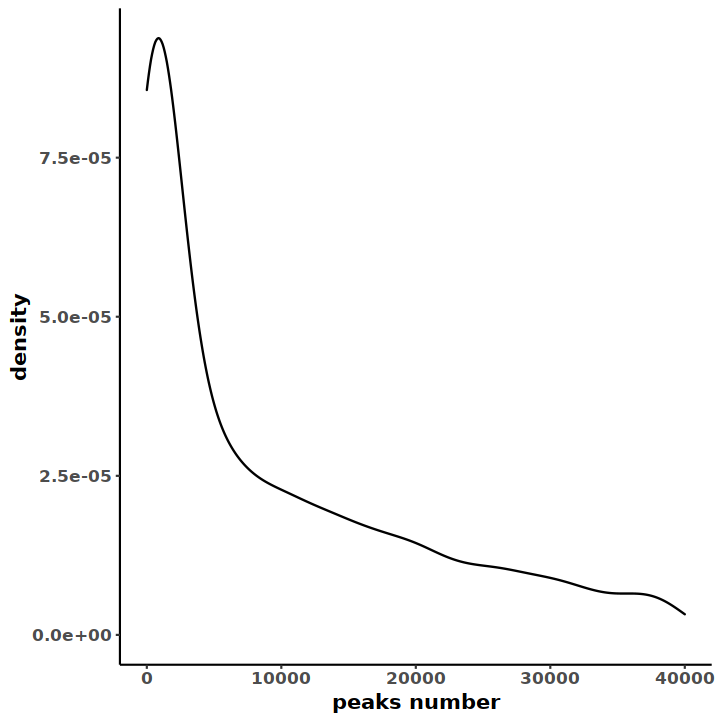

In [72]:
distribution <- read.table("/mnt/Storage/home/dongxin/temp/cistrome/filter_bed/bed_distribution.txt", header = F, sep = " ")

p <- ggplot(distribution, aes(x=V1)) +
geom_density()+
labs(x="peaks number")+
theme_classic(base_size = 10) +
theme(axis.title.x = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5), 
      axis.title.y = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5),
      title = element_text(size = 15, face = "bold", vjust = 2, hjust = 0.5),
      axis.text = element_text(size = 10, face = "bold")
     )+
xlim(0,40000)
p

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.

Warning message:
“Removed 2 rows containing missing values (geom_bar).”


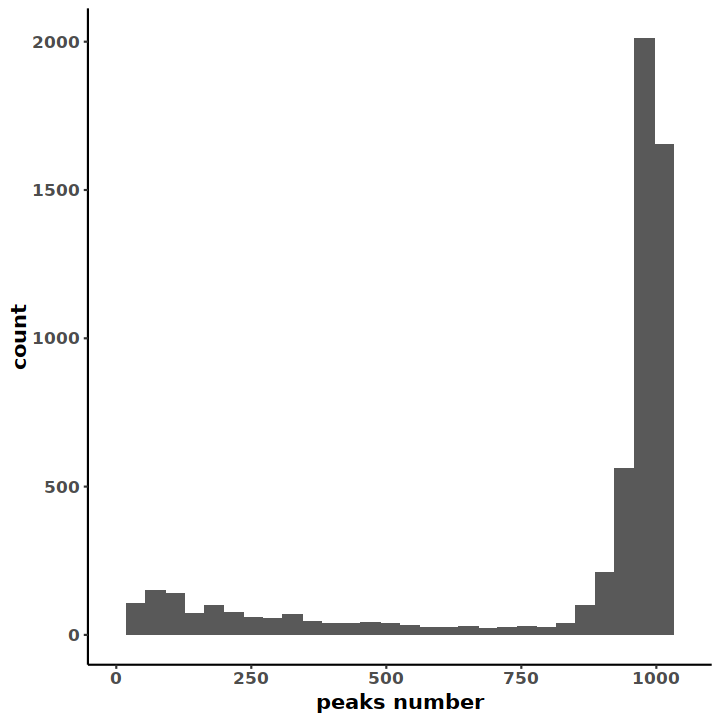

In [80]:
distribution <- read.table("/mnt/Storage/home/dongxin/temp/cistrome/filter_bed/narrowPeak_rename/1kbedDistribution.txt", header = F, sep = " ")

p <- ggplot(distribution, aes(x=V1)) +
geom_histogram()+
labs(x="peaks number")+
theme_classic(base_size = 10) +
theme(axis.title.x = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5), 
      axis.title.y = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5),
      title = element_text(size = 15, face = "bold", vjust = 2, hjust = 0.5),
      axis.text = element_text(size = 10, face = "bold")
     )+
xlim(0,1050)
p

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.



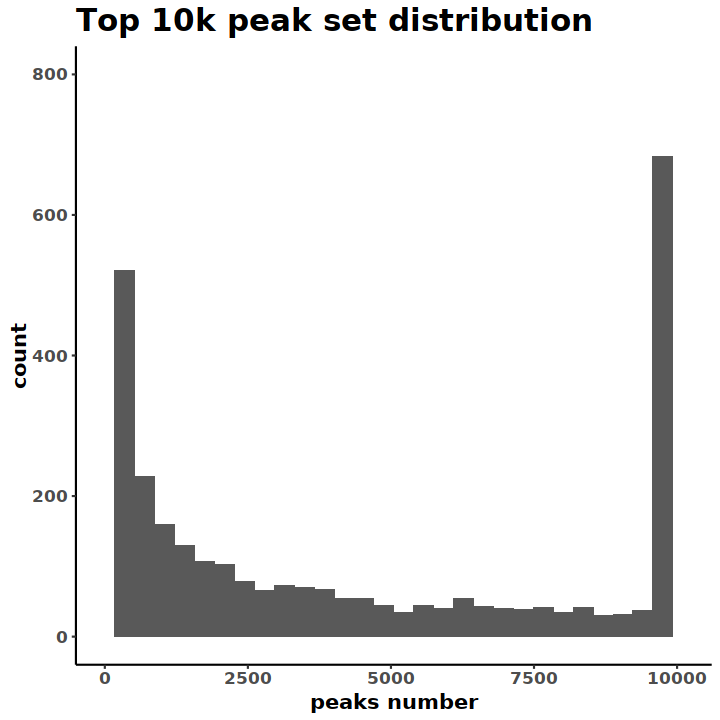

In [107]:
options(repr.plot.width=6, repr.plot.height=6)
distribution <- read.table("/mnt/Storage/home/dongxin/temp/cistrome/filter_bed/narrowPeak_rename/10k_bed_distribution.txt", header = F, sep = " ")

p <- ggplot(distribution, aes(x=V1)) +
geom_histogram()+
labs(x="peaks number", title="Top 10k peak set distribution")+
theme_classic(base_size = 10) +
theme(axis.title.x = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5), 
      axis.title.y = element_text(size = 12, face = "bold", vjust = 0.5, hjust = 0.5),
      title = element_text(size = 15, face = "bold", vjust = 2, hjust = 0.5),
      axis.text = element_text(size = 10, face = "bold")
     )+
xlim(0,10100)+
ylim(0,800)
p

In [108]:
subset_peaknumber <- subset(distribution, V1<10000)

In [ ]:
subset_peaknumber[order(subset_peaknumber$V1, decreasing =F) ,]

In [ ]:
giggle <- read.table(giggle_table_file, sep="\t", header = T, row.names="Factor")

In [ ]:
giggle <- t(giggle)

In [ ]:
bc_start_site <- dim(giggle)[2] + 1 
for (i in names(map_list)){
#     message(i)
    if (length(map_list[i][[1]]) < 20){
        next
    } else {
        for (j in seq(1,length(map_list[i][[1]]))){
#             message(j)
            giggle[,map_list[i][[1]][j]] <- giggle[,paste0('X', i)]
        }
    }    
}

In [ ]:
giggle <- t(giggle[,bc_start_site:dim(giggle)[2]])

In [ ]:
giggle <- -log2(giggle)

In [ ]:
vari <- data.frame(apply(giggle, 2, sd))
TFlist <- head(rownames(vari)[order(vari, decreasing = T)],10)

In [ ]:
TFlist

In [ ]:
result$ATAC@meta.data

In [ ]:
result = readRDS('10X_ATAC/analysis/atac_pbmc_10k_v1_S1_L001//Result//Analysis//atac_pbmc_10k_v1_S1_L001_scATAC_Object.rds')

p1 <- DimPlot(object = result$ATAC, pt.size = 0.5)
show(p1)
result$giggle <- giggle
result$ATAC@meta.data <- merge(result$ATAC@meta.data, giggle, by="row.names", all = TRUE)
rownames(result$ATAC@meta.data) <- result$ATAC@meta.data[,1]

for (i in colnames(giggle)) {
    result$ATAC@meta.data[i][is.na(result$ATAC@meta.data[i])] <- min(result$ATAC@meta.data[i], na.rm=T)
}


for (i in TFlist) {
    fig <- FeaturePlot(object = result$ATAC, feature=i)
    show(fig)
}

In [ ]:
saveRDS(result, rds_file)

--------
## extract cluster peak bed

In [ ]:
result <- readRDS('10X_ATAC/analysis/atac_pbmc_10k_v1_S1_L001//Result//Analysis//atac_pbmc_10k_v1_S1_L001_scATAC_Object.rds')

In [ ]:
cluster_bc <- rownames(result$ATAC@meta.data[result$ATAC@meta.data$seurat_clusters == 9,])

In [ ]:
write.table(cluster_bc, "/mnt/Storage/home/dongxin/Storage2/Projects/scATAC/10X_ATAC/investgate_cluster_peak/cluster9_bc.txt", quote = F, sep="\t", row.names = F, col.names = F)

In [ ]:
# /mnt/Storage2/home/dongxin/Projects/scATAC/10X_ATAC/analysis/atac_pbmc_10k_v1_S1_L001/Result/minimap2/atac_pbmc_10k_v1_S1_L001.sortedByPos.CRadded.bam

In [ ]:
CR:Z:

In [ ]:
writeLines(paste0("| grep -v ", cluster_bc), "/mnt/Storage/home/dongxin/Storage2/Projects/scATAC/10X_ATAC/investgate_cluster_peak/command.sh", sep = " ")

--------


In [ ]:
tsne_results <- deviationsTsne(dev, threshold = 1.5, perplexity = 100)

In [ ]:
for (i in TFlist){
    p <- plotDeviationsTsne(dev, tsne_results, annotation_name = i, sample_column = NULL, shiny = FALSE)
    show(p)
}


In [ ]:
plotDeviationsTsne(dev, tsne_results, annotation_name = 'FOS', sample_column = NULL, shiny = FALSE)

In [ ]:
dev

In [ ]:
inputMat <- Read10X_h5('analysis/GSE132065/GSM4499023/Result/Analysis/GSM4499023_peak_count.h5')

min.c = 50
min.p = 500

In [ ]:
inputMat <- as.matrix(inputMat)
peaks <- data.frame(chr=unlist(strsplit(rownames(inputMat),'_'))[seq(1,nrow(inputMat)*3,3)], 
             start=as.numeric(unlist(strsplit(rownames(inputMat),'_'))[seq(2,nrow(inputMat)*3,3)]),
             end=as.numeric(unlist(strsplit(rownames(inputMat),'_'))[seq(3,nrow(inputMat)*3,3)]))  
rownames(peaks) <- paste0(peaks[,1],'_',peaks[,2],'_',peaks[,3])
colData <- DataFrame(celltype=colnames(inputMat), depth=apply(inputMat,2,sum))
colData <- colData[which(colData[,2]>min.p),]
rowData <- DataFrame(peaks=rownames(inputMat), depth=apply(inputMat[,colData[,1]],1,sum))
rowData <- rowData[which(rowData[,2]>min.c),]
finalPeak <- as.matrix(peaks[rowData[,1],])
finalCount <- as.matrix(inputMat[rowData[,1],colData[,1]])
rowRanges = GRanges(as.character(finalPeak[,1]),IRanges(as.integer(finalPeak[,2]),as.integer(finalPeak[,3])),strand="*",score=as.integer(5),qval=1,name=rownames(finalPeak))



resizedRowRanges <- resize(rowRanges, width=500, fix="center")
chromVAR_counts  = SummarizedExperiment(assays=SimpleList(counts=finalCount),rowRanges=resizedRowRanges, colData=colData)

chromVAR_counts = addGCBias(chromVAR_counts, genome = BSgenome.Hsapiens.UCSC.hg38)
motifs <- getJasparMotifs(species = "Homo sapiens")
motif_ix = matchMotifs(motifs, chromVAR_counts, genome = BSgenome.Hsapiens.UCSC.hg38)

dev = computeDeviations(object = chromVAR_counts, annotations = motif_ix)

In [ ]:
tsne_results <- deviationsTsne(dev, threshold = 1, perplexity = 10)

In [ ]:
tsne_plots <- plotDeviationsTsne(dev, tsne_results, 
                                 annotation_name = "FOXD1", 
                                 sample_column = NULL, 
                                 shiny = FALSE)
tsne_plots

In [ ]:
resize(rowRanges, width=500, fix="center")

In [ ]:
?resize

In [ ]:
GSM4499023_var <- RunchromVAR(inputMat,min.c = 50, min.p = 500, organism = "GRCh38")

In [ ]:
GSM4499023_var$dev

--------------
## ArchR

In [ ]:
library(ArchR)
library(Rsamtools)
# ArchR::installExtraPackages()

In [ ]:
addArchRThreads(threads = 8)
addArchRGenome("hg38")

In [ ]:
# bam_file <- scanBam("10X_ATAC/analysis/atac_pbmc_10k_v1_S1_L001//Result//minimap2//atac_pbmc_10k_v1_S1_L001.sortedByPos.rmdp.CBadded.unique.bam")

In [ ]:
ArrowFiles <- createArrowFiles(
  inputFiles = '10X_ATAC/analysis/atac_pbmc_10k_v1_S1_L001//Result//minimap2//atac_pbmc_10k_v1_S1_L001.sortedByPos.rmdp.CBadded.unique.bam',
  sampleNames = "10x_pbmc",
  filterTSS = 4, #Dont set this too high because you can always increase later
  filterFrags = 1000, 
  minFrags = 1,
  bcTag = 'CB',
  addTileMat = TRUE,
  addGeneScoreMat = TRUE
)

In [ ]:
ArrowFiles

In [ ]:
doubScores <- addDoubletScores(
  input = ArrowFiles,
  k = 10, #Refers to how many cells near a "pseudo-doublet" to count.
  knnMethod = "UMAP", #Refers to the embedding to use for nearest neighbor search.
  LSIMethod = 1
)

In [ ]:
proj <- ArchRProject(
  ArrowFiles = ArrowFiles, 
  outputDirectory = "10x_pbmc",
  copyArrows = TRUE #This is recommened so that you maintain an unaltered copy for later usage.
)

In [ ]:
getAvailableMatrices(proj)

In [ ]:
proj <- filterDoublets(ArchRProj = proj)

In [ ]:
proj <- addIterativeLSI(ArchRProj = proj, useMatrix = "TileMatrix", name = "IterativeLSI")

In [ ]:
proj <- addClusters(input = proj, reducedDims = "IterativeLSI")

In [ ]:
proj <- addUMAP(ArchRProj = proj, reducedDims = "IterativeLSI")

In [ ]:
p2 <- plotEmbedding(ArchRProj = proj, colorBy = "cellColData", name = "Clusters", embedding = "UMAP")

In [ ]:
p2

--------
## maestro and archr results

In [ ]:
maestro_result <- readRDS('10X_ATAC/analysis/atac_pbmc_10k_v1_S1_L001//Result//Analysis//atac_pbmc_10k_v1_S1_L001_scATAC_Object.rds')

In [ ]:
maestro <- cbind(rownames(maestro_result$ATAC@meta.data), maestro_result$ATAC@meta.data[,"seurat_clusters"])

In [ ]:
maestro <- as.data.frame(maestro)

In [ ]:
dim(maestro)

In [ ]:
dim(archr)

In [ ]:
# unlist(strsplit(rownames(proj@cellColData), split='#', fixed=TRUE))[seq(2, length(rownames(proj@cellColData)), 2)]
bc <- str_remove(rownames(proj@cellColData),"10x_pbmc#")

In [ ]:
cl <- str_remove(proj@cellColData[,"Clusters"],"C")

In [ ]:
archr <- cbind(bc, cl)

In [ ]:
maestro[,2]

In [ ]:
statable <- matrix(rep(0,96), nrow = 12, ncol = 8)

In [ ]:
for (i in c(1:12)){
    M_bc <- maestro[,1][which(maestro[,2] == as.character(i))]
    for (j in c(1:8)){
        A_bc <- archr[,1][which(archr[,2] == as.character(j))]
        statable[i,j] <- round(length(intersect(M_bc, A_bc)) / length(M_bc),2)
    }
}
statable <- as.data.frame(statable)
colnames(statable) <- c(paste0("ArchR_",c(1:8)))
rownames(statable) <- c(paste0("MAESTRO_",c(1:12)))

In [ ]:
statable["MAESTRO"] <- rownames(statable)
plot_dat = melt(statable, variable.name = "ArchR")

In [ ]:
ggplot(plot_dat, aes(x = MAESTRO, y = ArchR, fill = value)) +
theme_bw() +
geom_tile() +
scale_fill_gradient(name = "Overlap",
                      low = "#FFFFFF",
                      high = "#FF0000") +
geom_text(aes(label = value))+
theme(axis.text.x=element_text(angle=45, hjust=1, vjust=1))+
coord_fixed(1.5)


------------
## chromVAR example

In [ ]:
peakfile <- system.file("extdata/test_bed.txt", package = "chromVAR")
peaks <- getPeaks(peakfile, sort_peaks = TRUE)
bamfile <- system.file("extdata/test_RG.bam", package = "chromVAR")
fragment_counts <- getCounts(bamfile, 
                             peaks, 
                             paired =  TRUE, 
                             by_rg = TRUE, 
                             format = "bam", 
                             colData = DataFrame(celltype = "GM"))

In [ ]:
data(example_counts, package = "chromVAR")
rowData(example_counts)

In [ ]:
example_counts <- addGCBias(example_counts, 
                            genome = BSgenome.Hsapiens.UCSC.hg19)

In [ ]:
counts_filtered <- filterSamples(example_counts, min_depth = 1500, 
                                 min_in_peaks = 0.15, shiny = FALSE)

In [ ]:
counts_filtered

In [ ]:
motifs <- getJasparMotifs()
motif_ix <- matchMotifs(motifs, example_counts, 
                        genome = BSgenome.Hsapiens.UCSC.hg19)

In [ ]:
bg <- getBackgroundPeaks(object = example_counts)

In [ ]:
dev <- computeDeviations(object = example_counts, annotations = motif_ix)

In [ ]:
variability <- computeVariability(dev)

In [ ]:
plotVariability(variability, use_plotly = T) 

In [ ]:
tsne_results <- deviationsTsne(dev, threshold = 1.5, perplexity = 10)

In [ ]:
tsne_plots <- plotDeviationsTsne(dev, tsne_results, 
                                 annotation_name = "NFIL3", 
                                 sample_column = "Cell_Type", 
                                 shiny = FALSE)

In [ ]:
max(assays(dev)$z[1,])

In [ ]:
max(assays(dev)$dev[1,])

In [ ]:
tsne_plots